In [4]:
cd /work/FAC/FBM/DBC/cdessim2/default/dmoi/projects/snake_tree/notebooks

/work/FAC/FBM/DBC/cdessim2/default/dmoi/projects/snake_tree/notebooks


In [5]:
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
import glob
import os
import numpy as np
import sys
sys.path.append( '../src/')


In [7]:
ls ../src

add_structalns.py              getconsensustree.py
AFDB_tools.py                  grabplddt.py
aggregate_res.py               __init__.py
aln2distmat.py                 load_treesets.py
aln_treemerge.py               make_astral_input.py
calcfident_distributions.py    postprocess_3dcoffee.py
calcfident_foldtree_stats.py   postprocess.py
calcRF.py                      prepare_astral_pro_prune.py
calctreescores.py              prepare_astral_pro.py
clip_core.py                   prepare_protsets_CATH_OMA.py
compile_treeset.py             prepare_protsets_CATH.py
concatenate_trees.py           preprocess_3dcoffee.py
corecut.py                     process_madroot.py
create_iqtree_template.py      __pycache__/
crossalns.py                   read_astral.py
dataprep/                      retrieve_uniref90_homologs.py
dl_sequences_ogs.py            simulate_frames.py
dl_sequences.py                smallpars.py
dl_structs.py                  split_frames.py
foldseek2tree.py               struct

In [8]:
from matplotlib import pyplot as plt
import pandas as pd
import seaborn as sns
from compile_treeset import compile_folder , compare_treesets
import plotly.express as px
import plotly.figure_factory as ff
import plotly.express as px
from scipy.stats import wilcoxon, ks_2samp , describe


In [9]:
#function to plot the proportion of highest scoring trees by method
#iterate over all the methods and create a pie chart

def autopct_func(pct):
    return ('%1.1f%%' % pct) if pct >= 5 else ''

def fileter_txt( txt , filterlist = [ '_norm' , '_raw' , '_struct' , '.fst' , '.rooted' , '_tree' , '.final' , '.nwk' , '.rooted' , '.fst' , '.final' , '.nx' , '.treefile'] ):
    for string in filterlist:
        txt = txt.replace( string , '' )
    return txt

def plot_piechart(df , title = 'Proportion of highest scoring trees by method'):
    #return the max score for each method
    #return the index of the max score for each method
    # Identifying the column with the maximum value in each row
    
    df = df.dropna()
    print( len(df) )
    max_cols = df.idxmax(axis=1)
    # Counting occurrences where each column has the maximum value
    max_count = max_cols.value_counts()

    custom_labels = [fileter_txt(label) if count/df.shape[0] * 100 >= 5 else '' for label, count in zip(max_count.index, max_count)]
    
    # Plotting the data as a pie chart
    plt.figure(figsize=(5, 5))
    plt.pie(max_count, labels=custom_labels, autopct=autopct_func, startangle=90)
    plt.title(title)
    plt.show()


In [10]:

def ret_winner(r, score1 , score2):
    if r[score1] < r[score2]:
        return 'Struct better'
    if r[score1] > r[score2]:
        return 'Seq better'
    if r[score1] == r[score2]:
        return 'Equal'

def retstats(df , s1 ,s2):
    df = df[[s1,s2]].dropna()
    #ks test
    w_statistic, w_p_value = wilcoxon(df[s1], df[s2])
    print(f"Wilcoxon Test Statistic: {w_statistic}, P-value: {w_p_value}")
    # Kolmogorov-Smirnov Test
    ks_statistic, ks_p_value = ks_2samp(df[s1], df[s2])
    print(f"Kolmogorov-Smirnov Test Statistic: {ks_statistic}, P-value: {ks_p_value}")

    print('Treescore delta statistics')
    print( describe(df[s1]-df[s2] )  )
    print('total tcs diff' , np.sum(df[s1]-df[s2] ))

    return w_statistic, w_p_value
    

def retgraph(s1,s2 , filtereddf , xlabel , ylabel, title , cutoff = 0 , axlim = 370 , min_axlim = 1):
    sns.set_style("whitegrid")
    palette = { 'Struct better' : 'blue'  , 'Seq better' : 'red' , 'Equal' : 'green'}
    markers= {'markers' : {  'Struct better' : 'o'  , 'Seq better' : 'x' , 'Equal' : 'D'}}
    plt.rcParams['figure.dpi'] = 300

    if cutoff> 0 :
        filtereddf = filtereddf[  filtereddf[s1] > cutoff ]
        filtereddf = filtereddf[  filtereddf[s2] > cutoff ]
    filtereddf['structure better'] = filtereddf.apply( ret_winner , args = ( s1,  s2) , axis = 1)
    w_statistic, w_p_value = retstats(filtereddf , s1, s2 )

    
    
    
    # Count the occurrences of each item
    category_counts = dict(filtereddf['structure better'].value_counts())
    ax = sns.scatterplot( data =filtereddf ,  x=s1 , y=s2 
    , hue = 'structure better'  , alpha = .15 , palette=palette  , s=10 )

    
    ax.set_box_aspect(1)
    totalpts = sum( [ category_counts[x] for x in category_counts] )
    handles, labels = ax.get_legend_handles_labels()
    print(handles,labels)

    for i, label in enumerate(labels):
        count = category_counts[label]
        labels[i] = f"{label} ({count} , {100*count/totalpts:.1f}%)"
    
    ax.legend(handles=handles, labels=labels ,fontsize='medium')    
    # Update the legend labels with the count information
    #ax.legend(loc='upper left')
    
    ax.text(0.9*axlim, 0.1*axlim, f"pval: {w_p_value:.3f}%" , size=10,
         ha="center", va="center",
         bbox=dict(boxstyle="round" )
         )
    ax.set_title(title ,fontsize=20)
    ax.set_ylabel(ylabel ,fontsize=17)
    ax.set_xlabel(xlabel ,fontsize=17)
    
    plt.plot([0,axlim] ,[0,axlim]  , alpha = .25)
    ax.set_ylim(min_axlim, axlim)
    ax.set_xlim(min_axlim, axlim)
    
    plt.savefig('../figures/'+title.replace(' ', '_')+'.svg')
    plt.show()

    

def retgraph_plotly(s1,s2 , filtereddf , xlabel , ylabel, title):
    sns.set_style("whitegrid")
    palette = { 'Struct better' : 'blue'  , 'Seq better' : 'red' , 'Equal' : 'green'}
    markers= {'markers' : {  'Struct better' : 'o'  , 'Seq better' : 'x' , 'Equal' : 'D'}}
    plt.rcParams['figure.dpi'] = 300
    filtereddf['structure better'] = filtereddf.apply( ret_winner , args = ( s1,  s2) , axis = 1)
    filtereddf['fam'] = filtereddf.index
    # Count the occurrences of each item
    category_counts = dict(filtereddf['structure better'].value_counts())
    fig = px.scatter(filtereddf, x=s1, y=s2, color='structure better', hover_data=['fam'])
    fig.show()



In [11]:

def plot_dual_colormap_heatmap(matrix1, matrix2, labels=None, cmap1='Blues', cmap2='Reds'):
    """
    Plot a heatmap with matrix1 in the upper triangular part using cmap1 and 
    matrix2 in the lower triangular part using cmap2.
    
    Args:
    - matrix1 (np.array): Square matrix for the upper triangular part.
    - matrix2 (np.array): Square matrix for the lower triangular part.
    - labels (list of str): Labels for the axes; defaults to indices if None.
    - cmap1 (str): Color map for the upper triangular heatmap.
    - cmap2 (str): Color map for the lower triangular heatmap.
    """
    if matrix1.shape != matrix2.shape:
        raise ValueError("Both matrices must have the same dimensions.")
    
    # Generate a full-size combined matrix for easier plotting
    combined_matrix = np.zeros_like(matrix1, dtype=float)
    mask_upper = np.triu(np.ones_like(matrix1, dtype=bool), k=1)  # Upper triangular mask
    mask_lower = np.tril(np.ones_like(matrix2, dtype=bool), k=0)  # Lower triangular mask + diagonal

    # Apply masks to matrices
    combined_matrix[mask_upper] = matrix1[mask_upper]
    combined_matrix[mask_lower] = matrix2[mask_lower]

    fig, ax = plt.subplots(figsize=(10, 8))
    
    # Plotting the upper triangular matrix
    sns.heatmap(combined_matrix, mask=np.invert(mask_upper), cmap=cmap2, cbar=False, ax=ax,
                annot=True, fmt=".2f", xticklabels=labels, yticklabels=labels, square=True)
    
    # Overlaying the lower triangular matrix
    sns.heatmap(combined_matrix, mask=np.invert(mask_lower), cmap=cmap1, cbar=False, ax=ax,
                annot=True, fmt=".2f", xticklabels=labels, yticklabels=labels, square=True)

    plt.title("Combined Heatmap with Dual Color Maps")
    plt.show()




In [12]:
def compile_results(cladefolders , plotall = False, scorefunc = 'root_score'):
    rescols = ['lddt_1_raw_struct_tree' , 'fident_1_raw_struct_tree', 'alntmscore_1_raw_struct_tree', 'sequences' , 'sequences.aln.fst.treefile.rooted']
    rescols_norm = ['lddt_1_raw_struct_tree'+'_norm' , 'fident_1_raw_struct_tree'+'_norm', 'alntmscore_1_raw_struct_tree'+'_norm' , 'sequences'+'_norm' , 'sequences.aln.fst.treefile.rooted']
    dfs = []
    plotall = False
    for folder in cladefolders:
        #try:
        if 'logs' not in folder:
            print(folder)
            res = compile_folder(folder, scorefunc = scorefunc, verbose = True)
            if res :
                tree_resdf , refcols = res
                compare_treesets(tree_resdf  , colfilter= 'sequence' , display_lineplot = False , verbose = True)
                tree_resdf['folder'] = folder

                #add filtered bool column
                tree_resdf['filtered'] = tree_resdf['folder'].apply(lambda x : 'unfiltered' not in x)

                if 'OMA' in folder:
                    dfs.append(tree_resdf)
                    if plotall == True:
                        graph_treedf(tree_resdf , rescols, rescols_norm)
                else:
                    dfs.append(tree_resdf)
    total_df = pd.concat(dfs)
    try:
        if 'OMA' in folder:
            graph_treedf(total_df[total_df.filtered == False] , rescols, rescols_norm , prefix = 'OMA' )
            graph_treedf(total_df[total_df.filtered == True] , rescols, rescols_norm , prefix = 'OMA' )
    except:
        print('graphing err' )
    return total_df

In [13]:
"""
#cladefolders = [ '../CAT_mk3/']# , '../SCOP_data/' ]
cladefolders = [ '/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CAT_data_mk4_genus/']# , '../SCOP_data/' ]

catdf = compile_results(cladefolders, scorefunc = 'root_score_nr' )
catdf_ntcs = compile_results(cladefolders, scorefunc = 'score' )
"""

"\n#cladefolders = [ '../CAT_mk3/']# , '../SCOP_data/' ]\ncladefolders = [ '/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CAT_data_mk4_genus/']# , '../SCOP_data/' ]\n\ncatdf = compile_results(cladefolders, scorefunc = 'root_score_nr' )\ncatdf_ntcs = compile_results(cladefolders, scorefunc = 'score' )\n"

In [14]:
#cladefolders = [ '../CATH_mk3/']# , '../SCOP_data/' ]
"""
cladefolders = [ '/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CATH_data_mk4_genus/']
cathdf_root = compile_results(cladefolders, scorefunc = 'root_score_nr' )
cathdf_ntcs = compile_results(cladefolders, scorefunc = 'score' )
"""

"\ncladefolders = [ '/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CATH_data_mk4_genus/']\ncathdf_root = compile_results(cladefolders, scorefunc = 'root_score_nr' )\ncathdf_ntcs = compile_results(cladefolders, scorefunc = 'score' )\n"

In [15]:
"""

cladefolders = set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' )) - set([ '../OMA_data_unfiltered/OMA_data/logs/' ]) 
OMADF = compile_results(cladefolders, scorefunc = 'root_score_nr' )
OMADF_ntcs = compile_results(cladefolders, scorefunc = 'score' )
"""

"\n\ncladefolders = set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' )) - set([ '../OMA_data_unfiltered/OMA_data/logs/' ]) \nOMADF = compile_results(cladefolders, scorefunc = 'root_score_nr' )\nOMADF_ntcs = compile_results(cladefolders, scorefunc = 'score' )\n"

In [16]:
#save cat , cath and omadf
"""
catdf.to_pickle('catdf.pkl')
catdf_ntcs.to_pickle('catdf_ntcs.pkl')
"""

"\ncatdf.to_pickle('catdf.pkl')\ncatdf_ntcs.to_pickle('catdf_ntcs.pkl')\n"

In [17]:
"""
cathdf_root.to_pickle('cathdf.pkl')
cathdf_ntcs.to_pickle('cathdf_ntcs.pkl')
"""

"\ncathdf_root.to_pickle('cathdf.pkl')\ncathdf_ntcs.to_pickle('cathdf_ntcs.pkl')\n"

In [18]:
"""
OMADF.to_pickle('omadfmk2.pkl')
OMADF_ntcs.to_pickle('omadfmk2_ntcs.pkl')
"""

"\nOMADF.to_pickle('omadfmk2.pkl')\nOMADF_ntcs.to_pickle('omadfmk2_ntcs.pkl')\n"

In [19]:
catdf = pd.read_pickle('catdf.pkl')
cathdf= pd.read_pickle('cathdf.pkl')
OMADF = pd.read_pickle('omadfmk2.pkl')

In [20]:
catdf_ntcs = pd.read_pickle('catdf_ntcs.pkl')
cathdf_ntcs = pd.read_pickle('cathdf_ntcs.pkl')
OMADF_ntcs = pd.read_pickle('omadfmk2_ntcs.pkl')

In [21]:
#OMADF_ntcs = OMADF_ntcs.drop( [ 'sequences' , 'sequences_norm'  , 'sequences.aln.fst.treefile.rooted' , 'sequences.aln.fst.treefile.rooted_norm' , 'sequences.aln.muscle.fst.nwk.rooted'] , axis = 1 )
print(OMADF_ntcs.columns)
print()

Index(['alntmscore_0_raw_struct_tree', 'alntmscore_0_exp_struct_tree',
       'alntmscore_1_exp_struct_tree', 'fident_0_raw_struct_tree',
       'lddt_0_exp_struct_tree', 'lddt_1_exp_struct_tree',
       'fident_0_exp_struct_tree', 'lddt_1_raw_struct_tree',
       'fident_1_raw_struct_tree', 'fident_1_exp_struct_tree',
       'alntmscore_1_raw_struct_tree', 'lddt_0_raw_struct_tree',
       'sequences.aln.muscle.fst.treefile.rooted', '3di_xaln_tree',
       'alnAA_3di.fasta.treefile.rooted.final', 'AA_xaln_tree',
       'templateX3di.nx.treefile.rooted.final',
       'templateXfoldtree.nx.treefile.rooted.final',
       'templateXAA.nx.treefile.rooted.final', 'nseqs',
       'alntmscore_0_raw_struct_tree_norm',
       'alntmscore_0_exp_struct_tree_norm',
       'alntmscore_1_exp_struct_tree_norm', 'fident_0_raw_struct_tree_norm',
       'lddt_0_exp_struct_tree_norm', 'lddt_1_exp_struct_tree_norm',
       'fident_0_exp_struct_tree_norm', 'lddt_1_raw_struct_tree_norm',
       'fident_1_raw

In [22]:
OMADF = OMADF[OMADF.filtered == False]
print(len(OMADF))

4593


In [23]:
unfiltereddf = OMADF
unfiltereddf_ntcs = OMADF_ntcs

In [24]:

normalized = unfiltereddf[ [c for c in unfiltereddf.columns if '_norm' in c and '_raw'  not in c and '_0' not in c  and 'foldtree' not in c ]]
normalized = normalized.drop( [  'sequences.aln.muscle.fst.nwk.rooted_norm'], axis = 1) 

normalized_ntcs = unfiltereddf_ntcs[ [c for c in unfiltereddf_ntcs.columns if '_norm' in c and '_raw'  not in c and '_0' not in c  and 'foldtree' not in c]]
normalized_ntcs = normalized_ntcs.drop( [ 'sequences.aln.muscle.fst.nwk.rooted_norm' ], axis = 1)


In [25]:
cathnormalized = cathdf[ [c for c in cathdf.columns if '_norm' in c and '_raw' not in c and '_0' not in c ]]
cathnormalized = cathnormalized.drop( [ 'sequences.aln.muscle.fst.nwk.rooted_norm' ], axis = 1) 


cathnormalized_ntcs = cathdf_ntcs[ [c for c in cathdf_ntcs.columns if '_norm' in c and '_raw' not in c and '_0' not in c ]]
cathnormalized_ntcs = cathnormalized_ntcs.drop( [ 'sequences.aln.muscle.fst.nwk.rooted_norm' ], axis = 1) 



In [26]:
def get_max_subset(df , subsets  ):
    for subset in subsets:
        df[subset] =  df[subsets[subset]].max( axis = 1)
    return df[subsets.keys()]
    
def group_methods(df):
    struct_vs_seq = {
    'struct': [
    'fident_1_exp_struct_tree_norm',
    'alnAA_3di.fasta.treefile.rooted.final_norm',    
    'alntmscore_1_exp_struct_tree_norm',              
    'templateX3di.nx.treefile.rooted.final_norm',      
    '3di_xaln_tree_norm',                               
    'lddt_1_exp_struct_tree_norm',                      
    'templateXAA.nx.treefile.rooted.final_norm'        
    ] , 
    'seq':[
    
    'AA_xaln_tree_norm',                                
    'sequences.aln.muscle.fst.treefile.rooted_norm'  
    ] }
    
    dist_vs_ml = {
        
    'dist': [ 'fident_1_exp_struct_tree_norm',
    'alntmscore_1_exp_struct_tree_norm',              
    '3di_xaln_tree_norm',                               
    'lddt_1_exp_struct_tree_norm',                      
    ] , 
    
    'ML':[
        'alnAA_3di.fasta.treefile.rooted.final_norm',    
        'templateX3di.nx.treefile.rooted.final_norm',      
        'templateXAA.nx.treefile.rooted.final_norm',
        'sequences.aln.muscle.fst.treefile.rooted_norm'  

    ] }
    
    
    structvsdf = get_max_subset(df , struct_vs_seq  )
    distvsdf = get_max_subset(df , dist_vs_ml  )
    maxpercents = []
    #get percent max vals
    for i,subset in enumerate([ df, structvsdf , distvsdf ]):
       
        # Find the category with the maximum value in each row
        max_categories = subset.idxmax(axis=1)
        # Calculate the percentage of each category being the maximum in the rows
        category_counts = max_categories.value_counts(normalize=True) * 100
        category_counts = category_counts.sort_values( axis = 0)
        maxpercents.append( category_counts )
    return maxpercents


In [27]:
maxpercents_root = group_methods(cathnormalized)
maxpercents_tcs = group_methods(cathnormalized_ntcs)
print(maxpercents_root[0])
print(maxpercents_root[1])
print(maxpercents_root[2])

3di_xaln_tree_norm                                5.942623
alnAA_3di.fasta.treefile.rooted.final_norm        6.147541
alntmscore_1_exp_struct_tree_norm                 7.786885
templateX3di.nx.treefile.rooted.final_norm        9.836066
AA_xaln_tree_norm                                10.450820
sequences.aln.muscle.fst.treefile.rooted_norm    11.065574
lddt_1_exp_struct_tree_norm                      12.295082
templateXAA.nx.treefile.rooted.final_norm        15.778689
fident_1_exp_struct_tree_norm                    20.696721
Name: proportion, dtype: float64
seq       19.262295
struct    80.737705
Name: proportion, dtype: float64
ML      47.95082
dist    52.04918
Name: proportion, dtype: float64


In [28]:
import matplotlib.cm as cm

def stacked_barplot(dfs ,  cscheme = None , title = ''):
    # Sample data
    categories = ['methods', 'ML vs Dist', 'struct vs seq']
    # Create the plot
    fig, ax = plt.subplots()
    # The width of the bars
    bar_width = 0.75
    
    # Generate the bar positions
    index = np.arange(len(categories))
    # Initialize the bottoms array
    bottoms = np.zeros(len(categories))
    # Plot each subcategory

    xtick= []
    cmaps = [ 'jet' , 'Set1' , 'Set2']
    for i,df in enumerate(dfs):
        bottom = 0
        
        cmap = cm.get_cmap(cmaps[i], len(df))
        
        for j in range(len(df.index)):
            color = cmap(j)
            ax.bar(i, df.iloc[j], bar_width, label=df.index[j], bottom=bottom , color = cscheme[df.index[j]])
            bottom += df.iloc[j]
        xtick.append(i)

        
    # Remove the black lines around the plot
    for spine in ax.spines.values():
        spine.set_visible(False)


    print(xtick)
    ax.set_xticks(xtick)
    ax.set_xticklabels(categories)

    # Add some labels and title
    ax.set_xlabel('Categories')
    ax.set_ylabel('Percentage of top scoring trees')
    ax.set_title('Breakdown of top scoring trees')
    ax.set_xticks(index)
    ax.set_title(title)
    ax.tick_params(axis='y', labelsize=18)

    plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

    ax.legend(title='Subcategories', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust layout to make room for the legend
    plt.tight_layout(rect=[0, 0, 0.85, 1])
    # Show the plot
    plt.show()

In [29]:

def stacked_barplot_2(dfs ,  cscheme = None , title = '' , order = None , nsamples = 500):
    # Sample data
    categories = ['methods', 'ML vs Dist', 'struct vs seq']
     
    # Create the plot
    fig, axes = plt.subplots(1,2 , figsize = (20,10))
    # The width of the bars
    bar_width = 0.75
    # Generate the bar positions
    index = np.arange(len(categories))
    # Initialize the bottoms array
    bottoms = np.zeros(len(categories))
    # Plot each subcategory

    xtick1= []
    xtick2= []
    
    cmaps = [ 'jet' , 'Set1' , 'Set2']
    
    for i,df in enumerate(dfs):
        
        df=df[ order[i] ]
        cmap = cm.get_cmap(cmaps[i], len(df))

        if i ==0:
            
            proportions = df / df.sum()
            samples = np.random.multinomial(nsamples, proportions, size=nsamples)
            sample_proportions = samples / nsamples
            std_devs = 100* np.std(sample_proportions, axis=0)
            bottom = 0
            for j in range(len(df.index)):
                color = cmap(j)
                axes[i].bar(j, df.iloc[j], bar_width, label=df.index[j], bottom=0 , color = cscheme[df.index[j]] , yerr=std_devs[j] ,  capsize=5) 
                xtick1.append(df.index[j])

        else:
            bottom = 0
            
            for j in range(len(df.index)):
                color = cmap(j)
                axes[1].bar( (i-1), df.iloc[j], .25, label=df.index[j], bottom=bottom , color = cscheme[df.index[j]])
                bottom += df.iloc[j]
            xtick2.append(i-1)


    axes[0].set_xticks(np.arange(len(xtick1)))
    axes[0].set_xticklabels(xtick1)
    axes[1].set_xticks(xtick2)
    axes[1].set_xticklabels(['Struct vs Seq' ,'ML vs Dist'  ])
    
    # Remove the black lines around the plot
    for i in range(len(axes)):
        for spine in axes[i].spines.values():
            spine.set_visible(False)
            plt.setp(axes[i].get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

    axes[0].set_title(title , size = 20 )
    axes[0].set_ylim(0, 40)
    axes[0].set_ylabel( 'Percentage of total highest scoring trees' , size = 17)

    axes[1].set_ylim(0, 100)
    axes[1].set_ylabel( 'Percentage of total highest scoring trees', size = 17)

    axes[1].set_title( 'Tree method type and Structure')

    axes[1].legend(title='Subcategories', bbox_to_anchor=(1.05, 1), loc='upper left')
    axes[1].tick_params(axis='y', labelsize=18)
    axes[0].tick_params(axis='y', labelsize=18)
    
    # Add vertical grid lines

    # Add vertical grid lines
    axes[1].yaxis.grid(False)
    axes[1].xaxis.grid(False)
    
    axes[0].yaxis.grid(False)
    axes[0].xaxis.grid(False)
    
    # Adjust layout to make room for the legend
    plt.tight_layout(rect=[0, 0, 0.85, 1])
    # Show the plot
    fig.savefig('../figures/stacked/'+title+'.svg')
    plt.show()
    

In [30]:
if not os.path.exists('../figures/stacked/'):
    os.mkdir('../figures/stacked/')


/tmp/47872125/ipykernel_1516033/1006184041.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))


{'alnAA_3di.fasta.treefile.rooted.final_norm': (0.0, 0.0, 0.5, 1.0), '3di_xaln_tree_norm': (0.0, 0.0, 1.0, 1.0), 'templateX3di.nx.treefile.rooted.final_norm': (0.0, 0.5, 1.0, 1.0), 'alntmscore_1_exp_struct_tree_norm': (0.08064516129032263, 1.0, 0.8870967741935485, 1.0), 'lddt_1_exp_struct_tree_norm': (0.4838709677419355, 1.0, 0.4838709677419356, 1.0), 'templateXAA.nx.treefile.rooted.final_norm': (0.8870967741935483, 1.0, 0.08064516129032262, 1.0), 'AA_xaln_tree_norm': (1.0, 0.5925925925925927, 0.0, 1.0), 'sequences.aln.muscle.fst.treefile.rooted_norm': (1.0, 0.12962962962962976, 0.0, 1.0), 'fident_1_exp_struct_tree_norm': (0.5, 0.0, 0.0, 1.0), 'seq': (0.8941176470588236, 0.10196078431372549, 0.10980392156862745, 1.0), 'struct': (0.6, 0.6, 0.6, 1.0), 'ML': (0.4, 0.7607843137254902, 0.6470588235294118, 1.0), 'dist': (0.7019607843137254, 0.7019607843137254, 0.7019607843137254, 1.0)}


/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))


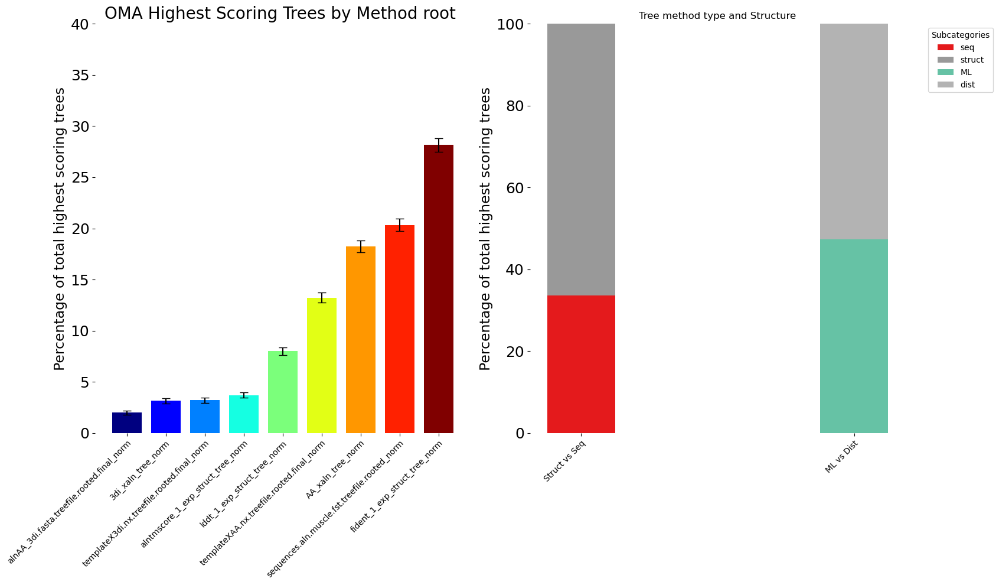

/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))


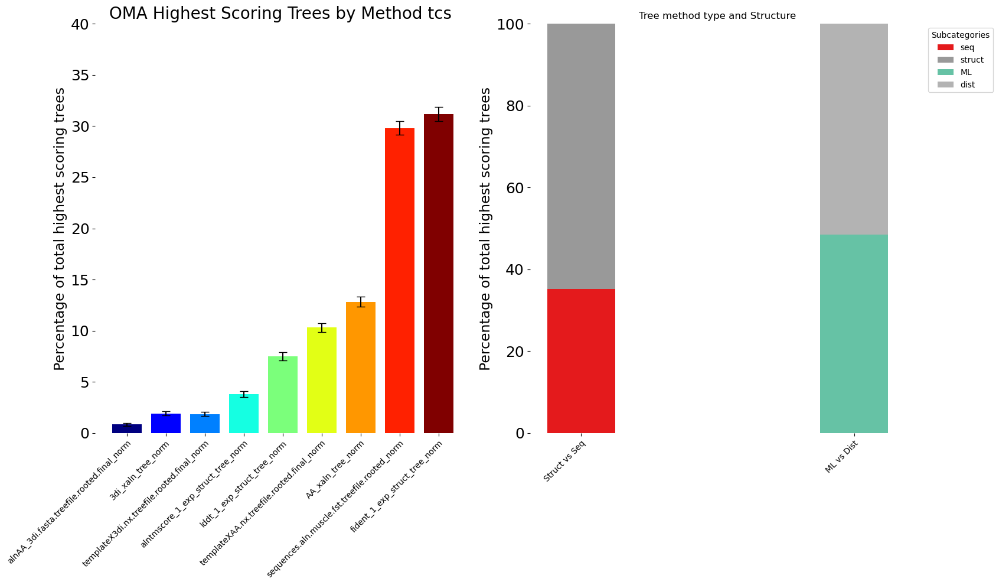

/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))


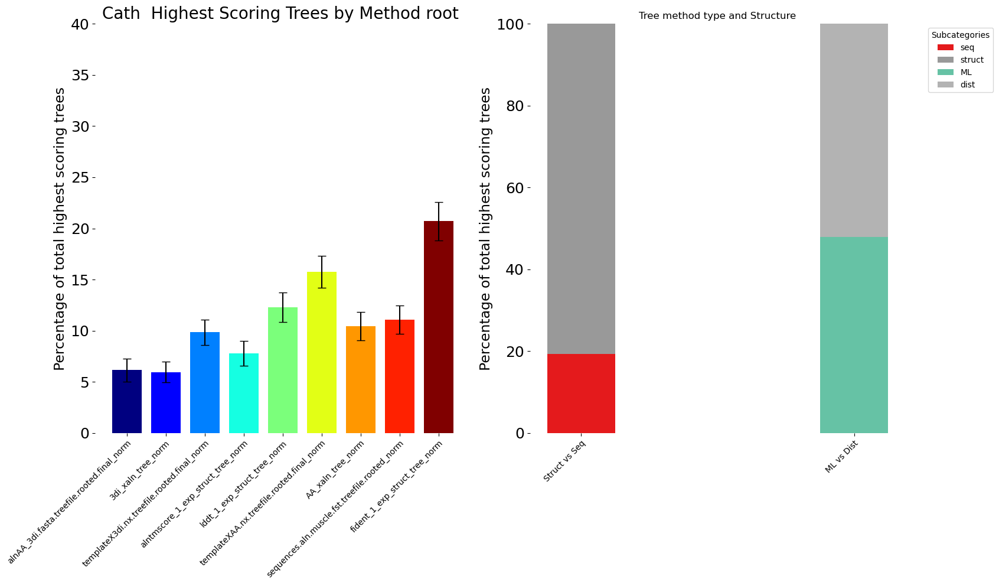

/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))
/tmp/47872125/ipykernel_1516033/3447097349.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmaps[i], len(df))


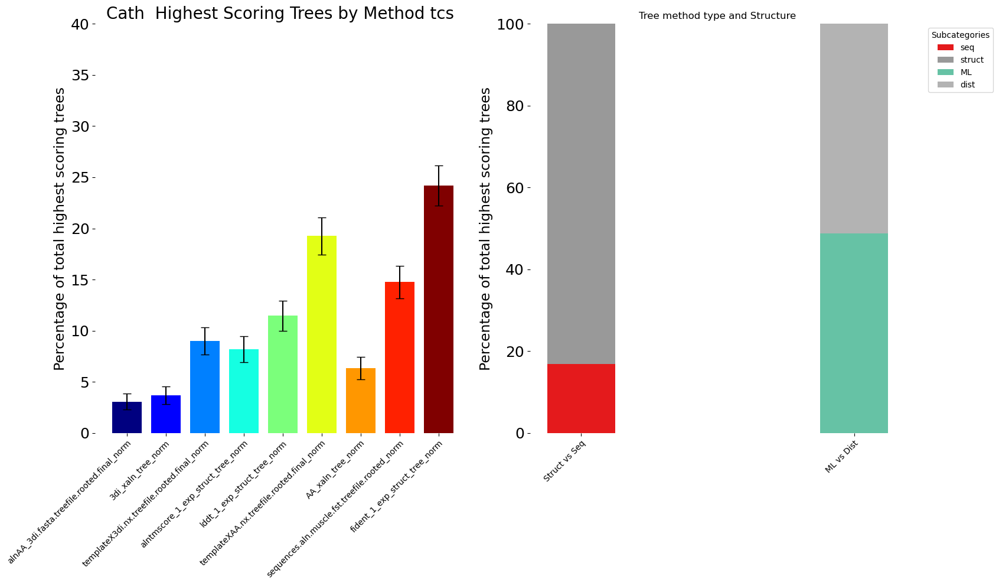

In [31]:
cscheme = None
order = None
for title,dfpair in { 'OMA Highest Scoring Trees by Method':(normalized, normalized_ntcs) , 'Cath  Highest Scoring Trees by Method':( cathnormalized , cathnormalized_ntcs) }.items():
    df1 , df2 = dfpair
    nsamples = len(df1)
    maxpercents_root = group_methods(df1)
    maxpercents_tcs = group_methods(df2)
    if order is None:
        order={ i:list(maxpercents_root[i].index) for i in range(len(maxpercents_root) ) }
    if cscheme is None:
        cscheme = {}
        cmaps = [ 'jet' , 'Set1' , 'Set2']
        for i,df in enumerate(maxpercents_root):
            cmap = cm.get_cmap(cmaps[i], len(df))
            for j,r in enumerate(df.index.unique()):
                cscheme[df.index[j]] = cmap(j)
        print(cscheme )
    stacked_barplot_2(maxpercents_root , cscheme , title + ' root ' , order,  nsamples= nsamples)
    stacked_barplot_2(maxpercents_tcs, cscheme , title + ' tcs ' , order , nsamples = nsamples )
    

Wilcoxon Test Statistic: 38314.0, P-value: 9.246575600575937e-06
Kolmogorov-Smirnov Test Statistic: 0.045081967213114756, P-value: 0.7047774997015563
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-30.714285714285722, 16.771428571428572), mean=-0.6342879293114217, variance=13.266649369159298, skewness=-2.4518521734313903, kurtosis=19.118171551447958)
total tcs diff -309.5325095039738
[<matplotlib.lines.Line2D object at 0x7fb8fc484470>, <matplotlib.lines.Line2D object at 0x7fb911234200>, <matplotlib.lines.Line2D object at 0x7fb911236780>] ['Struct better', 'Seq better', 'Equal']


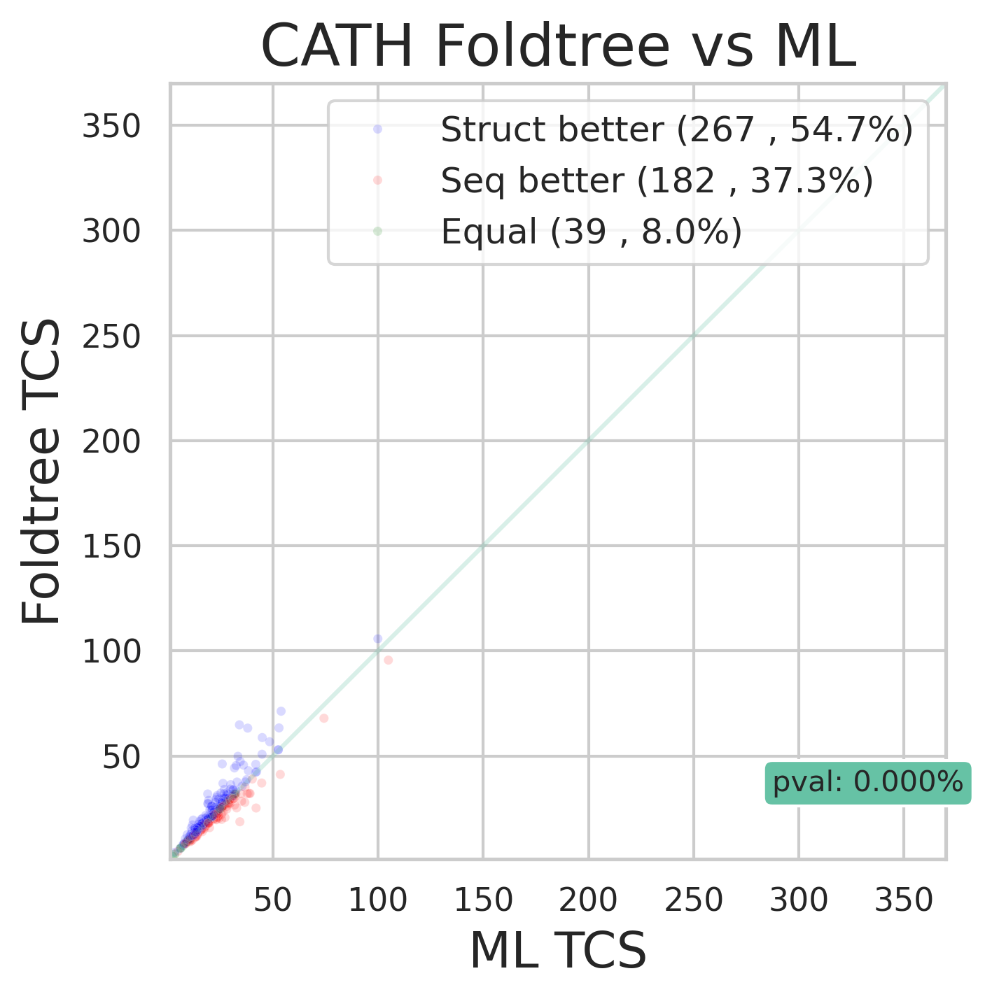

In [155]:
#species tree discordance for cat dataset
#retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' ,   cathdf_ntcs 
#         ,'Sequence TCS' ,  'Foldtree TCS',  'CATH Sequence ML vs Foldtree : tcs' , axlim = 35, cutoff = 0  )

#species tree discordance for cat dataset
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' ,   cathdf 
         ,'ML TCS' ,  'Foldtree TCS',  'CATH Foldtree vs ML' , cutoff = 0 )


Wilcoxon Test Statistic: 40261.5, P-value: 0.1322573500154722
Kolmogorov-Smirnov Test Statistic: 0.028688524590163935, P-value: 0.9881376940844173
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-4.840909090909091, 6.7272727272727275), mean=-0.042089494885100484, variance=0.5656575479046564, skewness=0.8424725502944671, kurtosis=24.847625007158253)
total tcs diff -20.539673503929038
[<matplotlib.lines.Line2D object at 0x7fb90fe6fcb0>, <matplotlib.lines.Line2D object at 0x7fb90fe6f530>, <matplotlib.lines.Line2D object at 0x7fb90fe6c530>] ['Equal', 'Seq better', 'Struct better']


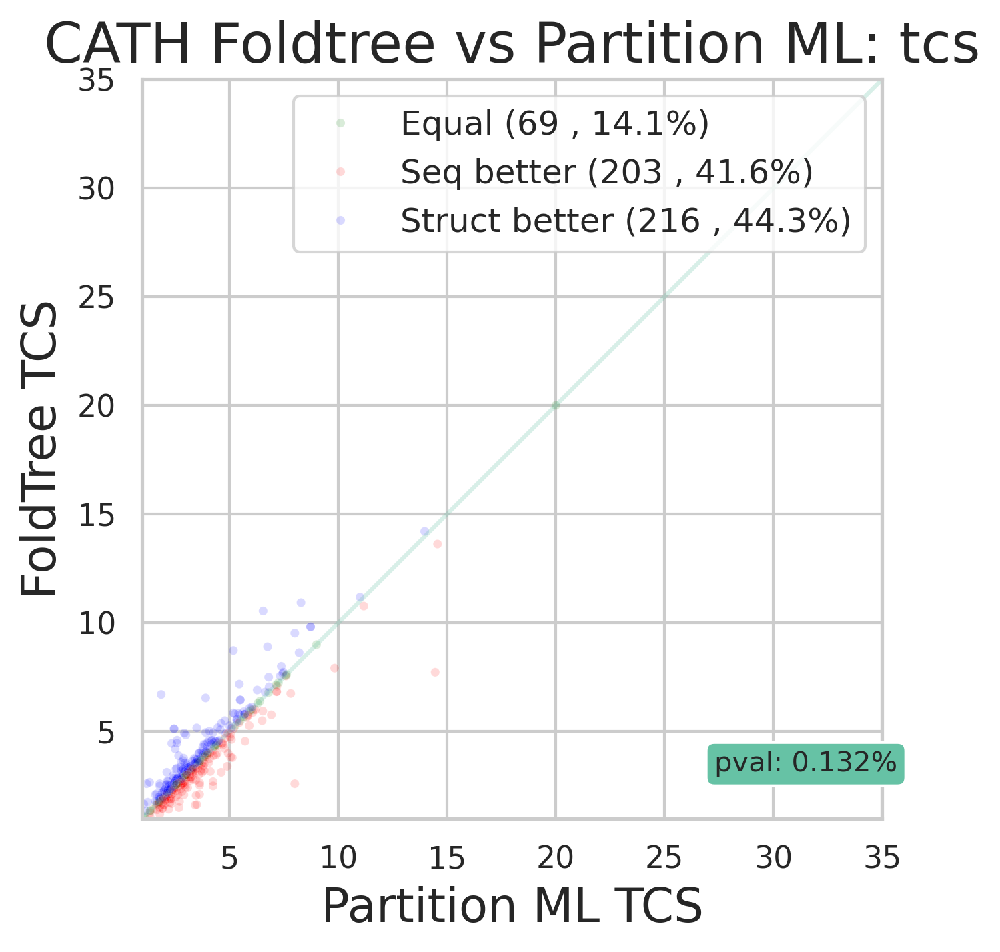

Wilcoxon Test Statistic: 40866.0, P-value: 0.008184248748202205
Kolmogorov-Smirnov Test Statistic: 0.028688524590163935, P-value: 0.9881376940844173
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-24.692307692307693, 57.46666666666667), mean=-0.19749322314994328, variance=20.0319993608825, skewness=5.011800244620793, kurtosis=66.64326198604378)
total tcs diff -96.37669289717232
[<matplotlib.lines.Line2D object at 0x7fb8fc5cb320>, <matplotlib.lines.Line2D object at 0x7fb90c89d970>, <matplotlib.lines.Line2D object at 0x7fb8fc14bb60>] ['Struct better', 'Seq better', 'Equal']


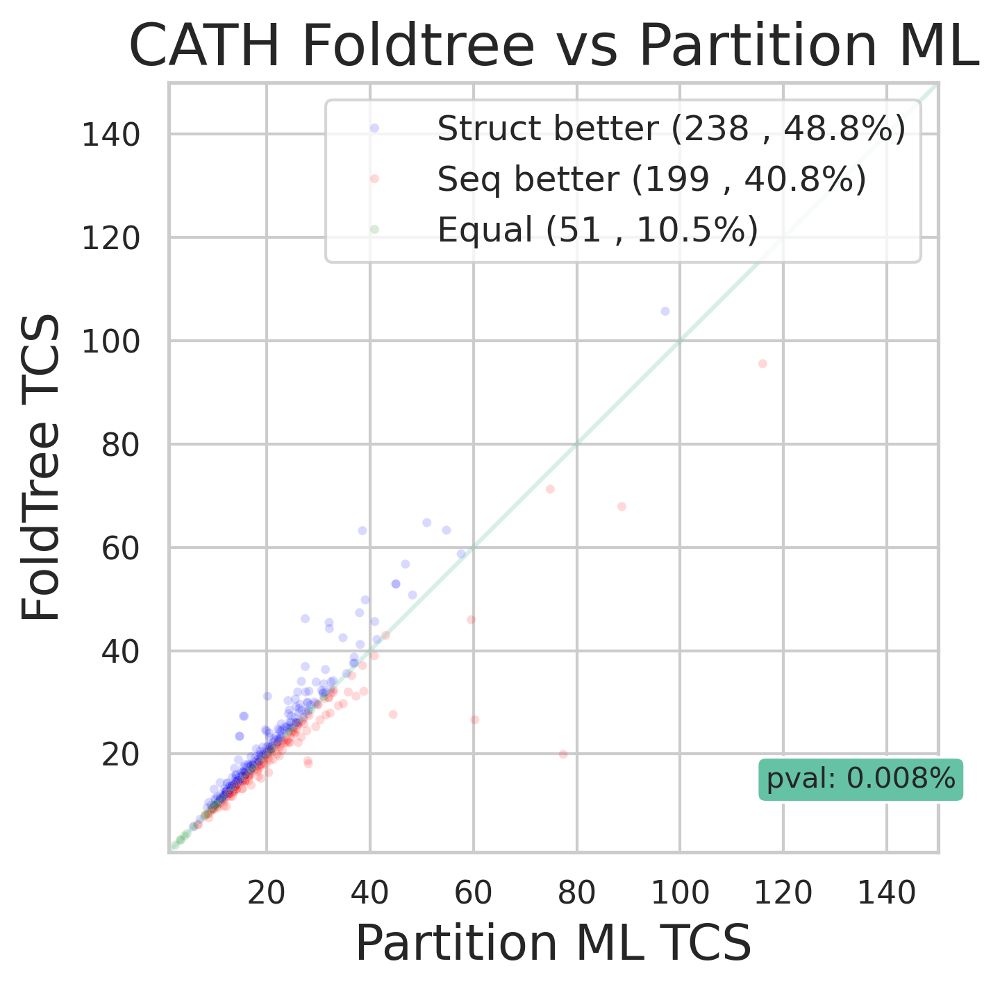

In [156]:
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,   cathdf_ntcs
         ,'Partition ML TCS' ,  'FoldTree TCS',  'CATH Foldtree vs Partition ML: tcs' , axlim = 35)
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,   cathdf 
         ,'Partition ML TCS' ,  'FoldTree TCS',  'CATH Foldtree vs Partition ML' ,  axlim = 150 )


Wilcoxon Test Statistic: 40866.0, P-value: 0.008184248748202205
Kolmogorov-Smirnov Test Statistic: 0.028688524590163935, P-value: 0.9881376940844173
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-24.692307692307693, 57.46666666666667), mean=-0.19749322314994328, variance=20.0319993608825, skewness=5.011800244620793, kurtosis=66.64326198604378)
total tcs diff -96.37669289717232
[<matplotlib.lines.Line2D object at 0x7fb8fc2b9e80>, <matplotlib.lines.Line2D object at 0x7fb8fc2ba0f0>, <matplotlib.lines.Line2D object at 0x7fb8fc2ba4b0>] ['Struct better', 'Seq better', 'Equal']


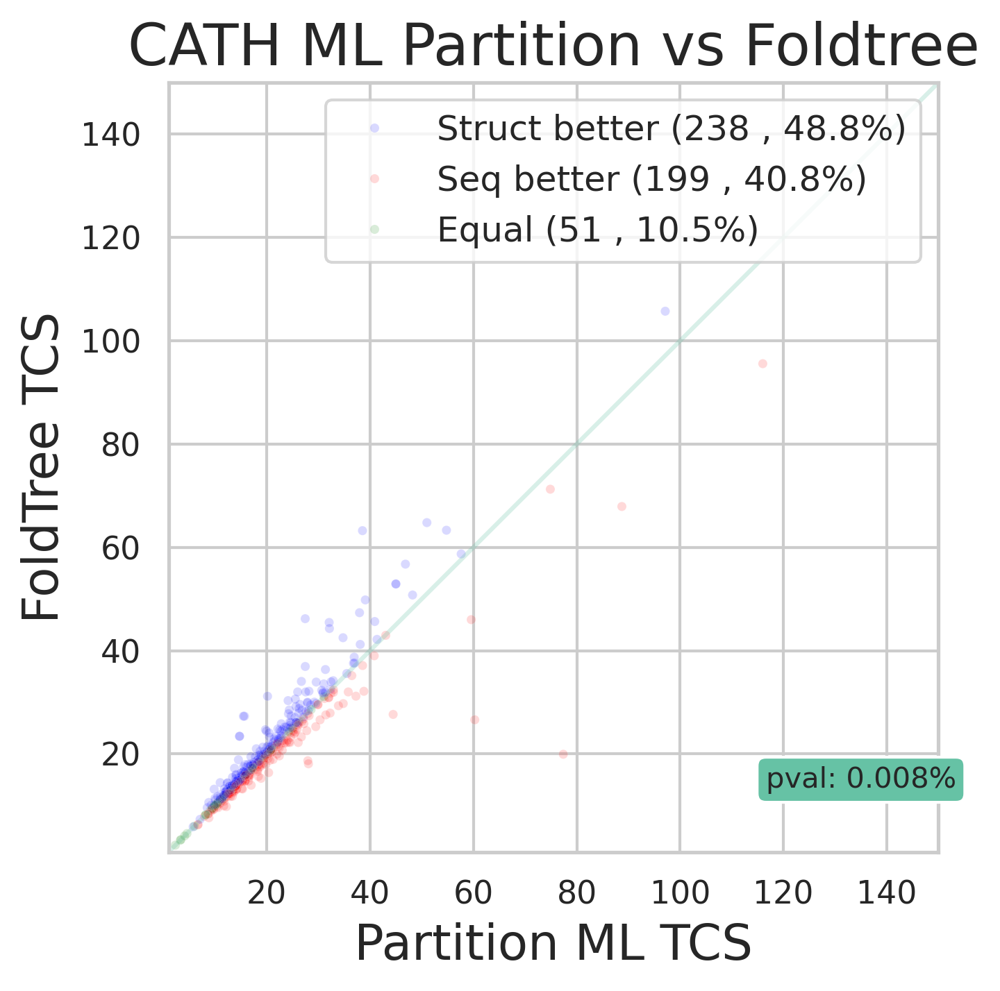

Wilcoxon Test Statistic: 43736.5, P-value: 0.0023589451706744827
Kolmogorov-Smirnov Test Statistic: 0.03278688524590164, P-value: 0.9559628268793132
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-24.692307692307693, 59.60000000000001), mean=0.35908219850518736, variance=20.423566959327335, skewness=5.27596759431836, kurtosis=68.8621842048987)
total tcs diff 175.23211287053144
[<matplotlib.lines.Line2D object at 0x7fb90c3c4d70>, <matplotlib.lines.Line2D object at 0x7fb90c3c5580>, <matplotlib.lines.Line2D object at 0x7fb90c3c5430>] ['Struct better', 'Seq better', 'Equal']


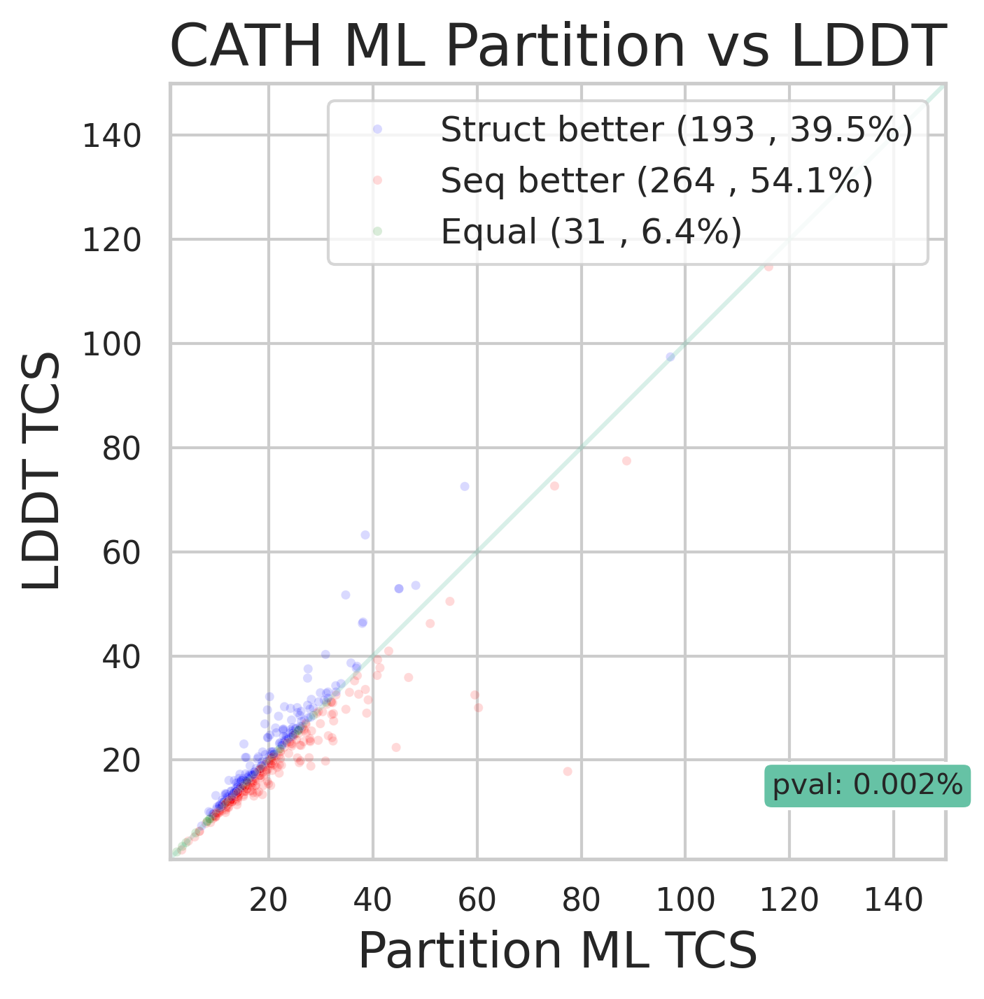

Wilcoxon Test Statistic: 31281.5, P-value: 1.2922041898107622e-16
Kolmogorov-Smirnov Test Statistic: 0.09240246406570841, P-value: 0.031222378077204117
Treescore delta statistics
DescribeResult(nobs=487, minmax=(-17.6875, 59.06666666666668), mean=0.8563512117286882, variance=20.77348045178619, skewness=5.677012884342585, kurtosis=66.77767615185736)
total tcs diff 417.04304011187116
[<matplotlib.lines.Line2D object at 0x7fb8fd31c5f0>, <matplotlib.lines.Line2D object at 0x7fb8fc2c5c10>, <matplotlib.lines.Line2D object at 0x7fb90c109550>] ['Struct better', 'Seq better', 'Equal']


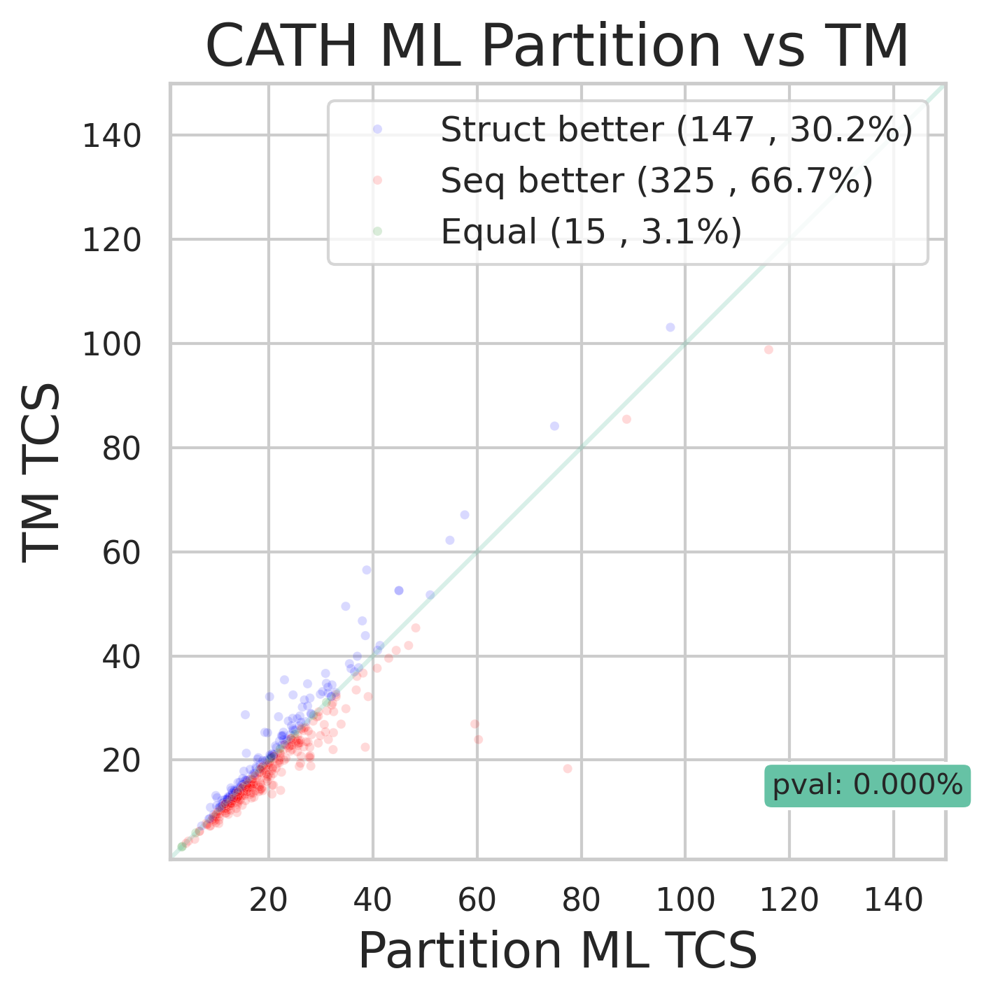

Wilcoxon Test Statistic: 38314.0, P-value: 9.246575600575937e-06
Kolmogorov-Smirnov Test Statistic: 0.045081967213114756, P-value: 0.7047774997015563
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-30.714285714285722, 16.771428571428572), mean=-0.6342879293114217, variance=13.266649369159298, skewness=-2.4518521734313903, kurtosis=19.118171551447958)
total tcs diff -309.5325095039738
[<matplotlib.lines.Line2D object at 0x7fb90c44c470>, <matplotlib.lines.Line2D object at 0x7fb8ff04b140>, <matplotlib.lines.Line2D object at 0x7fb8ff04aff0>] ['Struct better', 'Seq better', 'Equal']


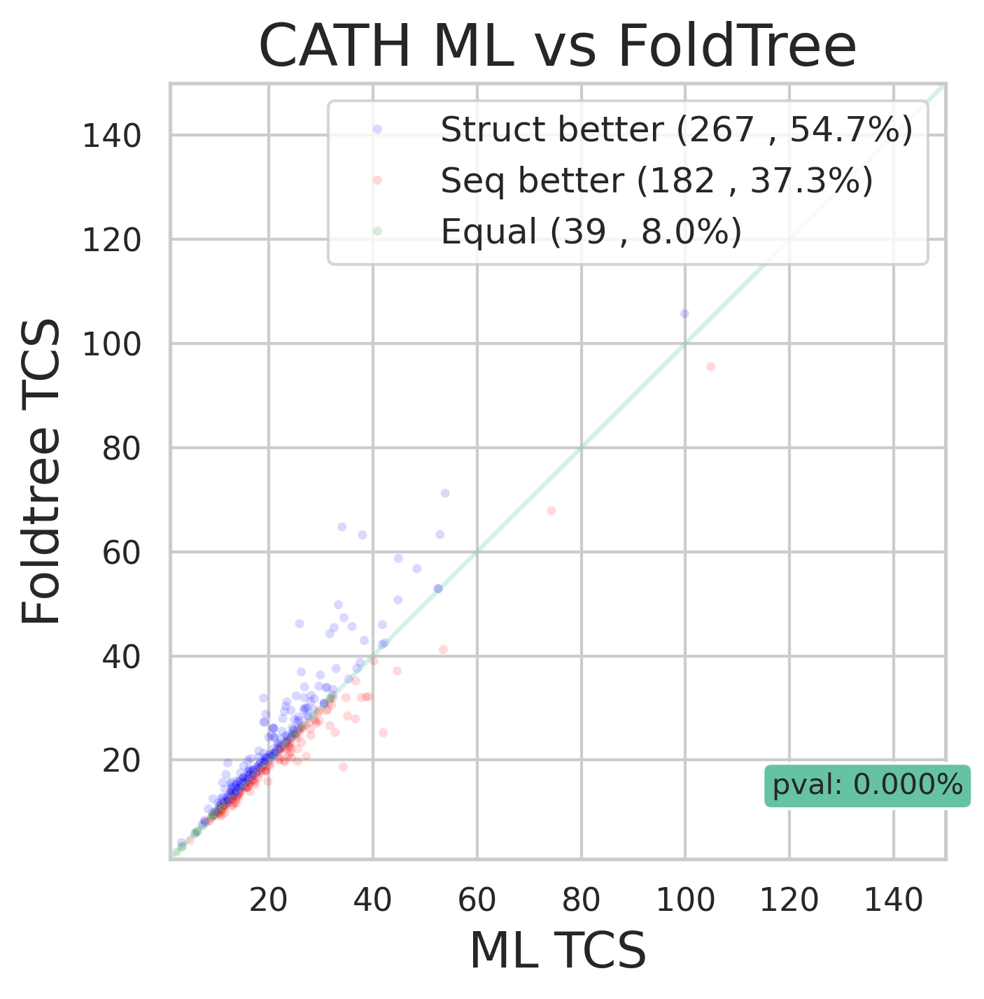

Wilcoxon Test Statistic: 49386.0, P-value: 0.29790289999077535
Kolmogorov-Smirnov Test Statistic: 0.03483606557377049, P-value: 0.9289688595778146
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-27.63636363636364, 17.814285714285717), mean=-0.07771250765629113, variance=12.563460154050286, skewness=-1.8968610516294688, kurtosis=16.306759885929306)
total tcs diff -37.92370373627007
[<matplotlib.lines.Line2D object at 0x7fb9055d9190>, <matplotlib.lines.Line2D object at 0x7fb9055d9220>, <matplotlib.lines.Line2D object at 0x7fb9055d8c20>] ['Struct better', 'Seq better', 'Equal']


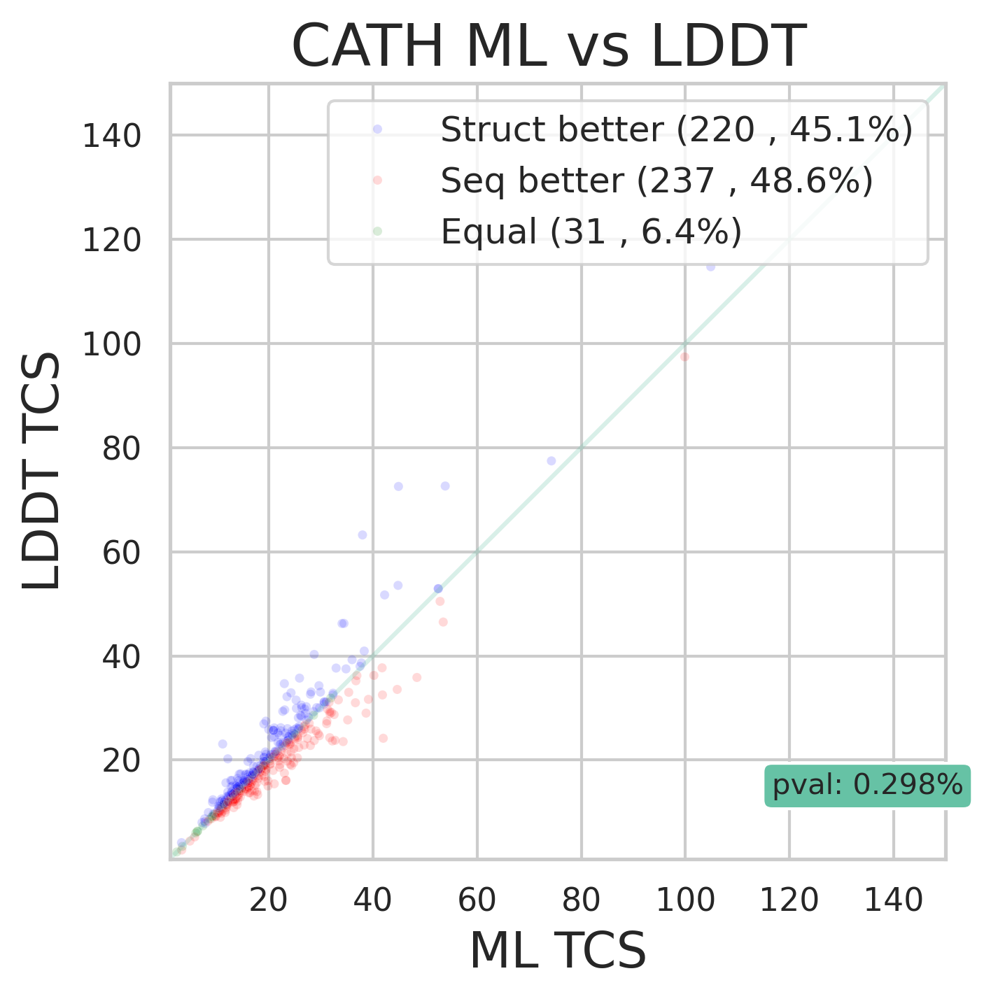

Wilcoxon Test Statistic: 37174.5, P-value: 6.969047643843903e-10
Kolmogorov-Smirnov Test Statistic: 0.08213552361396304, P-value: 0.07482182503930139
Treescore delta statistics
DescribeResult(nobs=487, minmax=(-30.257142857142853, 16.799999999999997), mean=0.4186595965196502, variance=14.956311455553596, skewness=-1.557487581441873, kurtosis=14.3613866003062)
total tcs diff 203.88722350506964
[<matplotlib.lines.Line2D object at 0x7fb90c5ad5e0>, <matplotlib.lines.Line2D object at 0x7fb90c5ad1f0>, <matplotlib.lines.Line2D object at 0x7fb90c5aee40>] ['Struct better', 'Seq better', 'Equal']


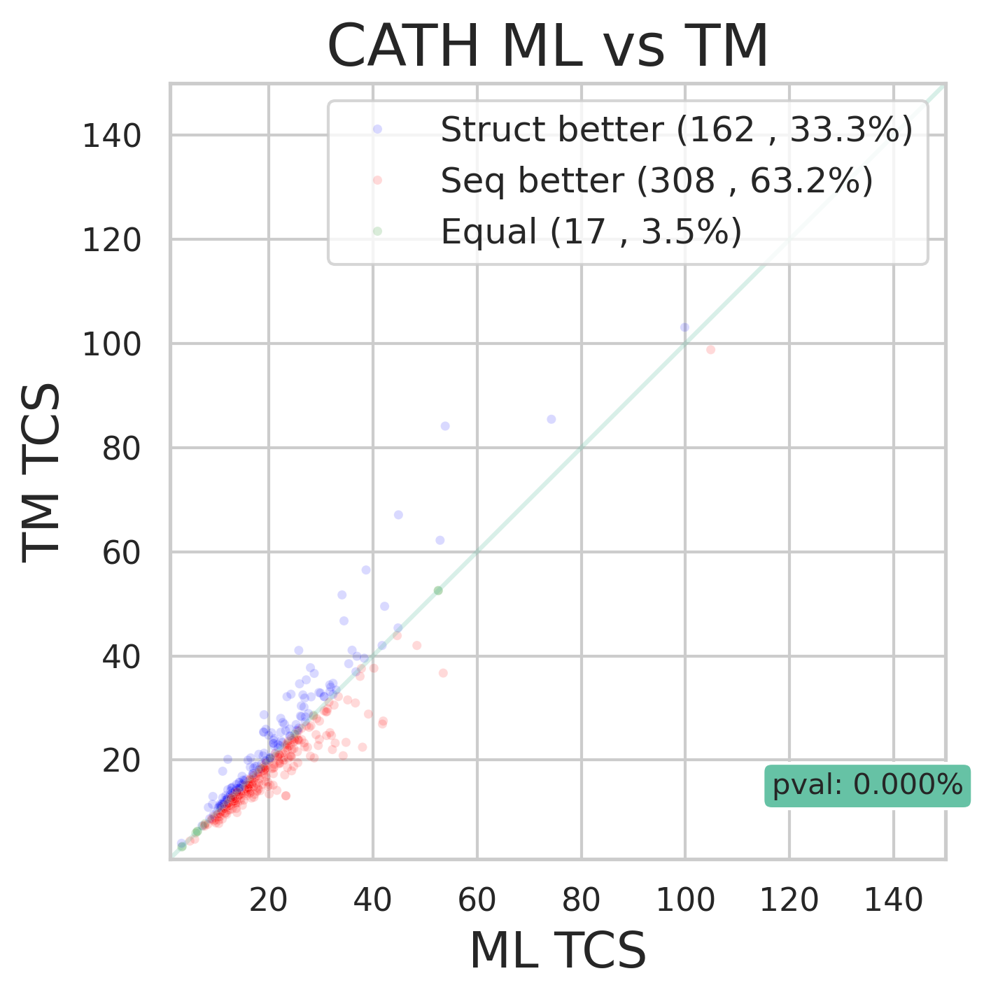

In [157]:
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,  cathdf
         ,'Partition ML TCS' ,  'FoldTree TCS',  'CATH ML Partition vs Foldtree' ,  axlim = 150)
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'lddt_1_exp_struct_tree_norm' ,  cathdf
         ,'Partition ML TCS' ,  'LDDT TCS',  'CATH ML Partition vs LDDT' ,  axlim = 150)
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'alntmscore_1_exp_struct_tree_norm' ,  cathdf
         ,'Partition ML TCS' ,  'TM TCS',  'CATH ML Partition vs TM' ,  axlim = 150)



#species tree discordance for cat dataset
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' ,   cathdf 
         ,'ML TCS' ,  'Foldtree TCS',  'CATH ML vs FoldTree' ,  axlim = 150 )
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'lddt_1_exp_struct_tree_norm' ,  cathdf
         ,'ML TCS' ,  'LDDT TCS',  'CATH ML vs LDDT ' ,  axlim = 150)
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'alntmscore_1_exp_struct_tree_norm' ,  cathdf
         ,'ML TCS' ,  'TM TCS',  'CATH ML vs TM ' ,  axlim = 150)

Wilcoxon Test Statistic: 18011.0, P-value: 1.514323166866033e-26
Kolmogorov-Smirnov Test Statistic: 0.15163934426229508, P-value: 2.5934250367852514e-05
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-7.914285714285715, 5.777777777777779), mean=-0.38195532828590234, variance=1.1277363365527153, skewness=-1.8847186382212633, kurtosis=15.715669688975137)
total tcs diff -186.39420020352034
[<matplotlib.lines.Line2D object at 0x7fb8fc394470>, <matplotlib.lines.Line2D object at 0x7fb90cc20350>, <matplotlib.lines.Line2D object at 0x7fb90cc205c0>] ['Equal', 'Struct better', 'Seq better']


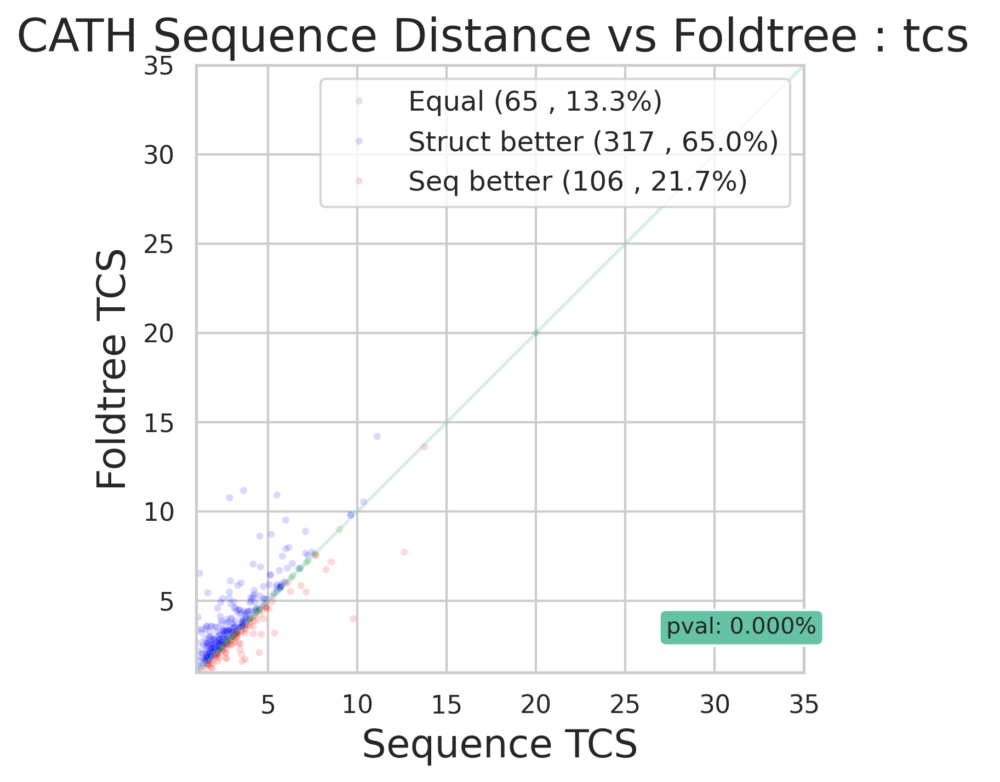

Wilcoxon Test Statistic: 29693.5, P-value: 7.6702150552535e-13
Kolmogorov-Smirnov Test Statistic: 0.07377049180327869, P-value: 0.1404905527429867
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-38.25714285714285, 25.232142857142858), mean=-0.8762017690468459, variance=19.18878898464263, skewness=-1.7120221506340143, kurtosis=21.553387899097594)
total tcs diff -427.5864632948608
[<matplotlib.lines.Line2D object at 0x7fb8fc6ec470>, <matplotlib.lines.Line2D object at 0x7fb8ff1e8200>, <matplotlib.lines.Line2D object at 0x7fb8ff1e9c70>] ['Struct better', 'Seq better', 'Equal']


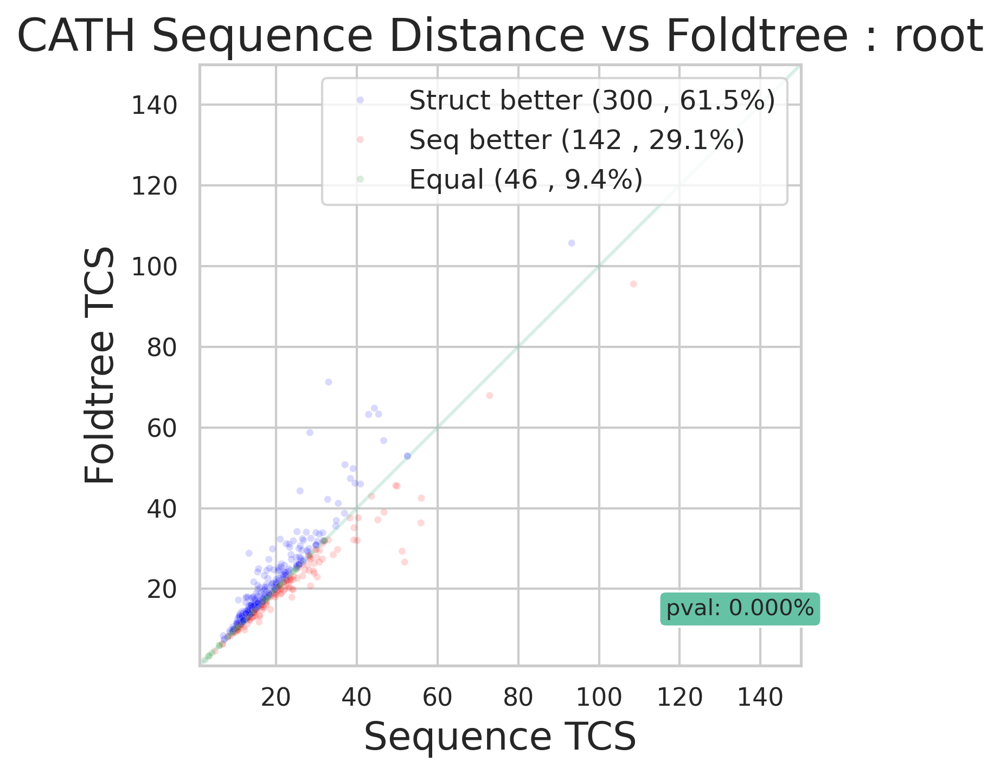

In [158]:
#species tree discordance for cat dataset
retgraph(  'AA_xaln_tree_norm' , 'fident_1_exp_struct_tree_norm' ,   cathdf_ntcs 
         ,'Sequence TCS' ,  'Foldtree TCS',  'CATH Sequence Distance vs Foldtree : tcs ' , cutoff = 0 , axlim = 35 )

#species tree discordance for cat dataset
retgraph(  'AA_xaln_tree_norm' , 'fident_1_exp_struct_tree_norm' ,  cathdf 
         ,'Sequence TCS' ,  'Foldtree TCS',  'CATH Sequence Distance vs Foldtree : root' , cutoff = 0 , axlim = 150)


Wilcoxon Test Statistic: 40866.0, P-value: 0.008184248748202205
Kolmogorov-Smirnov Test Statistic: 0.028688524590163935, P-value: 0.9881376940844173
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-24.692307692307693, 57.46666666666667), mean=-0.19749322314994328, variance=20.0319993608825, skewness=5.011800244620793, kurtosis=66.64326198604378)
total tcs diff -96.37669289717232
[<matplotlib.lines.Line2D object at 0x7fb8fc3c1c70>, <matplotlib.lines.Line2D object at 0x7fb90c7486e0>, <matplotlib.lines.Line2D object at 0x7fb90c749e20>] ['Struct better', 'Seq better', 'Equal']


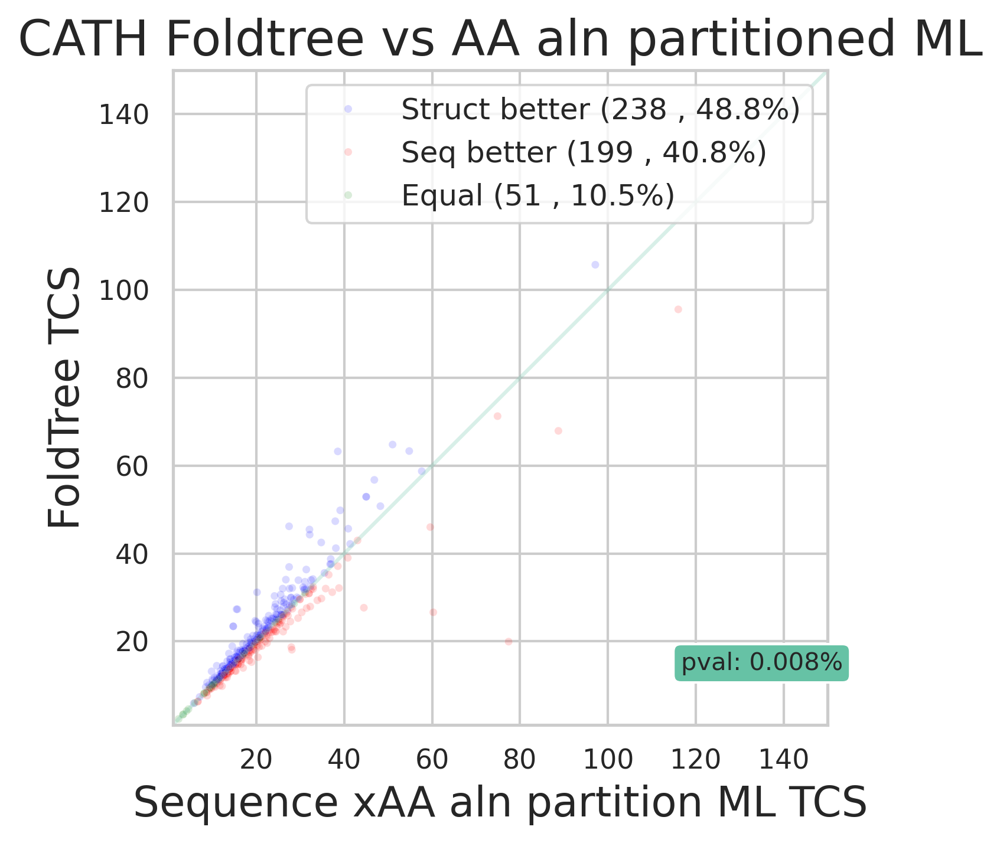

Wilcoxon Test Statistic: 30253.0, P-value: 1.0084072252062329e-16
Kolmogorov-Smirnov Test Statistic: 0.07172131147540983, P-value: 0.16247977015448029
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-17.63636363636364, 28.0), mean=-0.9363292471922792, variance=12.53949346421912, skewness=0.2146898977261682, kurtosis=14.665145374499595)
total tcs diff -456.92867262983225
[<matplotlib.lines.Line2D object at 0x7fb90c9b9f10>, <matplotlib.lines.Line2D object at 0x7fb90c9ba4b0>, <matplotlib.lines.Line2D object at 0x7fb90c9ba750>] ['Struct better', 'Seq better', 'Equal']


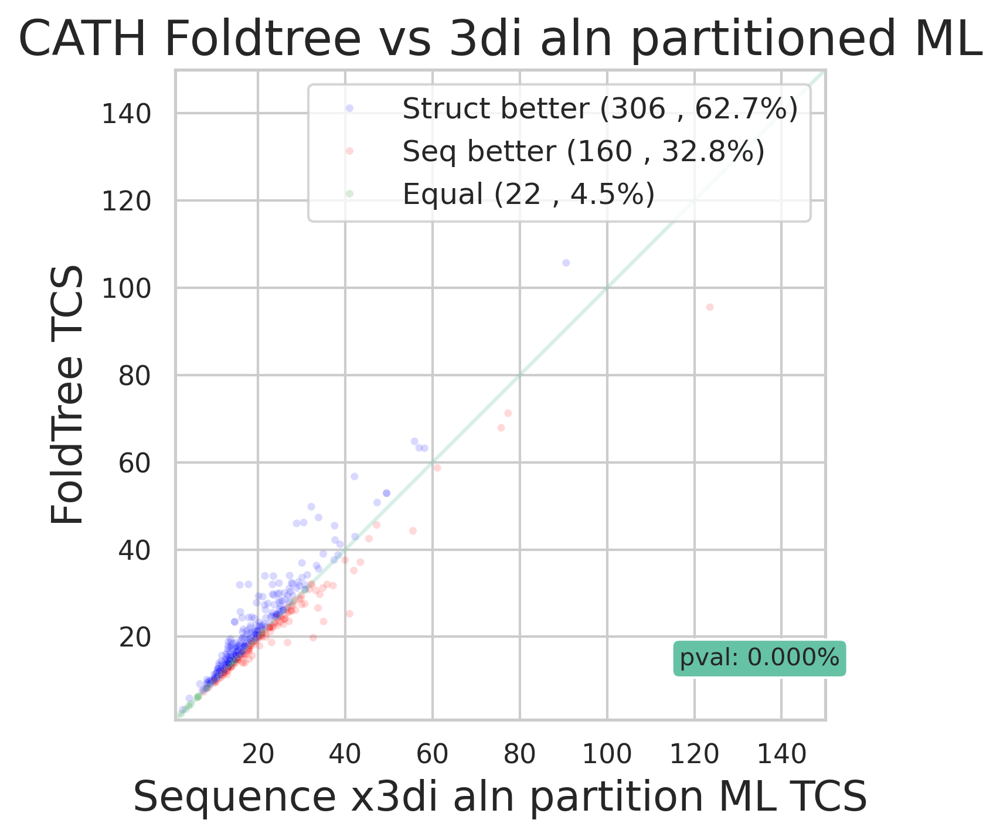

In [159]:
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,  cathdf
         ,'Sequence xAA aln partition ML TCS' ,  'FoldTree TCS',  'CATH Foldtree vs AA aln partitioned ML' ,  axlim = 150)


retgraph(  'templateX3di.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,  cathdf
         ,'Sequence x3di aln partition ML TCS' ,  'FoldTree TCS',  'CATH Foldtree vs 3di aln partitioned ML' ,  axlim = 150)


Wilcoxon Test Statistic: 42832.5, P-value: 0.0009990939164920595
Kolmogorov-Smirnov Test Statistic: 0.0471311475409836, P-value: 0.6509380038803851
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-42.363636363636374, 24.131578947368425), mean=-0.5107512876660519, variance=24.041109682402173, skewness=-2.551015054770249, kurtosis=26.940153589220298)
total tcs diff -249.24662838103333
[<matplotlib.lines.Line2D object at 0x7fb90c6c4470>, <matplotlib.lines.Line2D object at 0x7fb8ff26f530>, <matplotlib.lines.Line2D object at 0x7fb8fc46e330>] ['Struct better', 'Equal', 'Seq better']


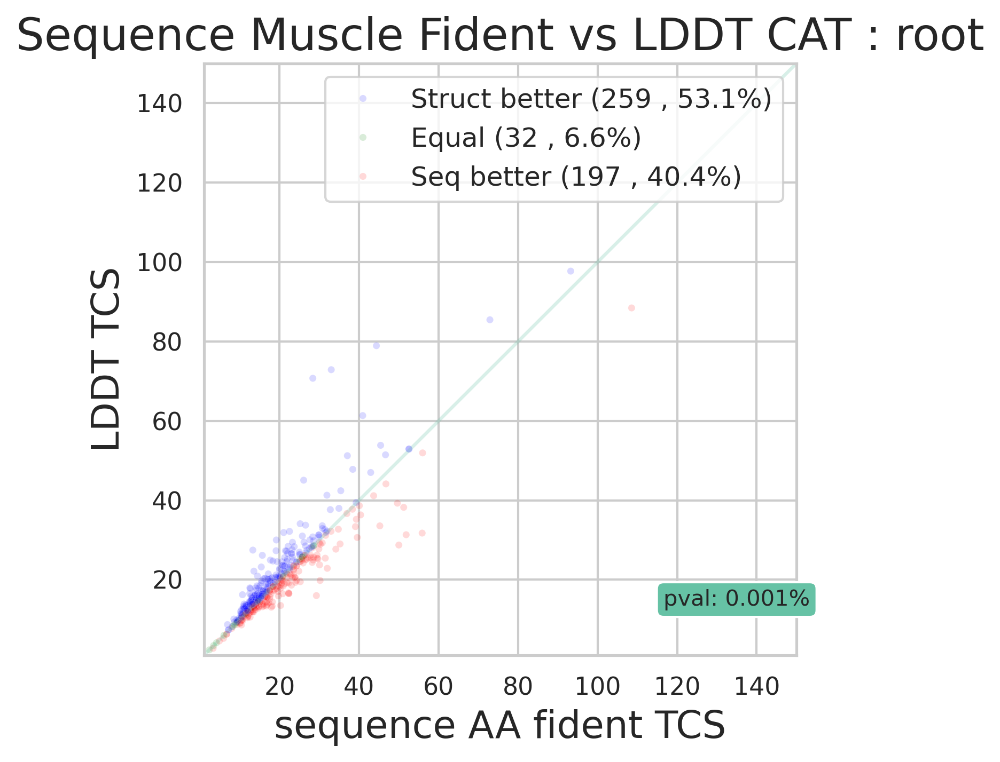

Wilcoxon Test Statistic: 26508.5, P-value: 4.236732676126553e-17
Kolmogorov-Smirnov Test Statistic: 0.08196721311475409, P-value: 0.07532784691670398
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-57.53846153846155, 24.946428571428573), mean=-1.0790292642090118, variance=22.70357863797804, skewness=-4.290893703290565, kurtosis=52.710679068885284)
total tcs diff -526.5662809339977
[<matplotlib.lines.Line2D object at 0x7fb90cd09310>, <matplotlib.lines.Line2D object at 0x7fb90cd08170>, <matplotlib.lines.Line2D object at 0x7fb90cd0bc20>] ['Equal', 'Seq better', 'Struct better']


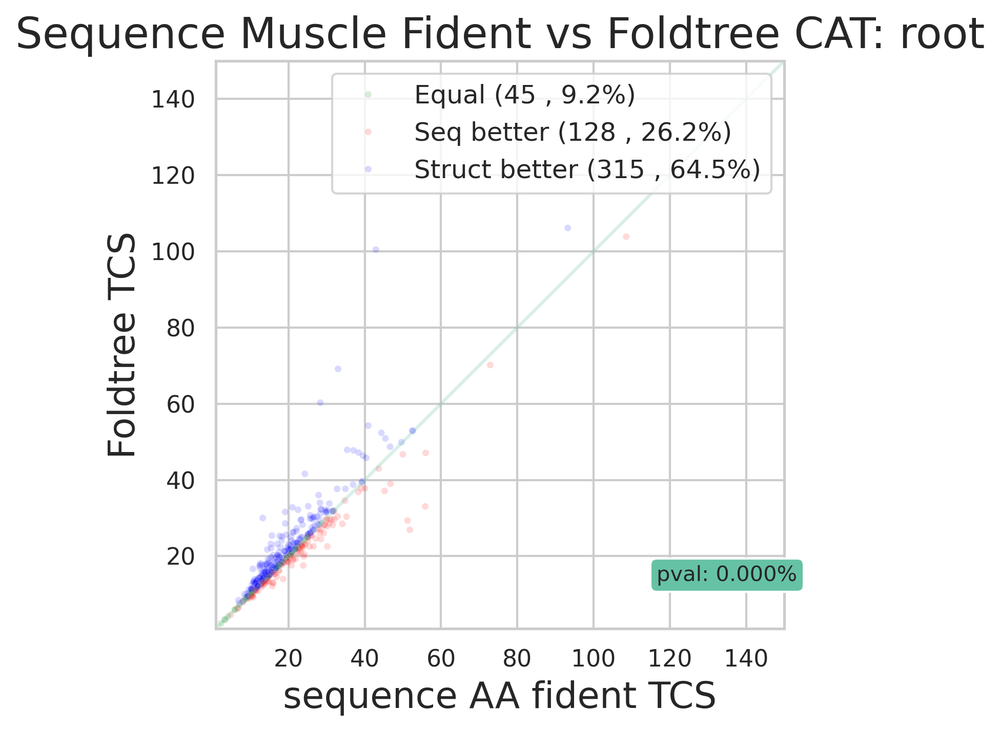

Wilcoxon Test Statistic: 46753.5, P-value: 0.0192084562843607
Kolmogorov-Smirnov Test Statistic: 0.045081967213114756, P-value: 0.7047774997015563
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-44.18181818181819, 22.815789473684212), mean=-0.3196263473917153, variance=21.676442872944126, skewness=-2.4199384823481607, kurtosis=29.71492329426414)
total tcs diff -155.97765752715708
[<matplotlib.lines.Line2D object at 0x7fb90c63a6f0>, <matplotlib.lines.Line2D object at 0x7fb90c639eb0>, <matplotlib.lines.Line2D object at 0x7fb8fedc29c0>] ['Seq better', 'Struct better', 'Equal']


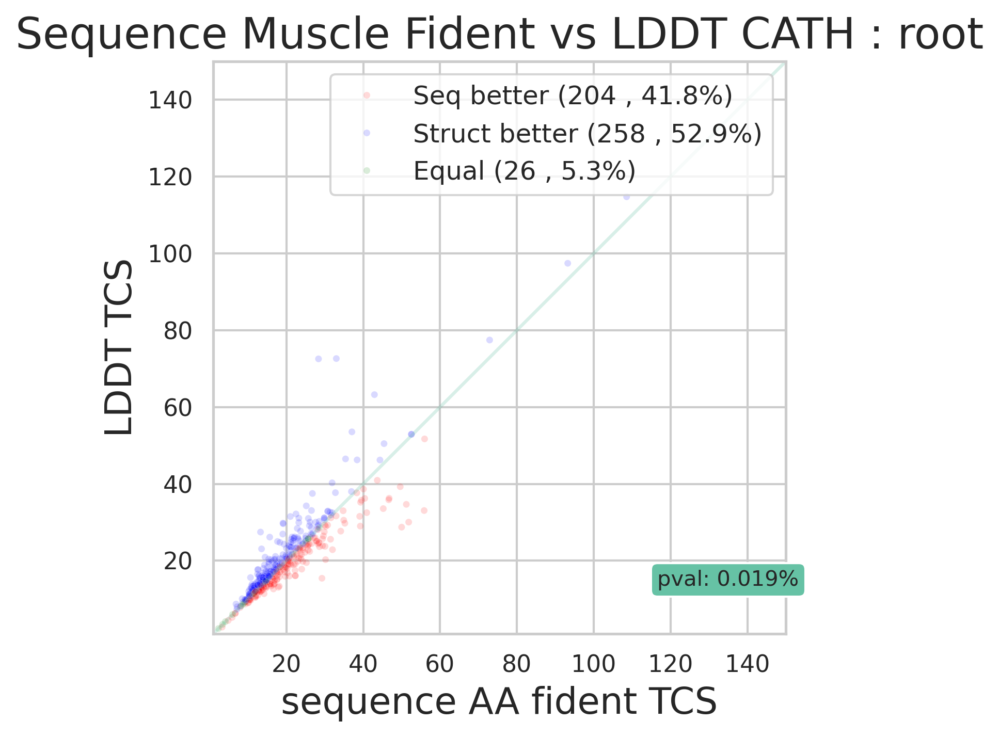

Wilcoxon Test Statistic: 34700.0, P-value: 5.574975063211551e-08
Kolmogorov-Smirnov Test Statistic: 0.10655737704918032, P-value: 0.007807547157546981
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-9.09090909090909, 5.8181818181818175), mean=-0.2042462803407657, variance=1.2830984019294964, skewness=-1.7768386299239052, kurtosis=17.079318264040346)
total tcs diff -99.67218480629366
[<matplotlib.lines.Line2D object at 0x7fb8ff11dd00>, <matplotlib.lines.Line2D object at 0x7fb91008ec30>, <matplotlib.lines.Line2D object at 0x7fb91008c860>] ['Struct better', 'Equal', 'Seq better']


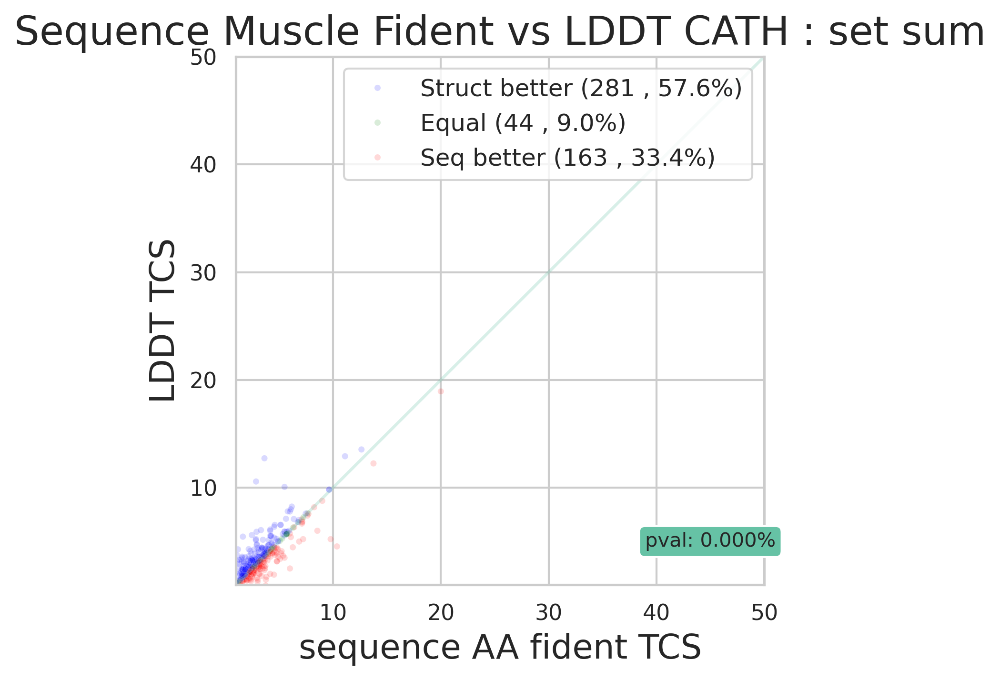

Wilcoxon Test Statistic: 14893.5, P-value: 4.54375916684199e-35
Kolmogorov-Smirnov Test Statistic: 0.16188524590163936, P-value: 5.347016815101106e-06
Treescore delta statistics
DescribeResult(nobs=488, minmax=(-12.23076923076923, 5.777777777777779), mean=-0.44878459936610765, variance=1.2269803253646279, skewness=-3.8583783534080434, kurtosis=35.99726934275875)
total tcs diff -219.00688449066052
[<matplotlib.lines.Line2D object at 0x7fb90cd4c4d0>, <matplotlib.lines.Line2D object at 0x7fb90cd4c710>, <matplotlib.lines.Line2D object at 0x7fb90cd4ce00>] ['Equal', 'Struct better', 'Seq better']


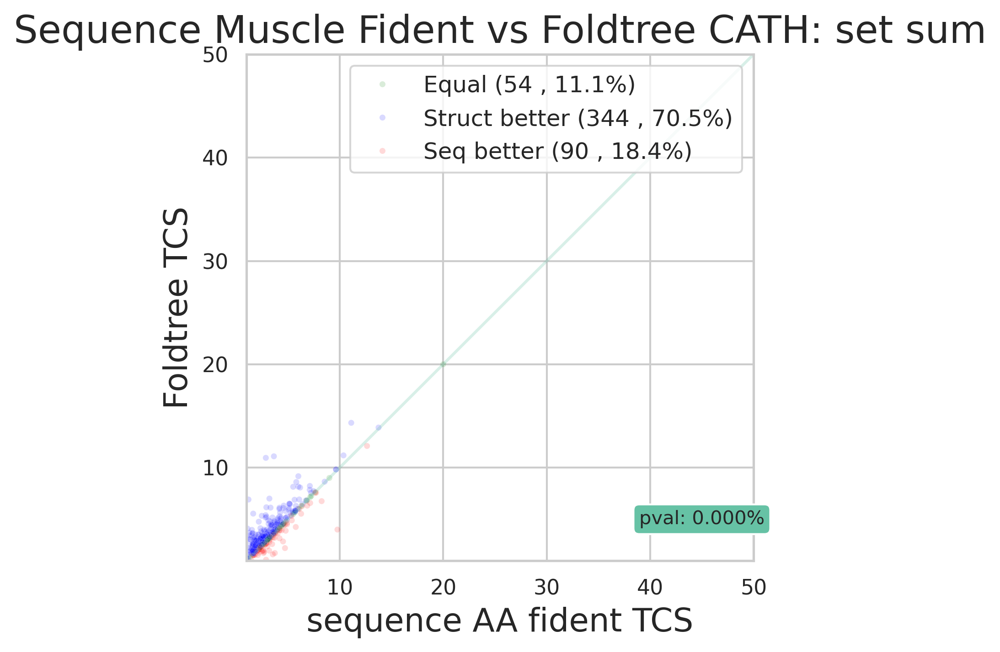

In [160]:
retgraph(  'AA_xaln_tree_norm' , 'lddt_1_raw_struct_tree_norm' , cathdf 
         ,'sequence AA fident TCS' ,  'LDDT TCS',  'Sequence Muscle Fident vs LDDT CAT : root',  axlim = 150)

retgraph(  'AA_xaln_tree_norm' , 'fident_1_raw_struct_tree_norm' , cathdf 
         ,'sequence AA fident TCS' ,  'Foldtree TCS',  'Sequence Muscle Fident vs Foldtree CAT: root',  axlim = 150)

retgraph(  'AA_xaln_tree_norm' , 'lddt_1_exp_struct_tree_norm' , cathdf 
         ,'sequence AA fident TCS' ,  'LDDT TCS',  'Sequence Muscle Fident vs LDDT CATH : root',  axlim = 150)



retgraph(  'AA_xaln_tree_norm' , 'lddt_1_raw_struct_tree_norm' , cathdf_ntcs 
         ,'sequence AA fident TCS' ,  'LDDT TCS',  'Sequence Muscle Fident vs LDDT CATH : set sum' , axlim = 50  )

retgraph(  'AA_xaln_tree_norm' , 'fident_1_raw_struct_tree_norm' , cathdf_ntcs 
         ,'sequence AA fident TCS' ,  'Foldtree TCS',  'Sequence Muscle Fident vs Foldtree CATH: set sum'  , axlim = 50  ) 


Wilcoxon Test Statistic: 19889.5, P-value: 5.797888580403282e-12
Kolmogorov-Smirnov Test Statistic: 0.136, P-value: 0.001920695824157961
Treescore delta statistics
DescribeResult(nobs=375, minmax=(-24.122448979591837, 35.83870967741936), mean=-1.0274816122648056, variance=34.43180564977601, skewness=1.6101286006432258, kurtosis=9.550301581839308)
total tcs diff -385.3056045993021
[<matplotlib.lines.Line2D object at 0x7fb8fc1cc470>, <matplotlib.lines.Line2D object at 0x7fb8fc4ea660>, <matplotlib.lines.Line2D object at 0x7fb8fc4e9f70>] ['Struct better', 'Seq better', 'Equal']


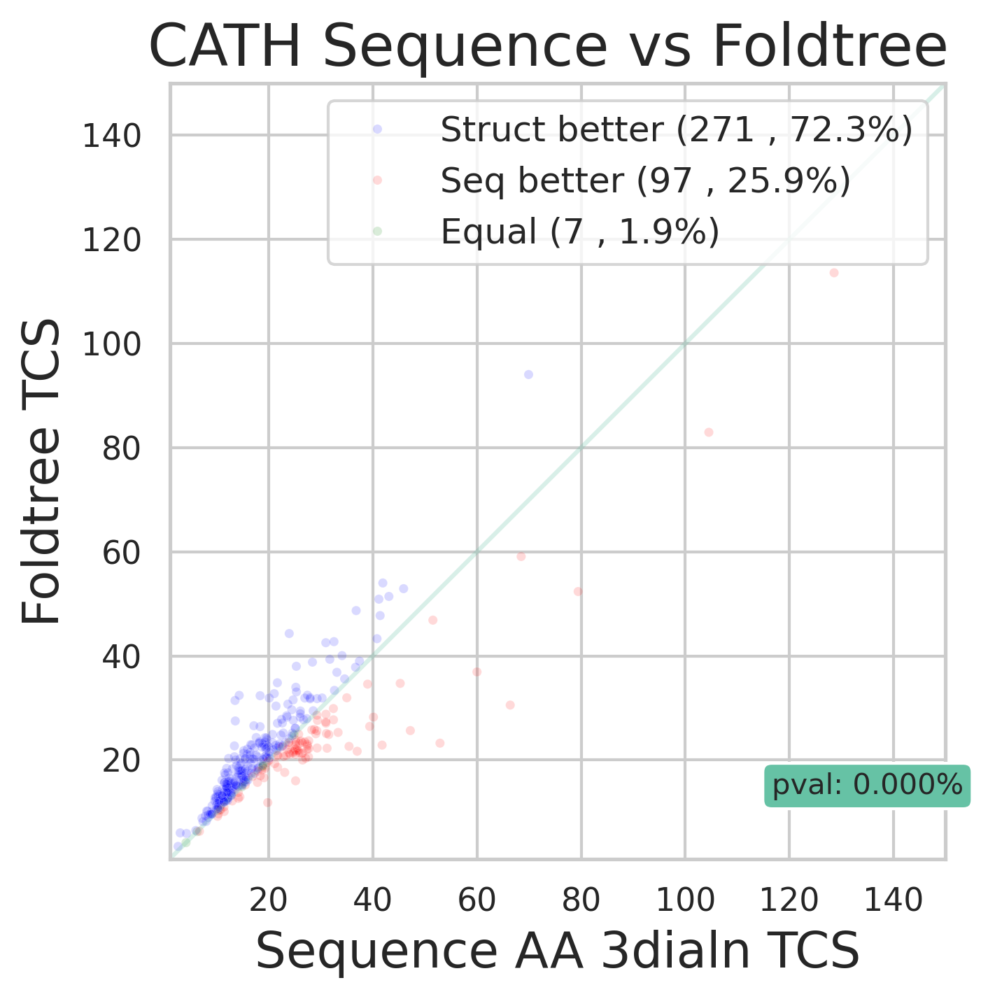

Wilcoxon Test Statistic: 16762.5, P-value: 2.4182365795362446e-17
Kolmogorov-Smirnov Test Statistic: 0.12533333333333332, P-value: 0.0054883371297840084
Treescore delta statistics
DescribeResult(nobs=375, minmax=(-27.500000000000007, 31.09677419354839), mean=-1.3939814424648966, variance=29.618456621292353, skewness=0.63180023356361, kurtosis=9.62062212693947)
total tcs diff -522.7430409243362
[<matplotlib.lines.Line2D object at 0x7fb8fe94b0b0>, <matplotlib.lines.Line2D object at 0x7fb8fe94a090>, <matplotlib.lines.Line2D object at 0x7fb8fc4ea810>] ['Struct better', 'Seq better', 'Equal']


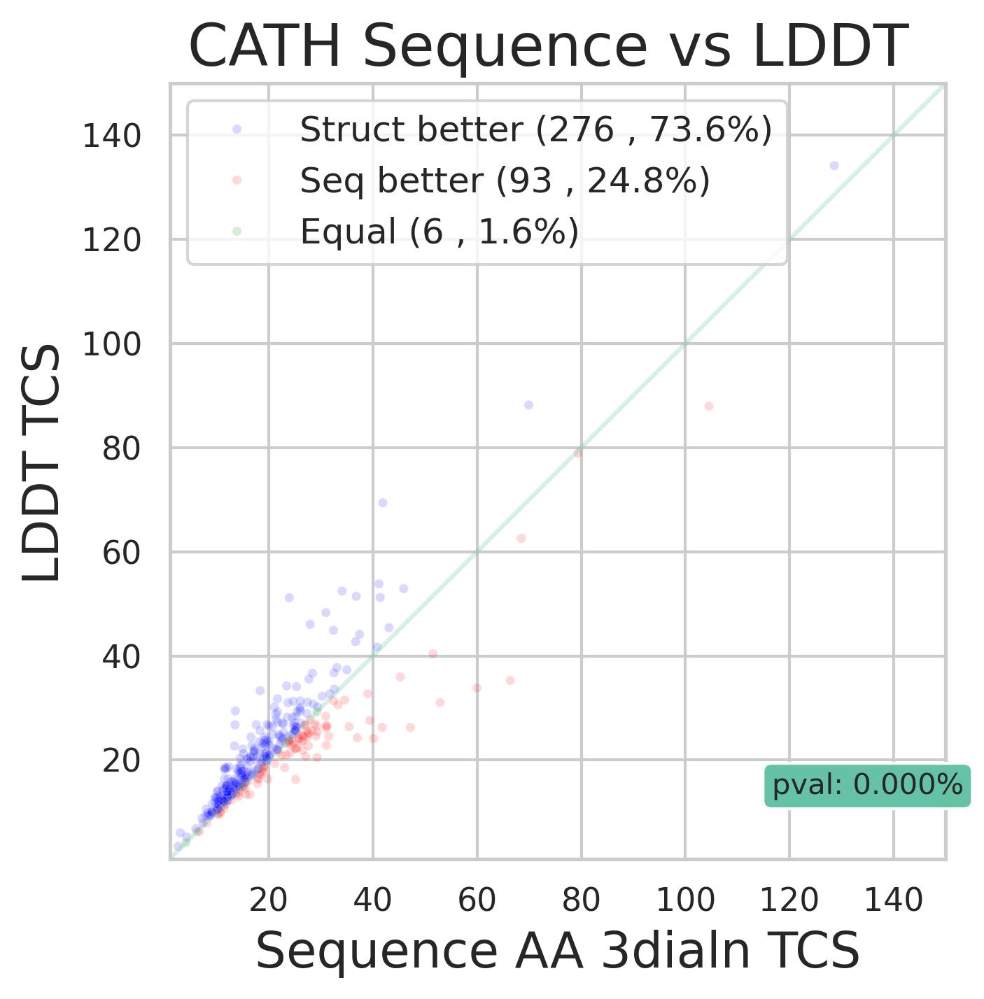

Wilcoxon Test Statistic: 22200.0, P-value: 5.89498572474416e-09
Kolmogorov-Smirnov Test Statistic: 0.10933333333333334, P-value: 0.022539475839712567
Treescore delta statistics
DescribeResult(nobs=375, minmax=(-30.058823529411764, 30.882352941176478), mean=-0.7715563063412009, variance=34.507838558281016, skewness=0.6580195791546866, kurtosis=8.853143016267143)
total tcs diff -289.3336148779503
[<matplotlib.lines.Line2D object at 0x7fb90cf1c470>, <matplotlib.lines.Line2D object at 0x7fb90c927530>, <matplotlib.lines.Line2D object at 0x7fb8ff01bce0>] ['Struct better', 'Seq better', 'Equal']


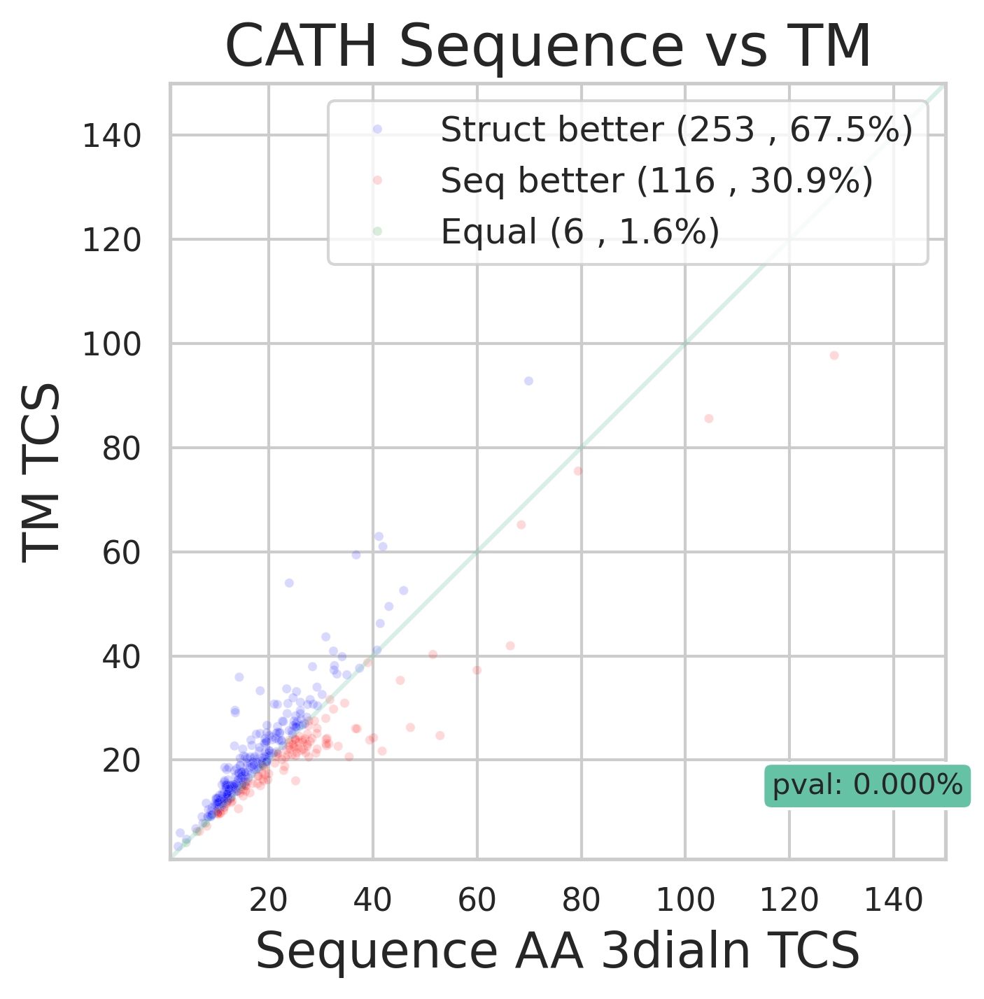

In [161]:
#species tree discordance for cat dataset
retgraph(  'alnAA_3di.fasta.treefile.rooted.final_norm' , 'fident_1_raw_struct_tree_norm' ,  catdf
         ,'Sequence AA 3dialn TCS' ,  'Foldtree TCS',  'CATH Sequence vs Foldtree ' ,  axlim = 150)
retgraph(  'alnAA_3di.fasta.treefile.rooted.final_norm' , 'lddt_1_raw_struct_tree_norm' ,  catdf
         ,'Sequence AA 3dialn TCS' ,  ' LDDT TCS',  'CATH Sequence vs LDDT ' ,  axlim = 150)
retgraph(  'alnAA_3di.fasta.treefile.rooted.final_norm' , 'alntmscore_1_raw_struct_tree_norm' ,  catdf
         ,'Sequence AA 3dialn TCS' ,  'TM TCS',  'CATH Sequence vs TM ',  axlim = 150)


In [162]:
retgraph_plotly(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' ,  unfiltereddf
         ,'Sequence TCS' ,  'Foldtree TCS',  '')

/work/FAC/FBM/DBC/cdessim2/default/dmoi/miniconda3/envs/torch/lib/python3.12/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [163]:
import toytree
def draw_multitree(newick1, newick2 , color1, color2 , annot_df= None , t1= '' ,t2= '' ):
    # Generate toytree objects from Newick strings
    tree1 = toytree.tree(newick1)
    tree2 = toytree.tree(newick2)

    if annot_df:
        annot_df = pd.read_csv( annot_df)
        annot_df['latin'] = annot_df.Organism.map( lambda x : ' '.join( x.split()[:2] ) )

        
        map = dict( zip ( annot_df.Entry , annot_df.latin )) 
        for t in (tree1,tree2):
            for l in t.treenode.get_leaves():
                if l.name in map:
                    l.name += ' '+map[l.name]

    
    if color1 == 'blue':
        labels = tree1.get_tip_labels()
    else:
        labels = tree2.get_tip_labels()

    # Create a multitree object from the individual trees
    mt = toytree.mtree([tree1, tree2])
    tree1.style.edge_style['stroke'] = color1
    tree2.style.edge_style['stroke'] = color2
    tree2.style.layout = 'l'

    print('left:' , t1 , 'right:' , t2 )
    
    # Drawing trees side-by-side with aligned tips, and individual styles
    canvas, axes, mark = mt.draw(
        fixed_order= labels, 
        edge_type='c',
        node_sizes=0,
        width=1000,
        height=800,
        tip_labels_align=True,
        tip_labels_style = { 'font-size':'15px'}
    )
    # Adding titles using text annotations
    return canvas

def plot_top10(df , t1= 'sequences.aln.muscle.fst.treefile.rooted_norm'  , t2= 'fident_1_raw_struct_tree_norm'  ):
    # Calculate the difference between column 'A' and 'B'
    df['Difference'] = (df[t1] - df[t2]).abs()
    # Sort the DataFrame by the 'Difference' column in descending order
    df_sorted = df.sort_values(by='Difference', ascending=False)    
    # Select the top 10 rows with the highest differences
    top_10 = df_sorted.head(20)
    for i,r in top_10.iterrows():
        print( i ,r )
        annot_df = i+'sequence_dataset.csv'
        c1 = 'blue'
        c2 = 'red'
        if r[t2] > r[t1]:
            c1 = 'red'
            c2 = 'blue'
        draw_multitree(i+'sequences.aln.muscle.fst.treefile', i+ 'fident_1_raw_struct_tree.PP.nwk.rooted' ,c1,c2, annot_df , t1 , t2)

In [164]:
# Draw a multitree with aligned tips

"""
folder = '../OMA_data_unfiltered/OMA_data/LUCA/HOG999/'
annot_df = folder + 'finalset.csv'
canvas = draw_multitree(newick2 = folder + 'sequences.aln.muscle.fst.treefile' , newick1 = folder + 'fident_1_exp_struct_tree.PP.nwk.rooted' , color1 = 'blue' , color2 = 'red' , annot_df = annot_df )
"""

"\nfolder = '../OMA_data_unfiltered/OMA_data/LUCA/HOG999/'\nannot_df = folder + 'finalset.csv'\ncanvas = draw_multitree(newick2 = folder + 'sequences.aln.muscle.fst.treefile' , newick1 = folder + 'fident_1_exp_struct_tree.PP.nwk.rooted' , color1 = 'blue' , color2 = 'red' , annot_df = annot_df )\n"

In [165]:
#plot_top10(unfiltereddf , t1= 'sequences.aln.muscle.fst.treefile.rooted_norm'  , t2= 'fident_1_exp_struct_tree_norm'  )

In [166]:
#plot_top10(cathdf , t1= 'sequences.aln.muscle.fst.treefile.rooted_norm'  , t2= 'fident_1_exp_struct_tree_norm'  )

In [167]:
#plot_top10(cathdf_ntcs , t1= 'sequences.aln.muscle.fst.treefile.rooted_norm'  , t2= 'fident_1_raw_struct_tree_norm'  )


In [168]:
#plot_top10(unfiltereddf_ntcs , t1= 'sequences.aln.muscle.fst.treefile.rooted_norm'  , t2= 'fident_1_raw_struct_tree_norm'  )

Wilcoxon Test Statistic: 1583048.5, P-value: 0.8064799796059052
Kolmogorov-Smirnov Test Statistic: 0.006098889130908299, P-value: 0.9999954804464485
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-22.904761904761898, 97.60975609756096), mean=0.03749277472194075, variance=7.944397720279372, skewness=11.018299563765831, kurtosis=359.7651747510612)
total tcs diff 172.12932874843
[<matplotlib.lines.Line2D object at 0x7fb90c924470>, <matplotlib.lines.Line2D object at 0x7fb90caad8e0>, <matplotlib.lines.Line2D object at 0x7fb90caadbe0>] ['Seq better', 'Struct better', 'Equal']


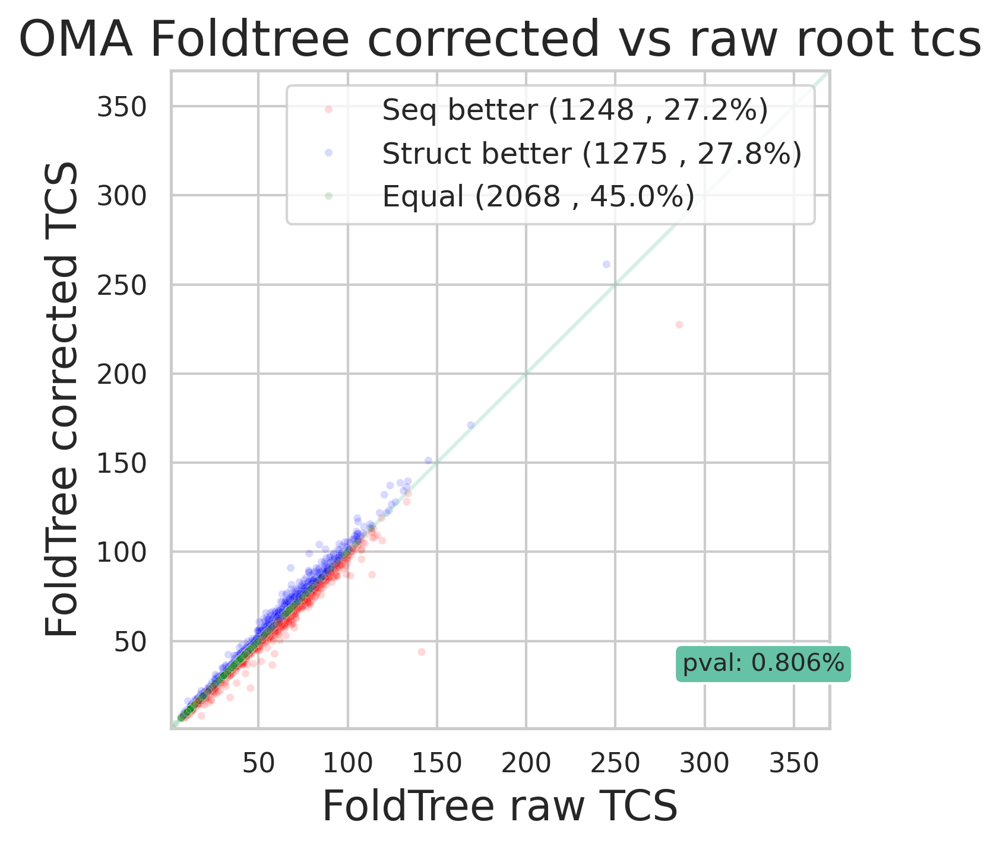

Wilcoxon Test Statistic: 1103625.5, P-value: 3.851507760259404e-07
Kolmogorov-Smirnov Test Statistic: 0.005009801786103245, P-value: 0.9999999948505648
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-2.3636363636363633, 6.609756097560975), mean=-0.004650385580639327, variance=0.09179541637729144, skewness=4.298192057127892, kurtosis=79.67463549796982)
total tcs diff -21.34992020071515
[<matplotlib.lines.Line2D object at 0x7fb8fd5fc470>, <matplotlib.lines.Line2D object at 0x7fb90ca4ce00>, <matplotlib.lines.Line2D object at 0x7fb90ca4ce90>] ['Struct better', 'Equal', 'Seq better']


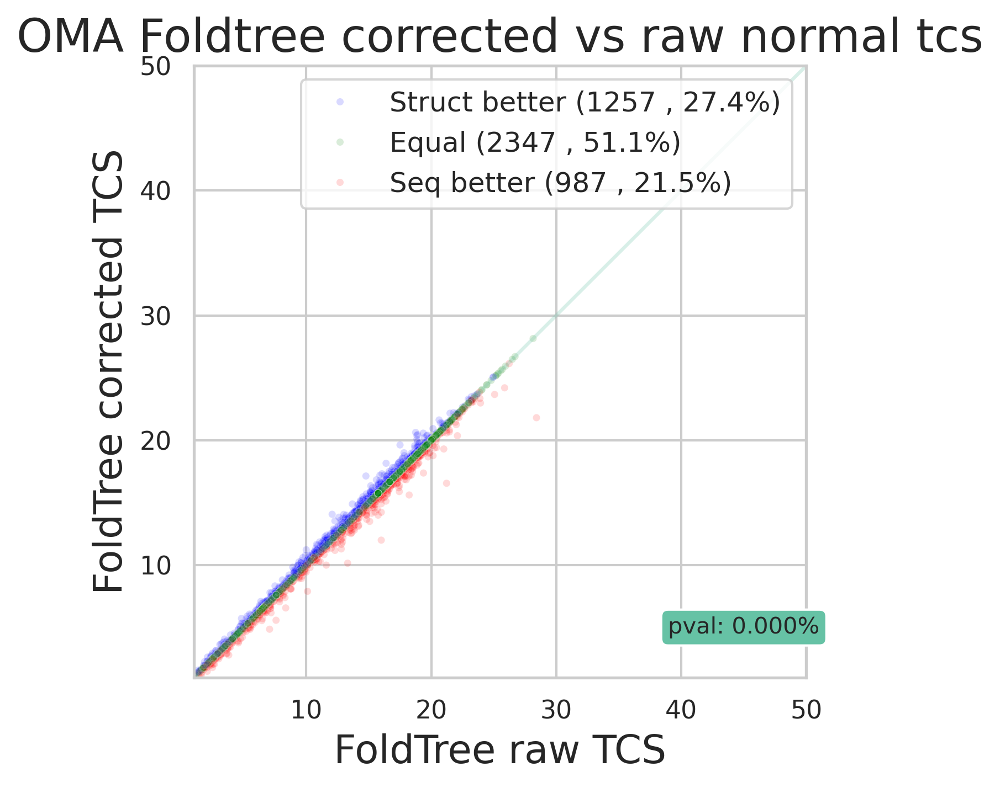

In [169]:
retgraph(  'fident_1_raw_struct_tree_norm' , 'fident_1_exp_struct_tree_norm' ,  unfiltereddf
         ,'FoldTree raw TCS' ,  'FoldTree corrected TCS',  'OMA Foldtree corrected vs raw root tcs')

retgraph(  'fident_1_raw_struct_tree_norm' , 'fident_1_exp_struct_tree_norm' ,  unfiltereddf_ntcs
         ,'FoldTree raw TCS' ,  'FoldTree corrected TCS',  'OMA Foldtree corrected vs raw normal tcs' , axlim = 50)

Wilcoxon Test Statistic: 2932980.5, P-value: 1.998285678602366e-29
Kolmogorov-Smirnov Test Statistic: 0.031154684095860568, P-value: 0.023232347747294026
Treescore delta statistics
DescribeResult(nobs=4590, minmax=(-51.70945945945945, 32.84615384615385), mean=-1.0982067237152988, variance=30.822473993605254, skewness=-2.191212955923766, kurtosis=13.478371437872436)
total tcs diff -5040.768861853221
[<matplotlib.lines.Line2D object at 0x7fb90ff9c470>, <matplotlib.lines.Line2D object at 0x7fb90c4fac00>, <matplotlib.lines.Line2D object at 0x7fb90c4f9a30>] ['Struct better', 'Seq better', 'Equal']


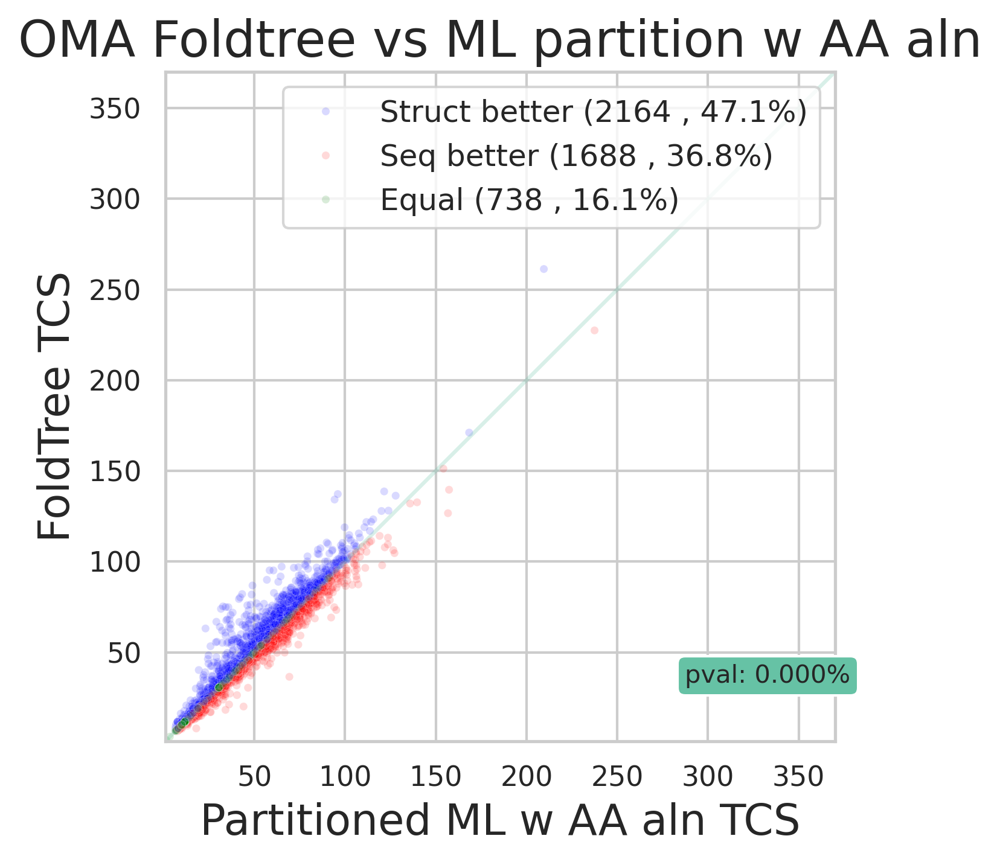

Wilcoxon Test Statistic: 1227310.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.12263123502504901, P-value: 1.7555732901892054e-30
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-40.6, 70.33333333333333), mean=5.273713970337873, variance=76.40665563195621, skewness=1.3300950854304678, kurtosis=5.712488739181978)
total tcs diff 24211.620837821174
[<matplotlib.lines.Line2D object at 0x7fb90ff9dd00>, <matplotlib.lines.Line2D object at 0x7fb90c94ec60>, <matplotlib.lines.Line2D object at 0x7fb90c4fba70>] ['Struct better', 'Seq better', 'Equal']


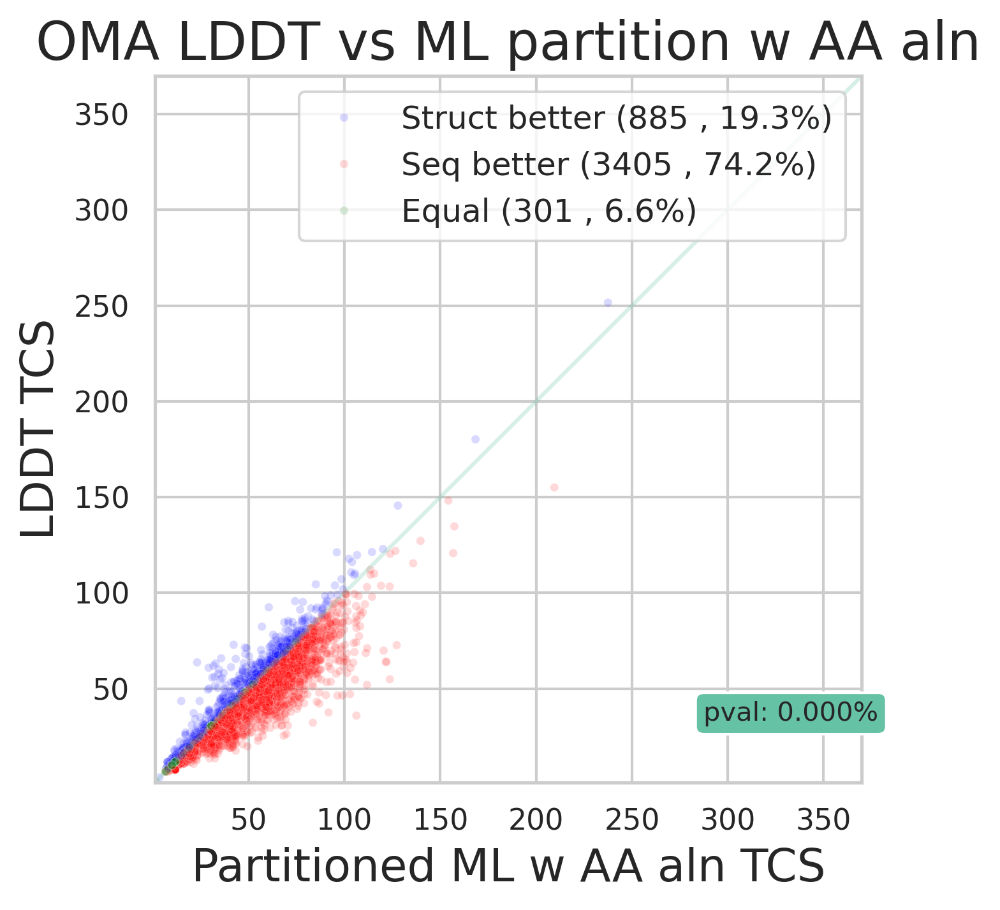

Wilcoxon Test Statistic: 280202.0, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.28736383442265795, P-value: 2.311908299801271e-167
Treescore delta statistics
DescribeResult(nobs=4590, minmax=(-54.576923076923066, 89.34567901234567), mean=12.795997309585184, variance=155.5461274920729, skewness=0.9592992249901583, kurtosis=1.5461386372390349)
total tcs diff 58733.62765099599
[<matplotlib.lines.Line2D object at 0x7fb90c8fcc50>, <matplotlib.lines.Line2D object at 0x7fb90c8fd970>, <matplotlib.lines.Line2D object at 0x7fb90c840500>] ['Seq better', 'Struct better', 'Equal']


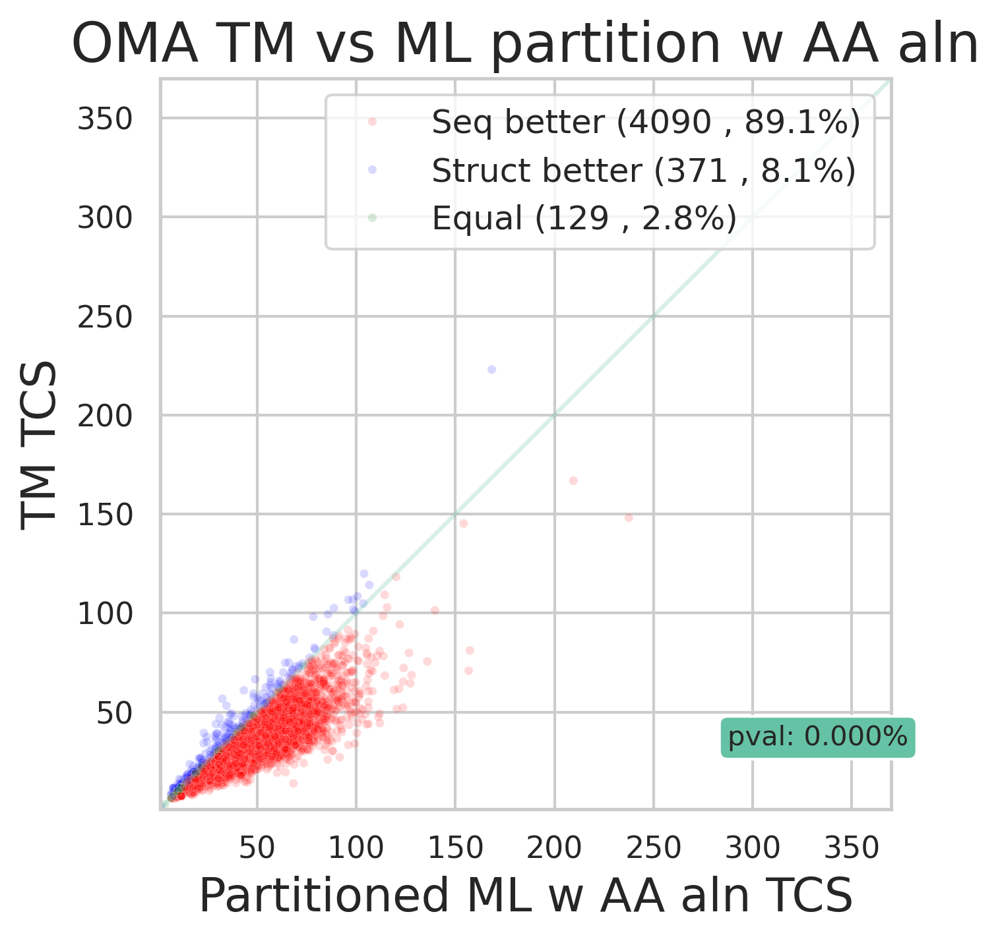

In [170]:
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,  unfiltereddf
         ,'Partitioned ML w AA aln TCS' ,  'FoldTree TCS',  'OMA Foldtree vs ML partition w AA aln')
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'lddt_1_exp_struct_tree_norm' ,  unfiltereddf
         ,'Partitioned ML w AA aln TCS' ,  'LDDT TCS',  'OMA LDDT vs ML partition w AA aln')
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'alntmscore_1_exp_struct_tree_norm' ,  unfiltereddf
         ,'Partitioned ML w AA aln TCS' ,  'TM TCS',  'OMA TM vs ML partition w AA aln')

Wilcoxon Test Statistic: 2335979.5, P-value: 4.382413289236742e-41
Kolmogorov-Smirnov Test Statistic: 0.0289760348583878, P-value: 0.04239205014479045
Treescore delta statistics
DescribeResult(nobs=4590, minmax=(-9.5, 5.307692307692308), mean=-0.18174926852899248, variance=0.6805053894201984, skewness=-2.6363879695876467, kurtosis=19.464508534713037)
total tcs diff -834.2291425480755
[<matplotlib.lines.Line2D object at 0x7fb90ddb4470>, <matplotlib.lines.Line2D object at 0x7fb90c7e1730>, <matplotlib.lines.Line2D object at 0x7fb90c7e1940>] ['Struct better', 'Seq better', 'Equal']


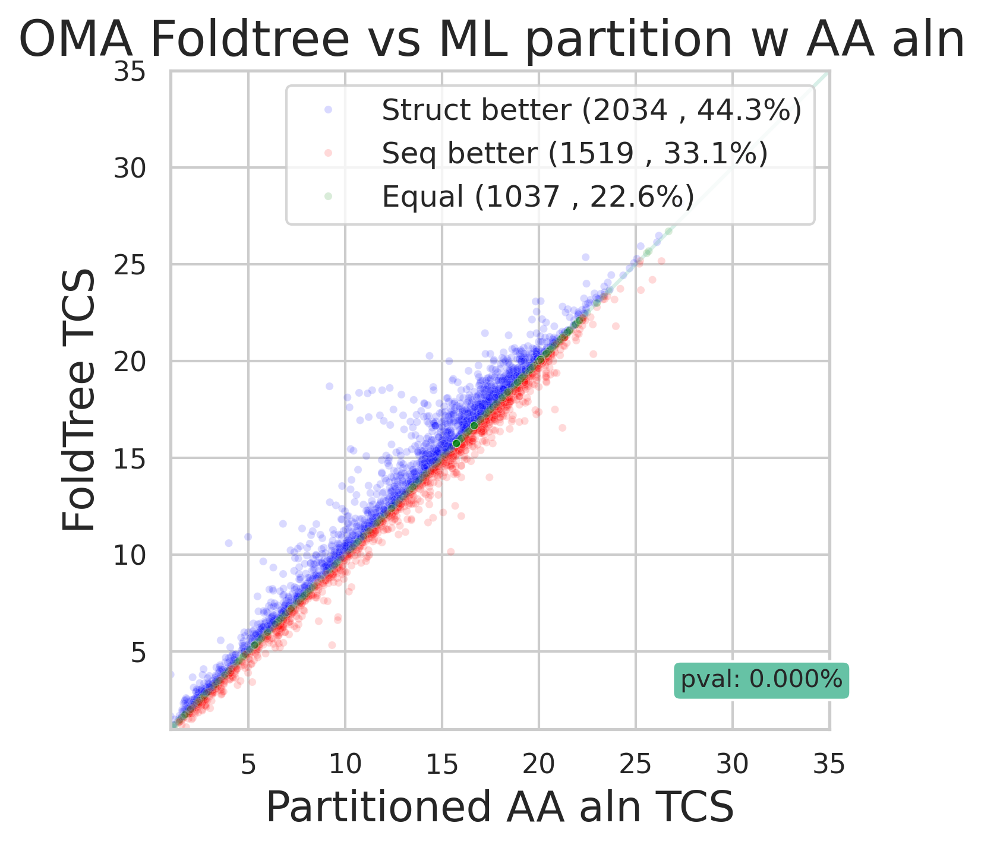

Wilcoxon Test Statistic: 237643.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.19734262687867568, P-value: 1.4095561251492491e-78
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-12.0, 5.0), mean=-1.8051037918723294, variance=3.147008139184604, skewness=-1.0001404495162924, kurtosis=1.2676922286069487)
total tcs diff -8287.231508485864
[<matplotlib.lines.Line2D object at 0x7fb90c7f4470>, <matplotlib.lines.Line2D object at 0x7fb90cb6cd40>, <matplotlib.lines.Line2D object at 0x7fb90cb6c6b0>] ['Struct better', 'Seq better', 'Equal']


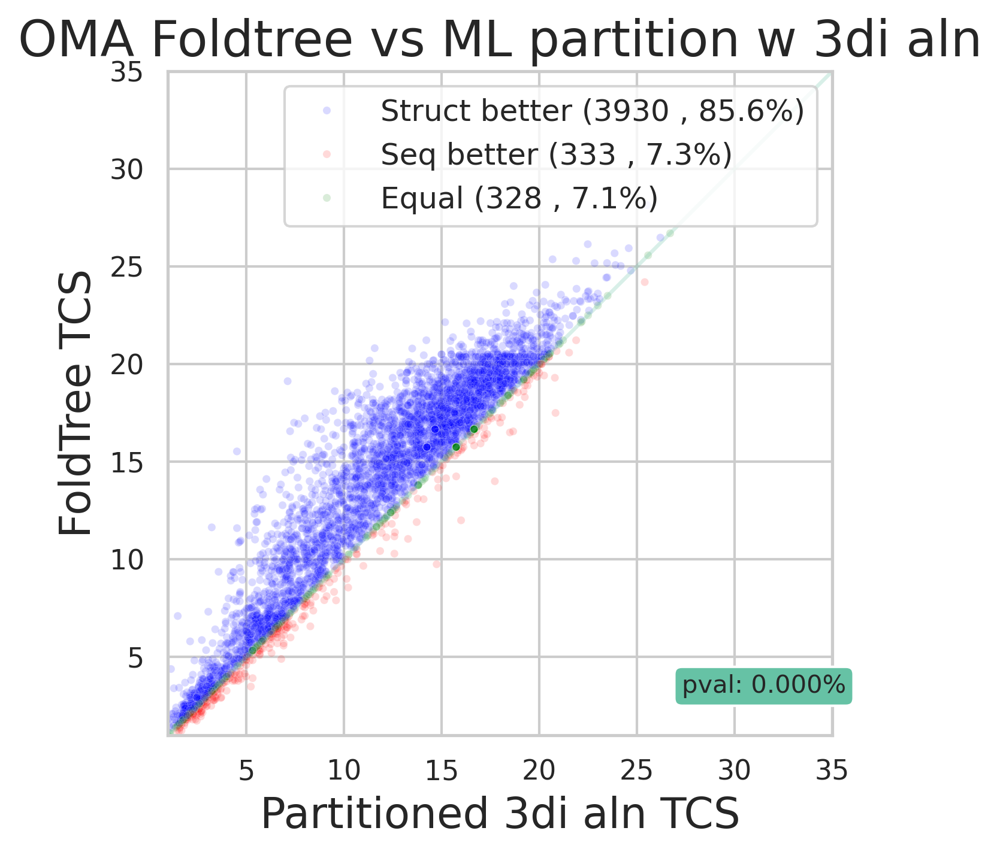

In [171]:
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,  unfiltereddf_ntcs
         ,'Partitioned AA aln TCS' ,  'FoldTree TCS',  'OMA Foldtree vs ML partition w AA aln ' , axlim = 35)

retgraph(  'templateX3di.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' ,  unfiltereddf_ntcs
         ,'Partitioned 3di aln TCS' ,  'FoldTree TCS',  'OMA Foldtree vs ML partition w 3di aln'  , axlim = 35 )


Wilcoxon Test Statistic: 3190916.0, P-value: 1.9648119412861933e-13
Kolmogorov-Smirnov Test Statistic: 0.034023991275899675, P-value: 0.009901777302357579
Treescore delta statistics
DescribeResult(nobs=4585, minmax=(-69.69230769230768, 31.999999999999993), mean=-1.0742024708318831, variance=38.98174928187208, skewness=-2.774788885059589, kurtosis=17.481316243745454)
total tcs diff -4925.218328764184
[<matplotlib.lines.Line2D object at 0x7fb90cc44470>, <matplotlib.lines.Line2D object at 0x7fb90cbbf080>, <matplotlib.lines.Line2D object at 0x7fb90cbbf260>] ['Struct better', 'Seq better', 'Equal']


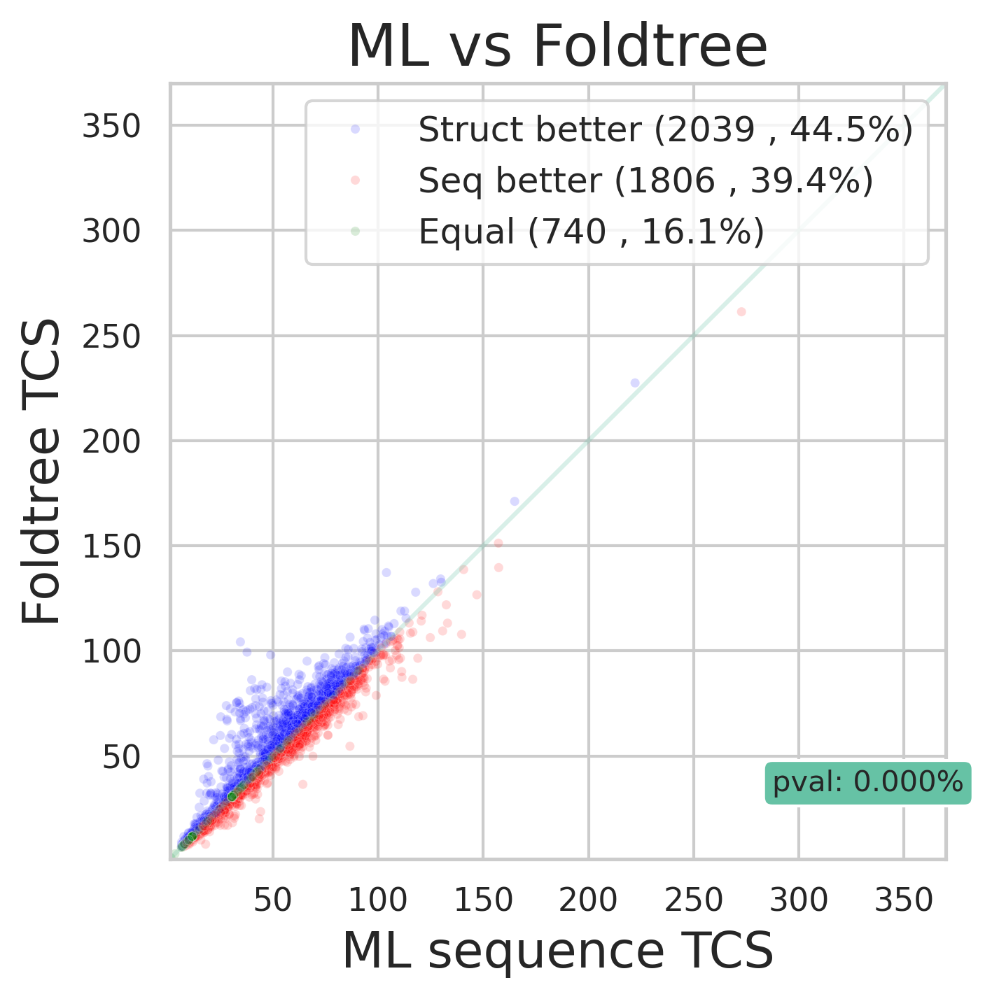

Wilcoxon Test Statistic: 3287515.5, P-value: 3.8045221216857237e-13
Kolmogorov-Smirnov Test Statistic: 0.03554295682511993, P-value: 0.006090998545593907
Treescore delta statistics
DescribeResult(nobs=4586, minmax=(-89.99999999999999, 33.99999999999999), mean=-1.1112202824096158, variance=42.977288261221496, skewness=-3.246491019067525, kurtosis=23.948454624123222)
total tcs diff -5096.0562151304985
[<matplotlib.lines.Line2D object at 0x7fb90ca14c50>, <matplotlib.lines.Line2D object at 0x7fb90c960ce0>, <matplotlib.lines.Line2D object at 0x7fb90c963950>] ['Struct better', 'Seq better', 'Equal']


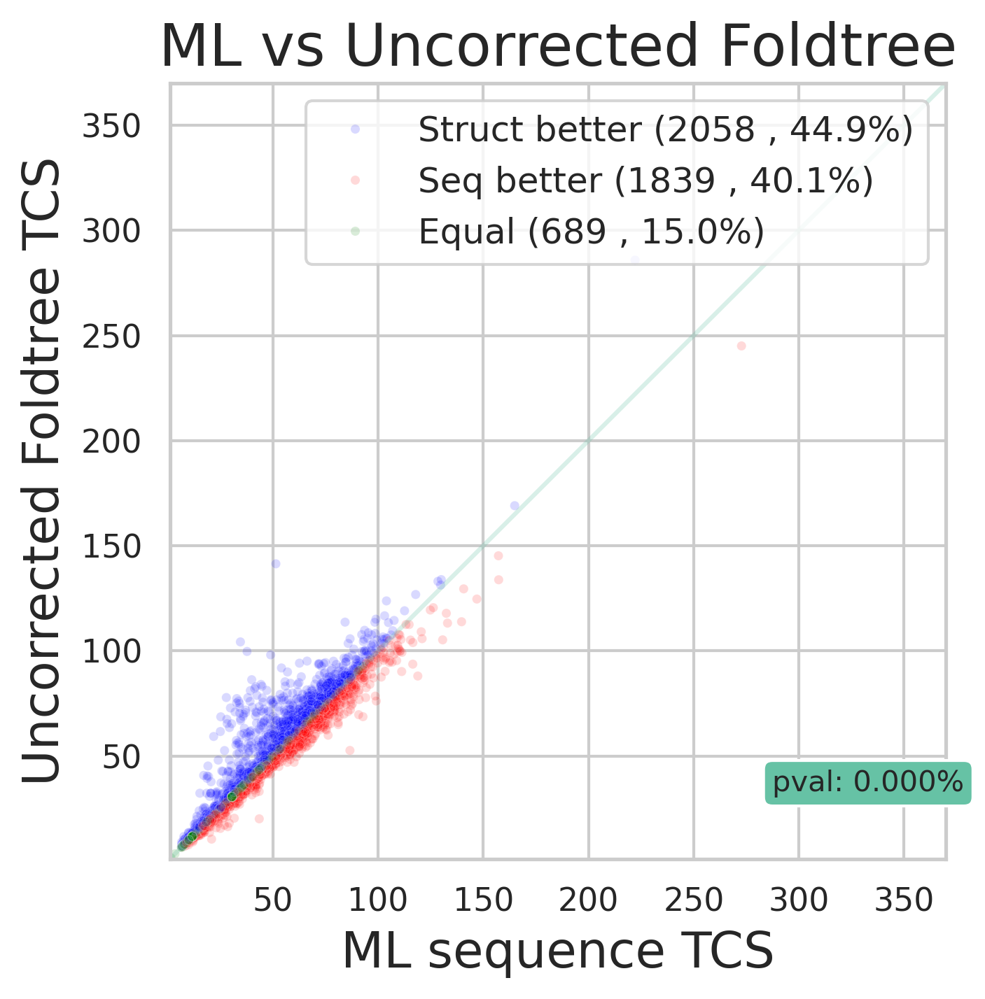

Wilcoxon Test Statistic: 1347361.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.11687745311818579, P-value: 1.0833879883676417e-27
Treescore delta statistics
DescribeResult(nobs=4586, minmax=(-53.07692307692307, 117.71621621621622), mean=5.298182197957209, variance=95.182979386561, skewness=1.2191634743558752, kurtosis=9.5654877191154)
total tcs diff 24297.463559831758
[<matplotlib.lines.Line2D object at 0x7fb90c089f70>, <matplotlib.lines.Line2D object at 0x7fb90c08a0f0>, <matplotlib.lines.Line2D object at 0x7fb90c08a2d0>] ['Struct better', 'Seq better', 'Equal']


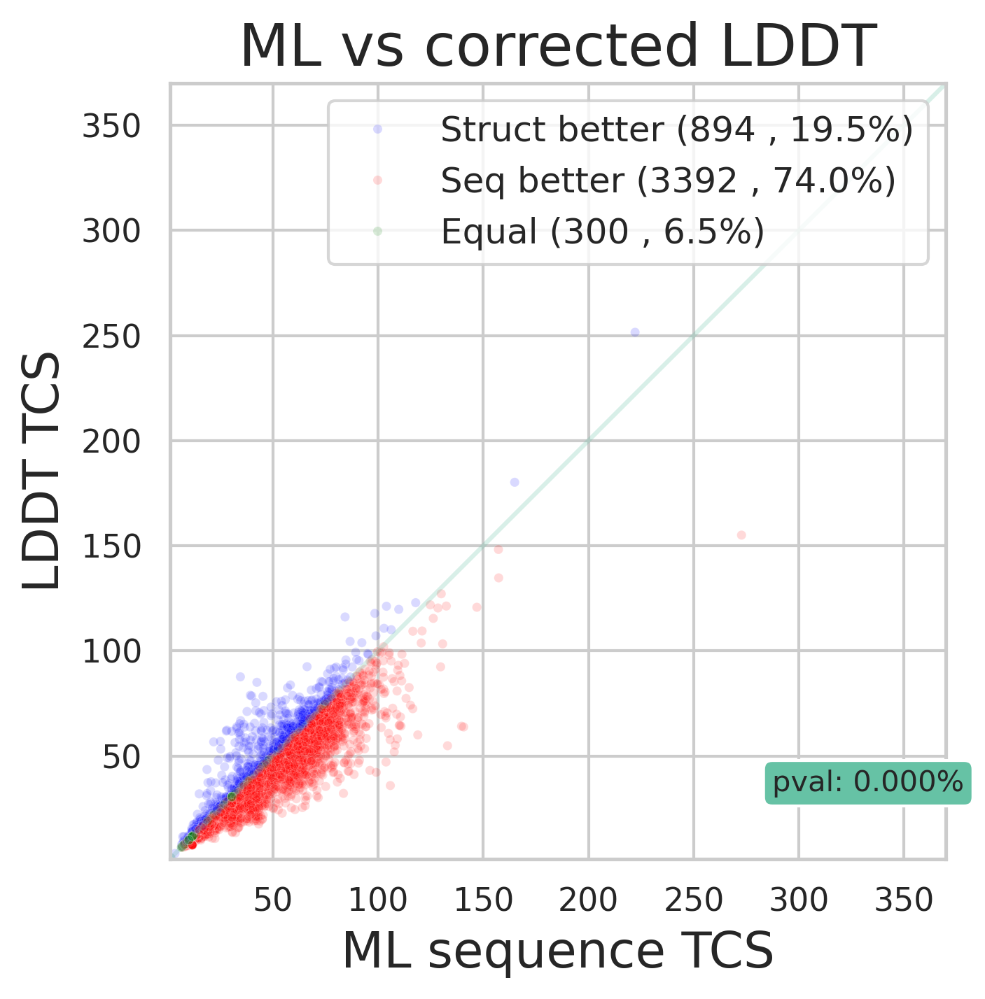

Wilcoxon Test Statistic: 1363226.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.11447884866986481, P-value: 1.3959720822800795e-26
Treescore delta statistics
DescribeResult(nobs=4586, minmax=(-53.07692307692307, 150.91216216216216), mean=5.212048484365436, variance=94.9181224960063, skewness=1.451133166153432, kurtosis=15.736357267230094)
total tcs diff 23902.45434929989
[<matplotlib.lines.Line2D object at 0x7fb90c1124e0>, <matplotlib.lines.Line2D object at 0x7fb90c112990>, <matplotlib.lines.Line2D object at 0x7fb90c112ba0>] ['Struct better', 'Seq better', 'Equal']


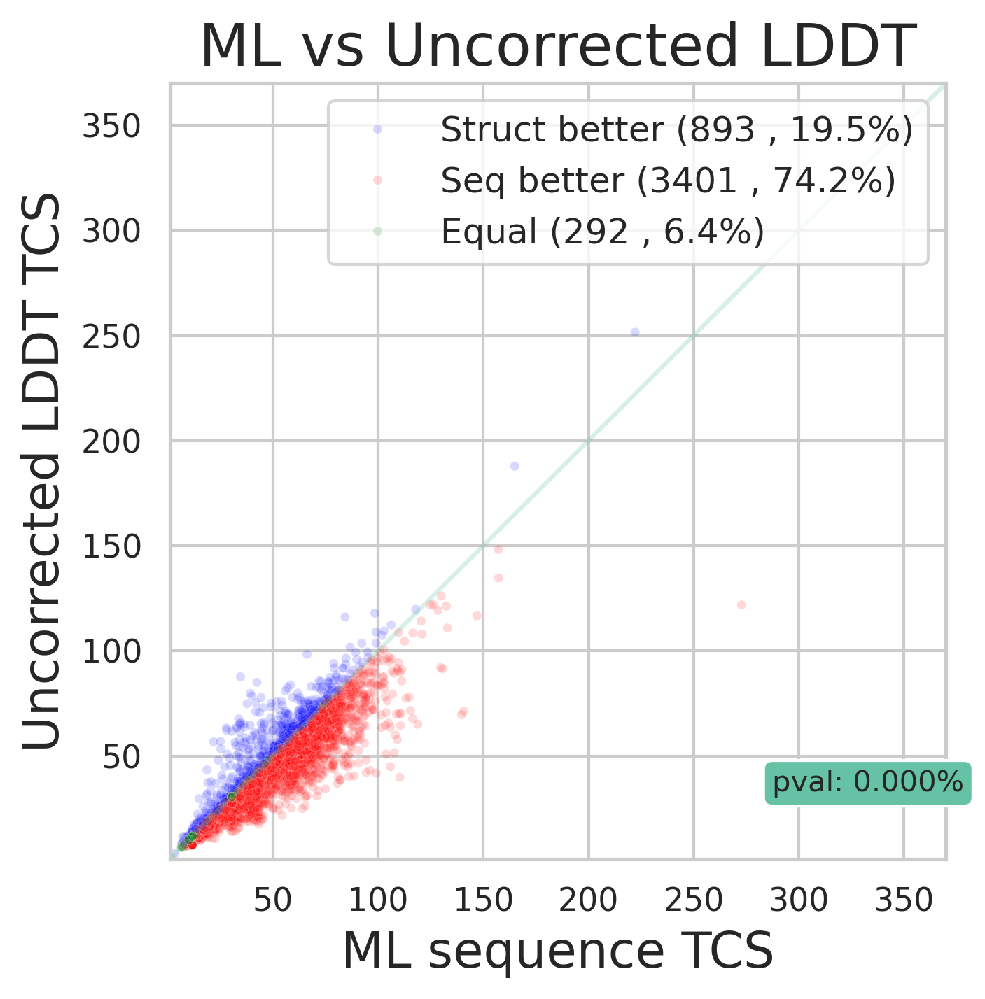

Wilcoxon Test Statistic: 393269.0, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.27938931297709924, P-value: 6.27510652652057e-158
Treescore delta statistics
DescribeResult(nobs=4585, minmax=(-58.05263157894734, 105.93243243243242), mean=12.796997816756082, variance=172.1599453340393, skewness=0.8835332263118687, kurtosis=1.9440886162866038)
total tcs diff 58674.23498982664
[<matplotlib.lines.Line2D object at 0x7fb90ccd5d00>, <matplotlib.lines.Line2D object at 0x7fb90c98ade0>, <matplotlib.lines.Line2D object at 0x7fb90cc9f470>] ['Struct better', 'Seq better', 'Equal']


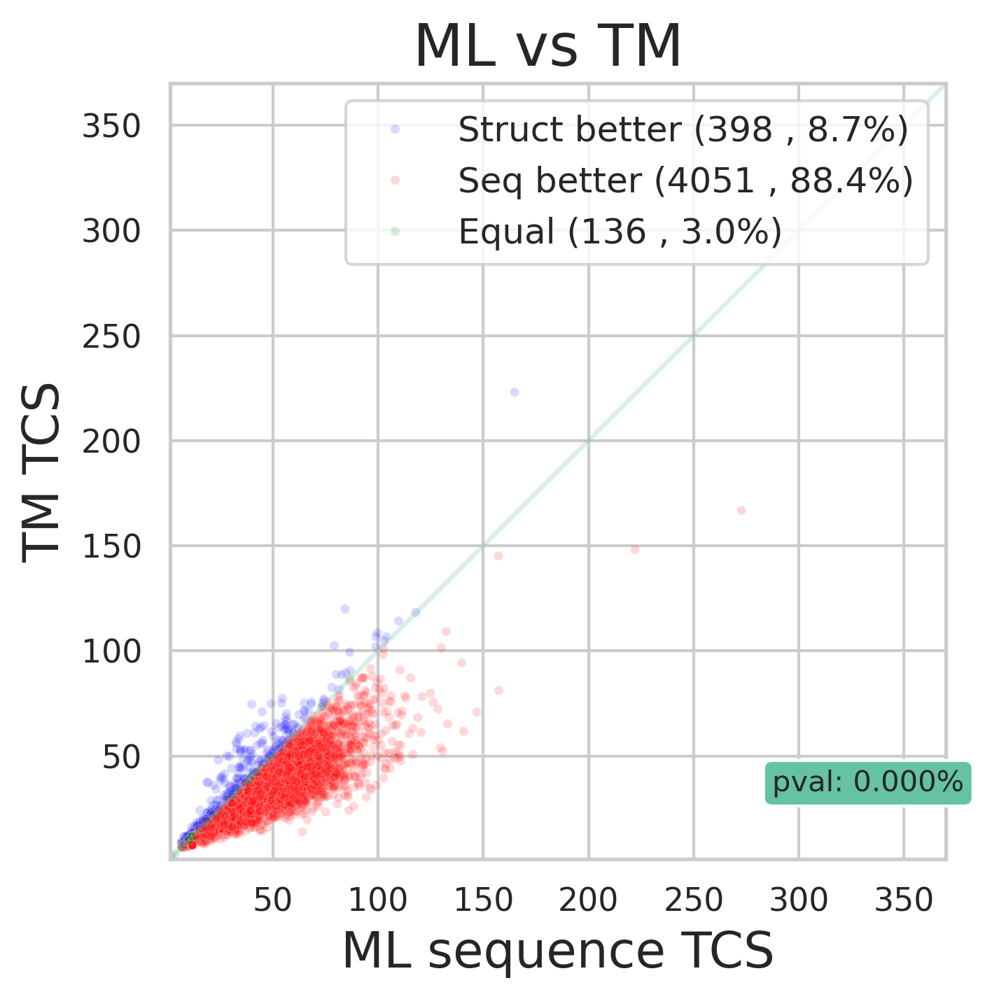

Wilcoxon Test Statistic: 424706.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.2730643402399128, P-value: 8.714914559078497e-151
Treescore delta statistics
DescribeResult(nobs=4585, minmax=(-43.0625, 140.75675675675674), mean=12.50413317431564, variance=171.6866546255788, skewness=1.0368052716819023, kurtosis=3.4978906701609205)
total tcs diff 57331.450604237216
[<matplotlib.lines.Line2D object at 0x7fb90ccd4470>, <matplotlib.lines.Line2D object at 0x7fb90ff4b350>, <matplotlib.lines.Line2D object at 0x7fb90ff4b560>] ['Struct better', 'Seq better', 'Equal']


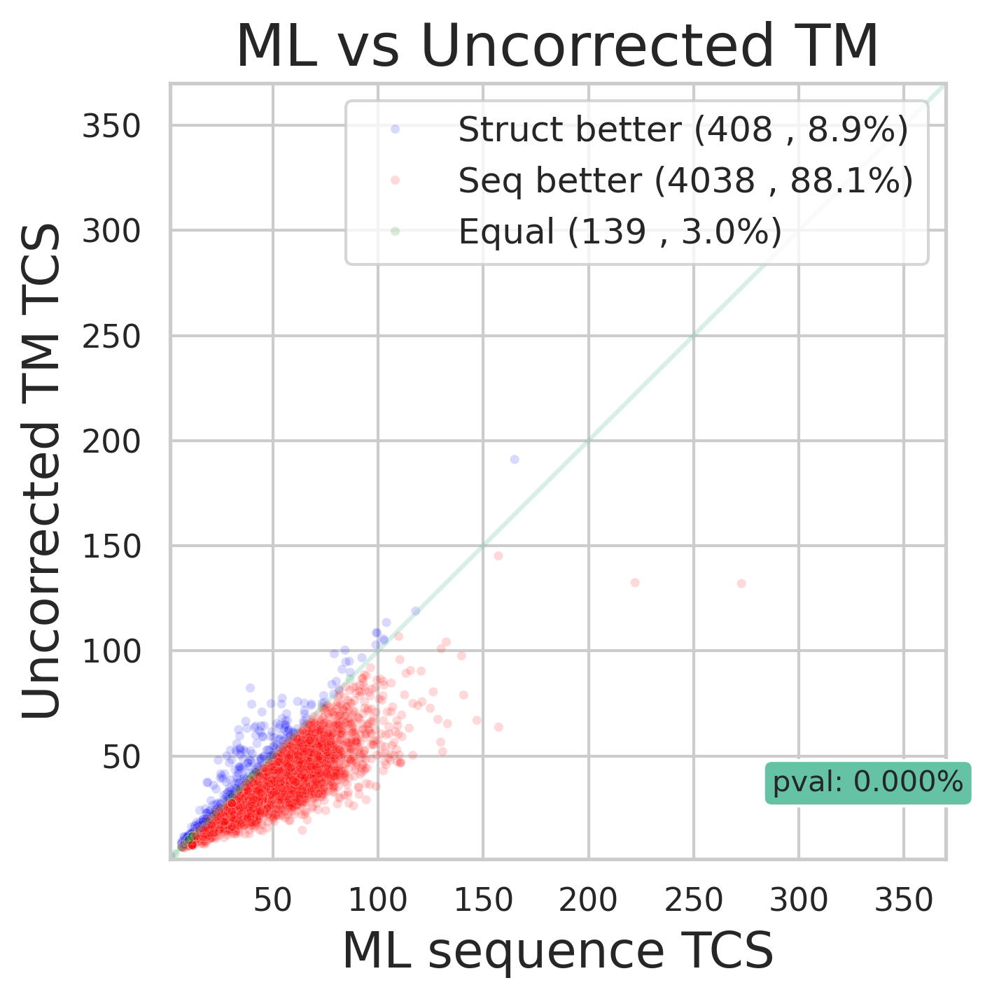

In [172]:
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' , unfiltereddf 
         ,'ML sequence TCS' ,  'Foldtree TCS',  'ML vs Foldtree')

retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_raw_struct_tree_norm' , unfiltereddf 
         ,'ML sequence TCS' ,  'Uncorrected Foldtree TCS',  'ML vs Uncorrected Foldtree')


retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'lddt_1_exp_struct_tree_norm' , unfiltereddf 
         ,'ML sequence TCS' ,  'LDDT TCS',  'ML vs corrected LDDT')

retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'lddt_1_raw_struct_tree_norm' , unfiltereddf 
         ,'ML sequence TCS' ,  'Uncorrected LDDT TCS',  'ML vs Uncorrected LDDT')


retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'alntmscore_1_exp_struct_tree_norm' , unfiltereddf 
         ,'ML sequence TCS' ,  'TM TCS',  'ML vs TM ')

retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'alntmscore_1_raw_struct_tree_norm' , unfiltereddf 
         ,'ML sequence TCS' ,  'Uncorrected TM TCS',  'ML vs Uncorrected TM')



#retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' , unfiltereddf_ntcs 
#         ,'sequence TCS' ,  'Foldtree TCS',  'Sequence vs Foldtree UnFiltered : tcs' , axlim = 35)


Wilcoxon Test Statistic: 226975.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.27793509039424963, P-value: 1.7829851856476205e-156
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-111.67901234567901, 20.45833333333333), mean=-13.02798737487489, variance=166.58092024897488, skewness=-1.2106153514066558, kurtosis=2.5381297721313443)
total tcs diff -59811.49003805062
[<matplotlib.lines.Line2D object at 0x7fb90ff46900>, <matplotlib.lines.Line2D object at 0x7fb90ff47530>, <matplotlib.lines.Line2D object at 0x7fb90ff444d0>] ['Struct better', 'Seq better', 'Equal']


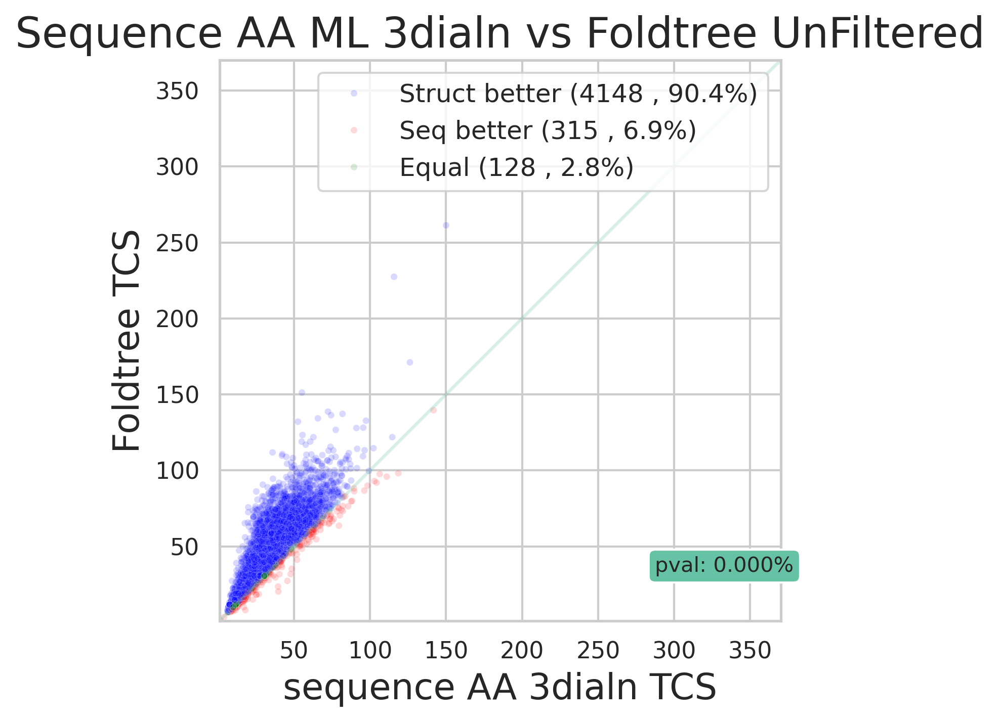

In [173]:
retgraph(  'alnAA_3di.fasta.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' , unfiltereddf 
         ,'sequence AA 3dialn TCS' ,  'Foldtree TCS',  'Sequence AA ML 3dialn vs Foldtree UnFiltered')

Wilcoxon Test Statistic: 2655312.5, P-value: 1.2710862790301306e-05
Kolmogorov-Smirnov Test Statistic: 0.01306904813766064, P-value: 0.8279310379886967
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-28.914893617021264, 122.6829268292683), mean=0.2326900343635576, variance=14.41665583225735, skewness=8.025992599338274, kurtosis=247.08509166722718)
total tcs diff 1068.2799477630929
[<matplotlib.lines.Line2D object at 0x7fb90ff29c70>, <matplotlib.lines.Line2D object at 0x7fb90cf81010>, <matplotlib.lines.Line2D object at 0x7fb90cf811f0>] ['Seq better', 'Struct better', 'Equal']


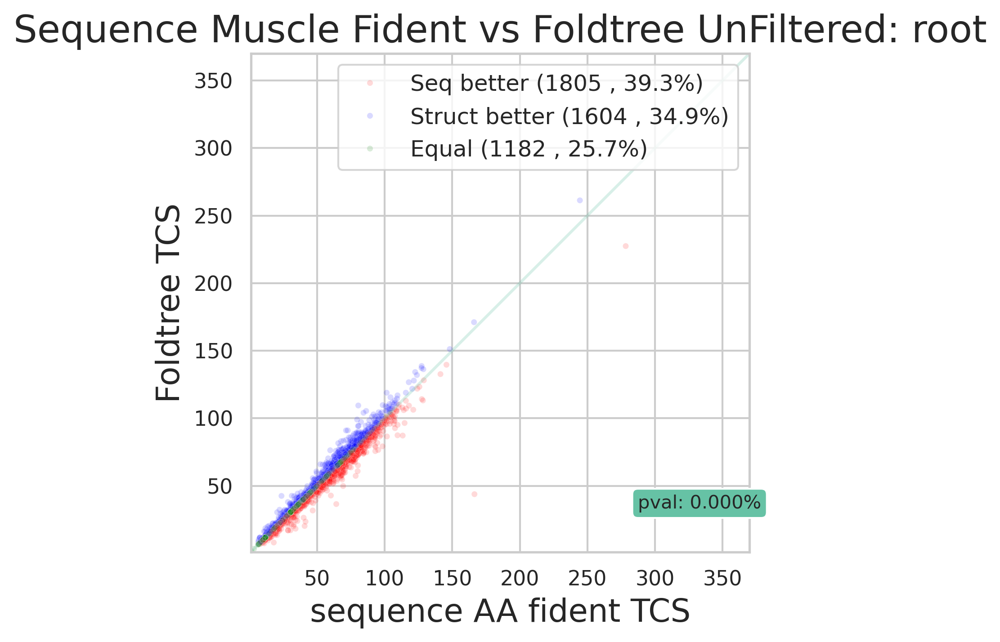

Wilcoxon Test Statistic: 2386888.5, P-value: 0.011206648304671161
Kolmogorov-Smirnov Test Statistic: 0.007841428882596384, P-value: 0.9989357064112188
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-4.400000000000002, 6.560975609756099), mean=-0.0006921868017130818, variance=0.2191345845155735, skewness=1.7750485871728647, kurtosis=26.181017972383646)
total tcs diff -3.1778296066647584
[<matplotlib.lines.Line2D object at 0x7fb90cf69c70>, <matplotlib.lines.Line2D object at 0x7fb90cfc4920>, <matplotlib.lines.Line2D object at 0x7fb90cfc79b0>] ['Seq better', 'Struct better', 'Equal']


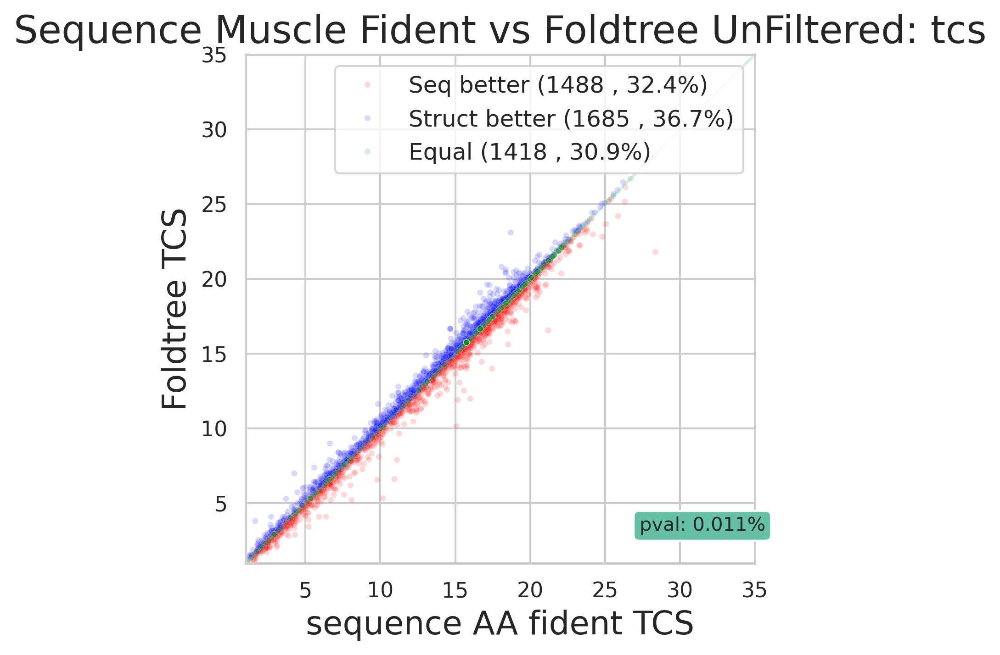

In [174]:
retgraph(  'AA_xaln_tree_norm' , 'fident_1_exp_struct_tree_norm' , unfiltereddf 
         ,'sequence AA fident TCS' ,  'Foldtree TCS',  'Sequence Muscle Fident vs Foldtree UnFiltered: root')

retgraph(  'AA_xaln_tree_norm' , 'fident_1_exp_struct_tree_norm' , unfiltereddf_ntcs
         ,'sequence AA fident TCS' ,  'Foldtree TCS',  'Sequence Muscle Fident vs Foldtree UnFiltered: tcs' , axlim = 35)


Wilcoxon Test Statistic: 424528.0, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.19407536484426052, P-value: 5.394862323081519e-76
Treescore delta statistics
DescribeResult(nobs=4591, minmax=(-148.97530864197532, 26.115384615384613), mean=-8.88571878727288, variance=102.3086223432504, skewness=-2.103583019670163, kurtosis=14.402878245373408)
total tcs diff -40794.3349523698
[<matplotlib.lines.Line2D object at 0x7fb9107735f0>, <matplotlib.lines.Line2D object at 0x7fb91083b470>, <matplotlib.lines.Line2D object at 0x7fb91083b680>] ['Struct better', 'Seq better', 'Equal']


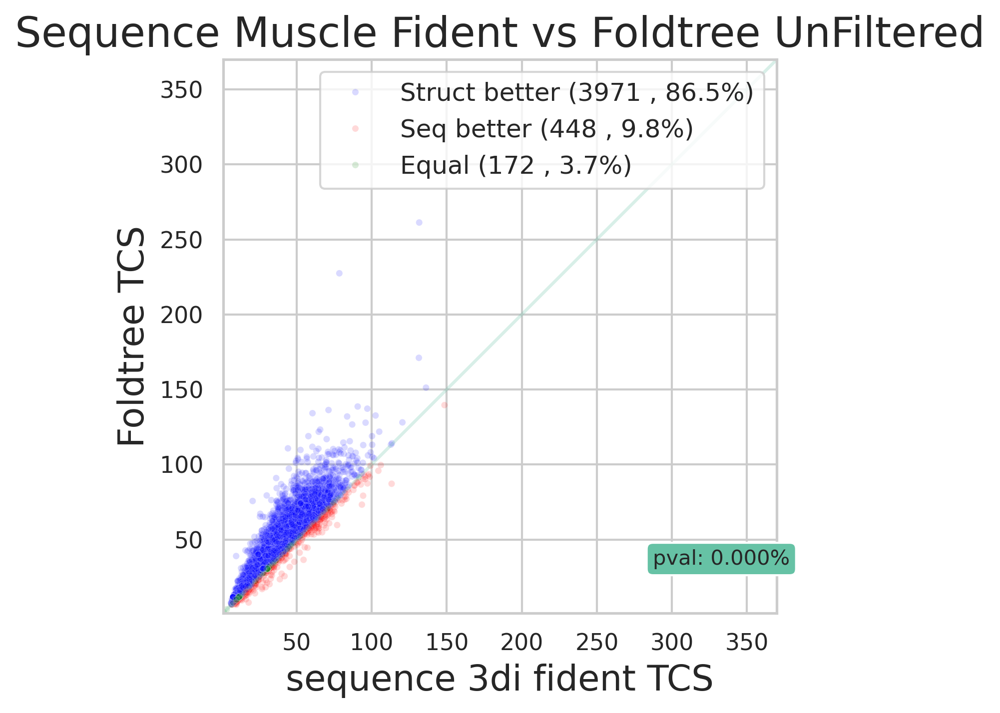

In [175]:
retgraph(  '3di_xaln_tree_norm' , 'fident_1_exp_struct_tree_norm' , unfiltereddf 
         ,'sequence 3di fident TCS' ,  'Foldtree TCS',  'Sequence Muscle Fident vs Foldtree UnFiltered')

Wilcoxon Test Statistic: 1363226.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.11447884866986481, P-value: 1.3959720822800795e-26
Treescore delta statistics
DescribeResult(nobs=4586, minmax=(-53.07692307692307, 150.91216216216216), mean=5.212048484365436, variance=94.9181224960063, skewness=1.451133166153432, kurtosis=15.736357267230094)
total tcs diff 23902.45434929989
[<matplotlib.lines.Line2D object at 0x7fb9055d9c70>, <matplotlib.lines.Line2D object at 0x7fb90c30f1a0>, <matplotlib.lines.Line2D object at 0x7fb90c30f3b0>] ['Struct better', 'Seq better', 'Equal']


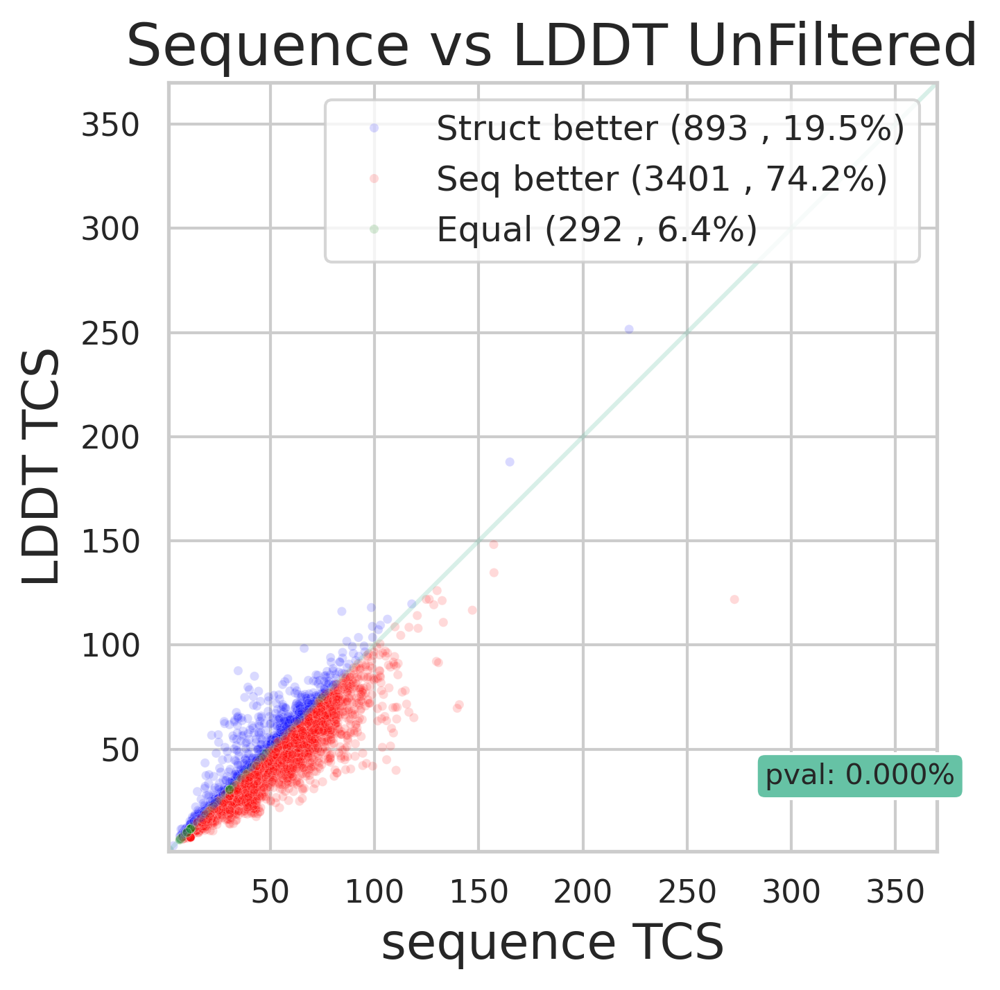

In [176]:
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'lddt_1_raw_struct_tree_norm' , unfiltereddf 
         ,'sequence TCS' ,  'LDDT TCS',  'Sequence vs LDDT UnFiltered')

Wilcoxon Test Statistic: 424706.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.2730643402399128, P-value: 8.714914559078497e-151
Treescore delta statistics
DescribeResult(nobs=4585, minmax=(-43.0625, 140.75675675675674), mean=12.50413317431564, variance=171.6866546255788, skewness=1.0368052716819023, kurtosis=3.4978906701609205)
total tcs diff 57331.450604237216
[<matplotlib.lines.Line2D object at 0x7fb9107ec470>, <matplotlib.lines.Line2D object at 0x7fb90c3172f0>, <matplotlib.lines.Line2D object at 0x7fb90c2ee270>] ['Struct better', 'Seq better', 'Equal']


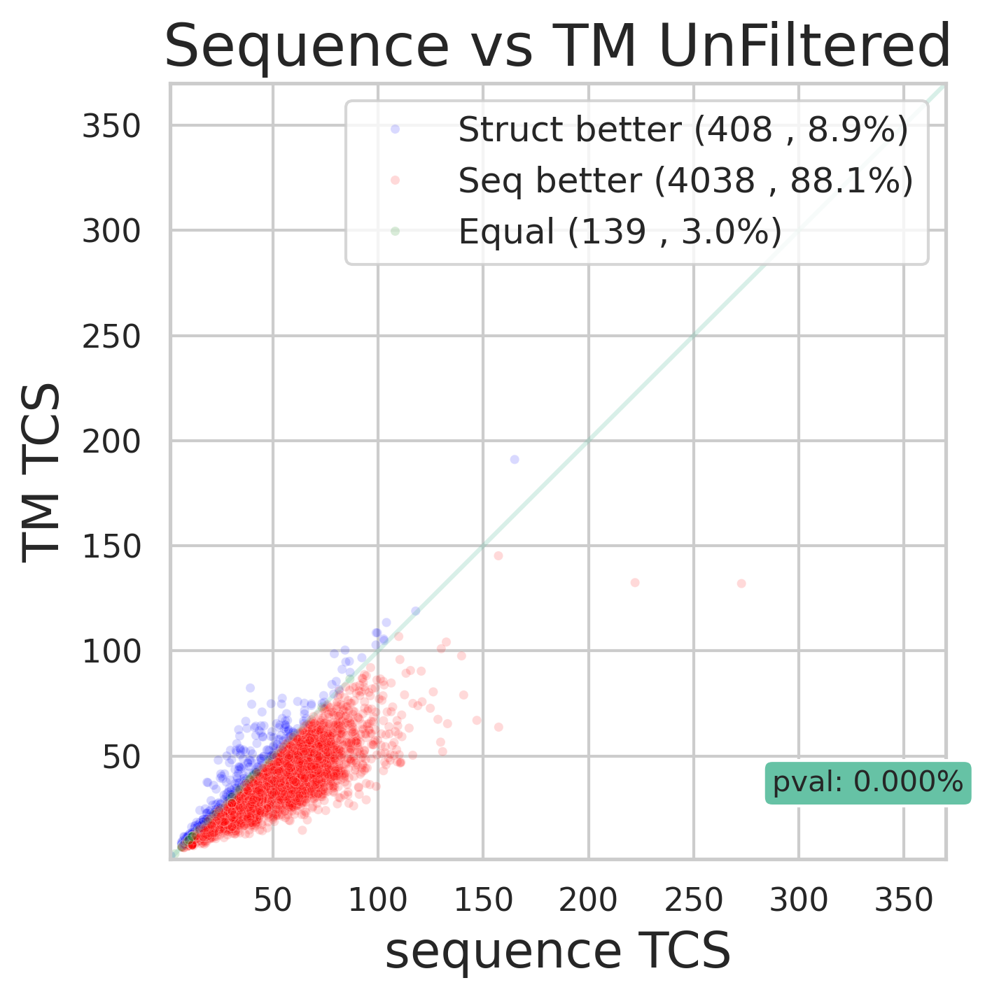

In [177]:
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'alntmscore_1_raw_struct_tree_norm' , unfiltereddf 
         ,'sequence TCS' ,  'TM TCS',  'Sequence vs TM UnFiltered')

Wilcoxon Test Statistic: 1127621.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.13827699018538714, P-value: 1.286450736708187e-38
Treescore delta statistics
DescribeResult(nobs=4585, minmax=(-61.38461538461538, 94.8581081081081), mean=6.344723172919414, variance=107.2403711816334, skewness=1.133054206918402, kurtosis=6.672433534719675)
total tcs diff 29090.555747835515
[<matplotlib.lines.Line2D object at 0x7fb90c2c0bf0>, <matplotlib.lines.Line2D object at 0x7fb90cad2750>, <matplotlib.lines.Line2D object at 0x7fb90cad2960>] ['Struct better', 'Seq better', 'Equal']


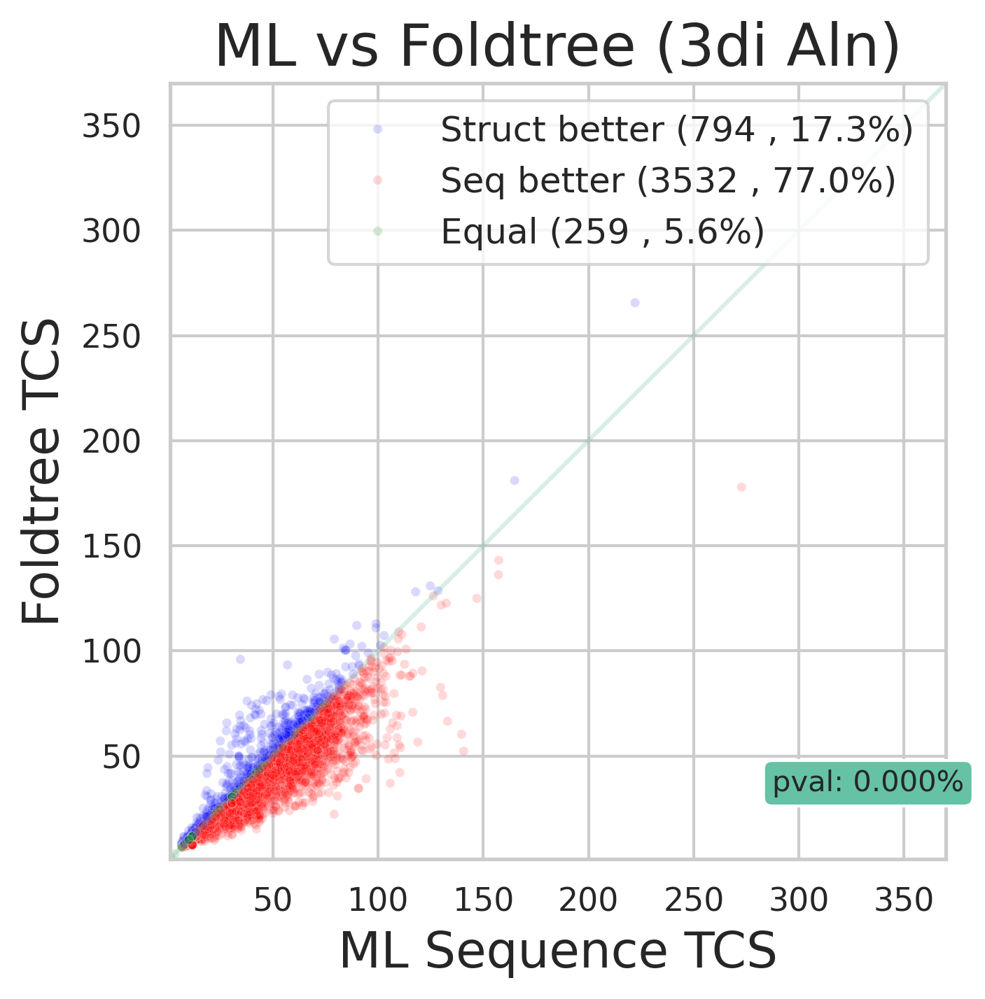

Wilcoxon Test Statistic: 1164091.5, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.13388573920627997, P-value: 3.133142877367474e-36
Treescore delta statistics
DescribeResult(nobs=4586, minmax=(-54.92307692307693, 153.83783783783784), mean=6.02342421242006, variance=102.87633909515354, skewness=1.4606258640064298, kurtosis=14.65506636811908)
total tcs diff 27623.423438158396
[<matplotlib.lines.Line2D object at 0x7fb90c279c70>, <matplotlib.lines.Line2D object at 0x7fb90cb03080>, <matplotlib.lines.Line2D object at 0x7fb90cb02d80>] ['Struct better', 'Seq better', 'Equal']


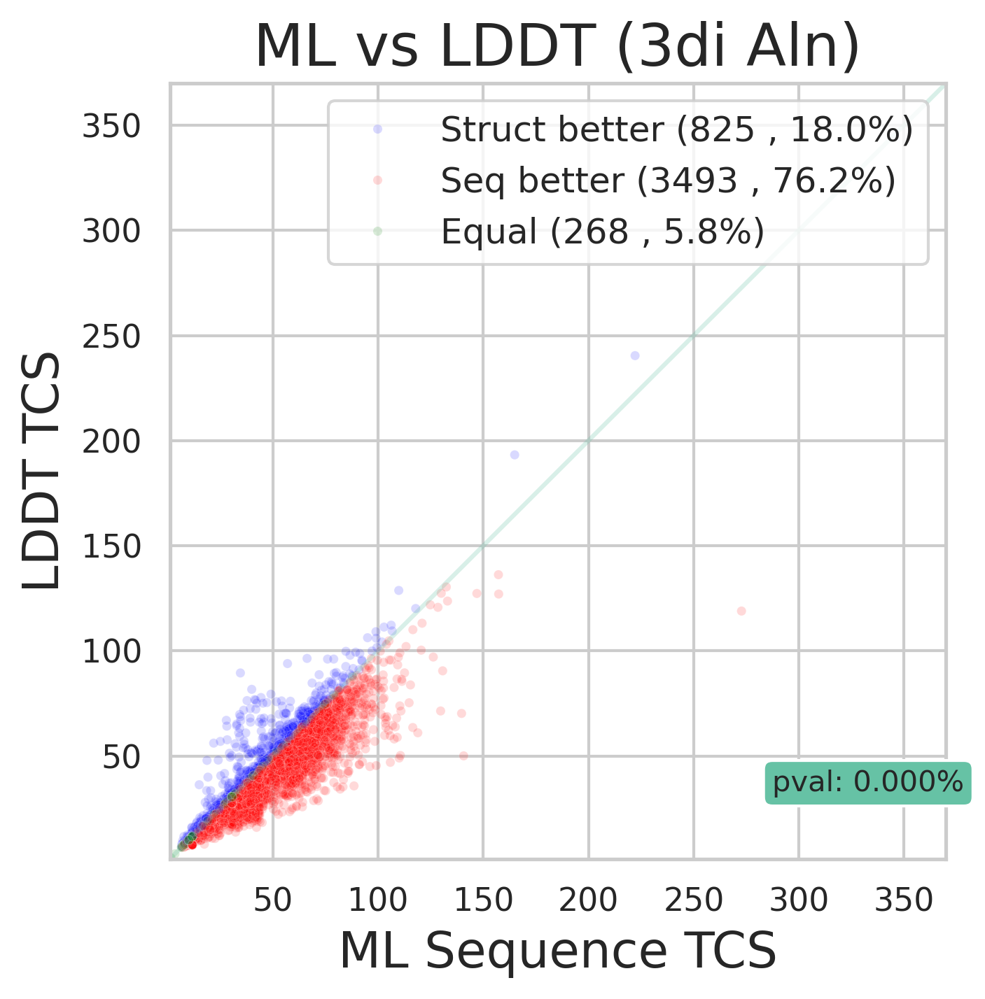

Wilcoxon Test Statistic: 357243.0, P-value: 0.0
Kolmogorov-Smirnov Test Statistic: 0.2848418756815703, P-value: 3.1733091268282415e-164
Treescore delta statistics
DescribeResult(nobs=4585, minmax=(-53.813765182186216, 128.4527027027027), mean=13.200451593746426, variance=178.20181185754058, skewness=0.9495920734032922, kurtosis=2.5368673585259245)
total tcs diff 60524.07055732736
[<matplotlib.lines.Line2D object at 0x7fb90c22c470>, <matplotlib.lines.Line2D object at 0x7fb90c1b9580>, <matplotlib.lines.Line2D object at 0x7fb90c1b9790>] ['Struct better', 'Seq better', 'Equal']


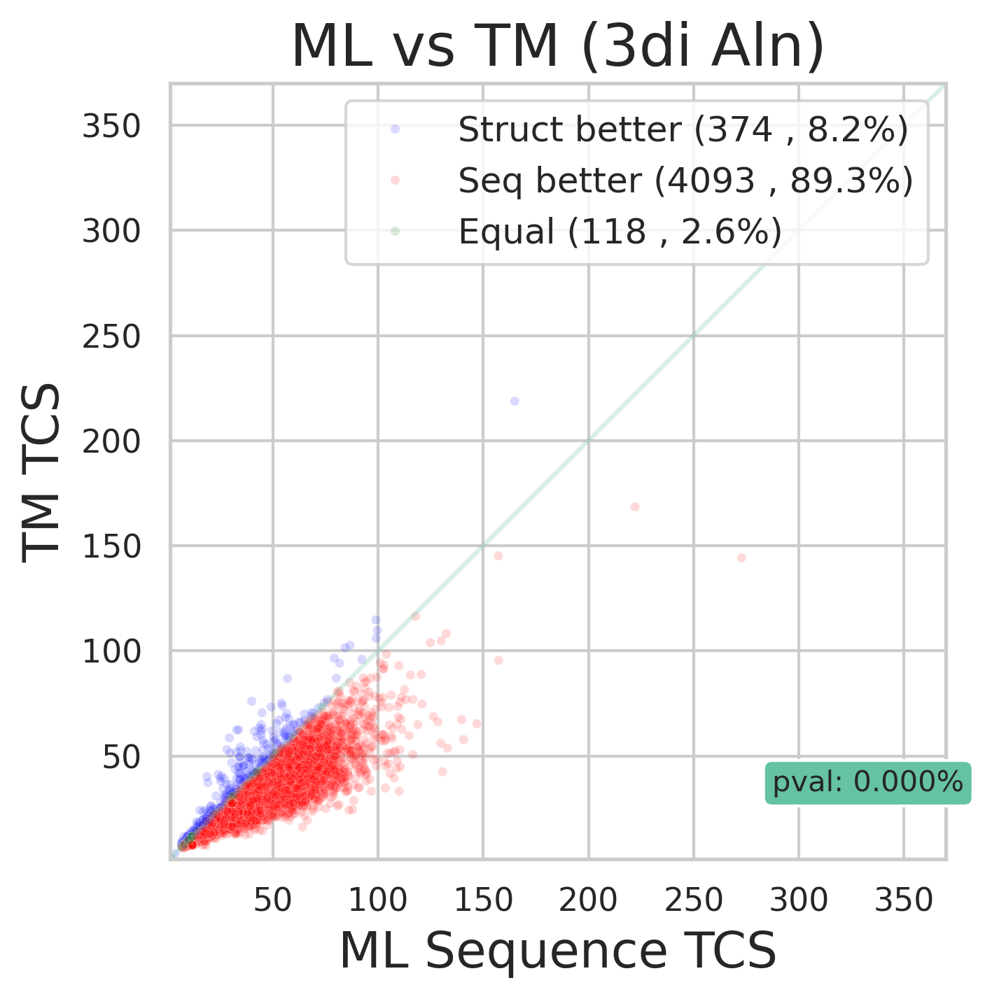

In [178]:
#species tree discordance for cat dataset
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_0_exp_struct_tree_norm' ,  unfiltereddf
         ,'ML Sequence TCS' ,  'Foldtree TCS',  'ML vs Foldtree (3di Aln)')
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'lddt_0_exp_struct_tree_norm' ,  unfiltereddf
         ,'ML Sequence TCS' ,  'LDDT TCS',  'ML vs LDDT (3di Aln)')
retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'alntmscore_0_exp_struct_tree_norm' ,  unfiltereddf
         ,'ML Sequence TCS' ,  'TM TCS',  'ML vs TM (3di Aln)')

['Opisthokonta' 'Dikarya' 'Bacteria' 'Tetrapoda' 'Chordata' 'Bilateria'
 'LUCA' 'Eukaryota' 'Eumetazoa' 'Euteleostomi' 'Fungi']
Wilcoxon Test Statistic: 38690.5, P-value: 1.3148085224697713e-07
Kolmogorov-Smirnov Test Statistic: 0.0973630831643002, P-value: 0.018630892034652447
Treescore delta statistics
DescribeResult(nobs=493, minmax=(-69.69230769230768, 30.03636363636363), mean=-2.332003441612847, variance=84.39401888677756, skewness=-2.2464907735559976, kurtosis=12.181935256649485)
total tcs diff -1149.6776967151336
[<matplotlib.lines.Line2D object at 0x7fb90c2c1c70>, <matplotlib.lines.Line2D object at 0x7fb90e239820>, <matplotlib.lines.Line2D object at 0x7fb90cb17c50>] ['Struct better', 'Seq better', 'Equal']


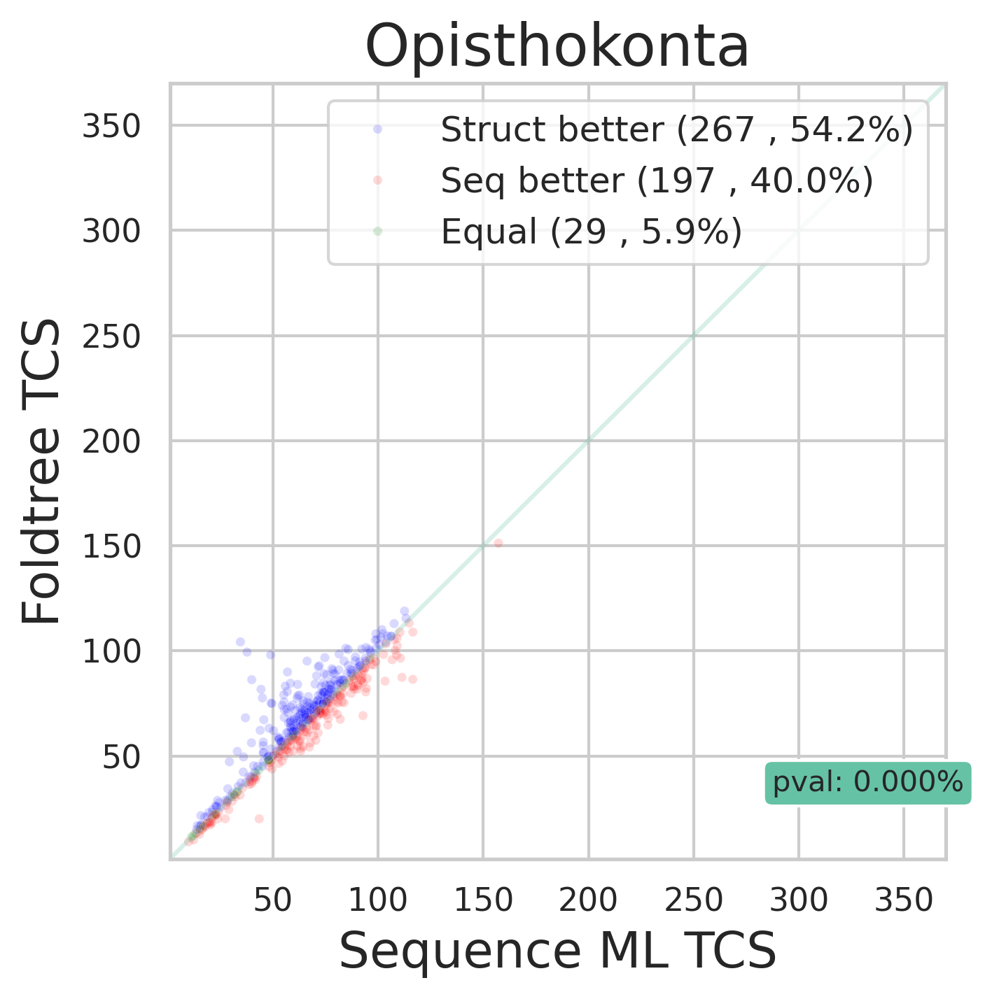

Wilcoxon Test Statistic: 4487.5, P-value: 0.9380417790737186
Kolmogorov-Smirnov Test Statistic: 0.043478260869565216, P-value: 0.9952309862794978
Treescore delta statistics
DescribeResult(nobs=184, minmax=(-6.518518518518519, 7.692307692307693), mean=-0.016769466731945994, variance=2.6285961190949503, skewness=-0.0015652845124253282, kurtosis=5.2482169247109525)
total tcs diff -3.085581878678063
[<matplotlib.lines.Line2D object at 0x7fb91036aff0>, <matplotlib.lines.Line2D object at 0x7fb910457530>, <matplotlib.lines.Line2D object at 0x7fb91036a210>] ['Struct better', 'Seq better', 'Equal']


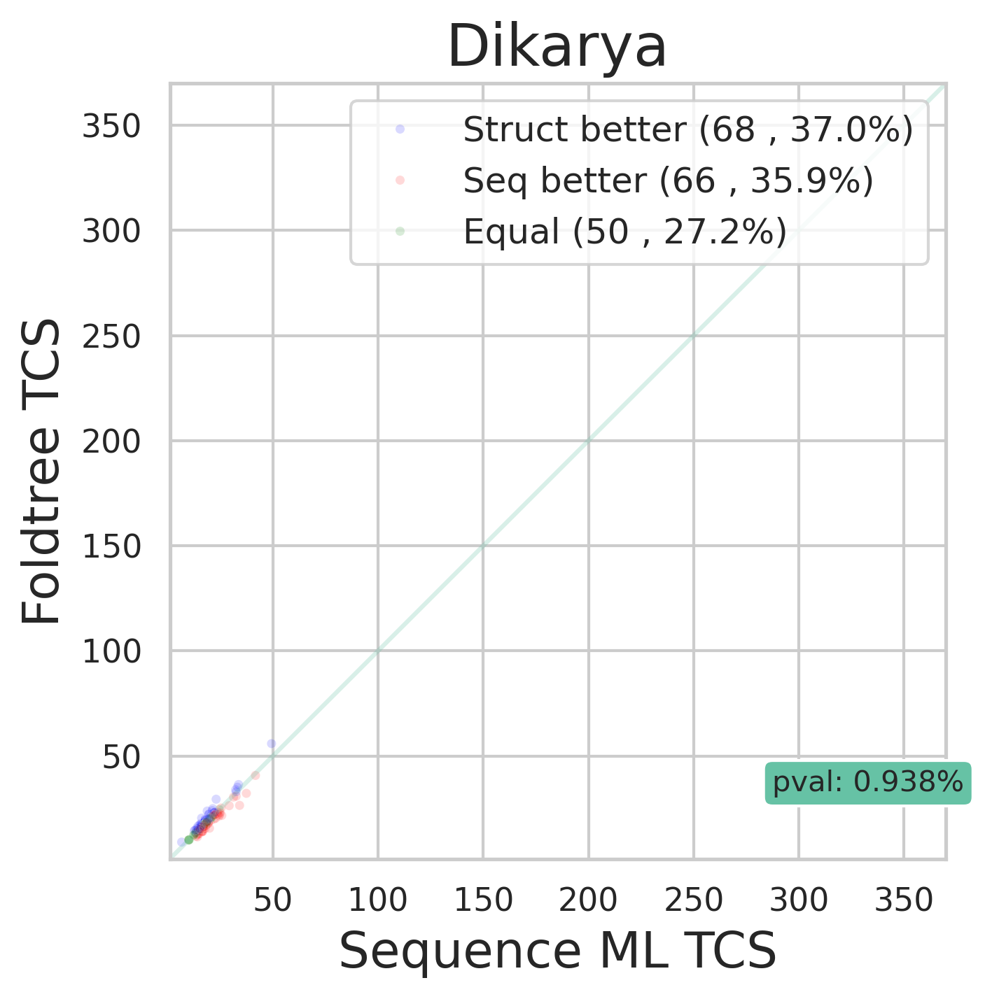

Wilcoxon Test Statistic: 26367.5, P-value: 0.033382629855770944
Kolmogorov-Smirnov Test Statistic: 0.026262626262626262, P-value: 0.9956672963740684
Treescore delta statistics
DescribeResult(nobs=495, minmax=(-10.61904761904762, 8.374999999999996), mean=-0.060969871073314204, variance=0.9062245063059611, skewness=-0.9776256393855226, kurtosis=46.053311884136235)
total tcs diff -30.18008618129053
[<matplotlib.lines.Line2D object at 0x7fb9103dc470>, <matplotlib.lines.Line2D object at 0x7fb910249a90>, <matplotlib.lines.Line2D object at 0x7fb910249ca0>] ['Equal', 'Struct better', 'Seq better']


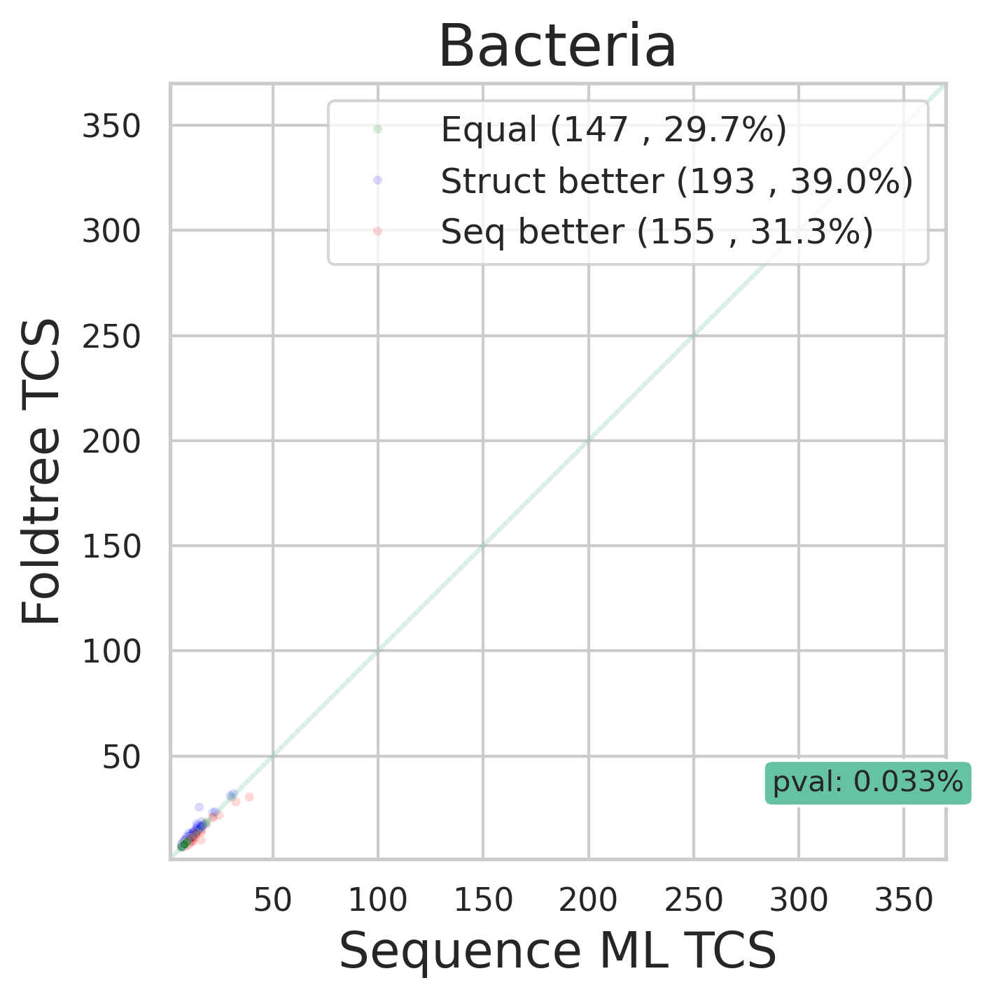

Wilcoxon Test Statistic: 12514.0, P-value: 0.002301764363162886
Kolmogorov-Smirnov Test Statistic: 0.09322033898305085, P-value: 0.09224306862845814
Treescore delta statistics
DescribeResult(nobs=354, minmax=(-21.647058823529413, 12.555555555555557), mean=-0.6454330568132257, variance=13.253317138468557, skewness=-1.4019833996130298, kurtosis=7.40842884781539)
total tcs diff -228.4833021118819
[<matplotlib.lines.Line2D object at 0x7fb910456e40>, <matplotlib.lines.Line2D object at 0x7fb910455ca0>, <matplotlib.lines.Line2D object at 0x7fb90c1fccb0>] ['Struct better', 'Equal', 'Seq better']


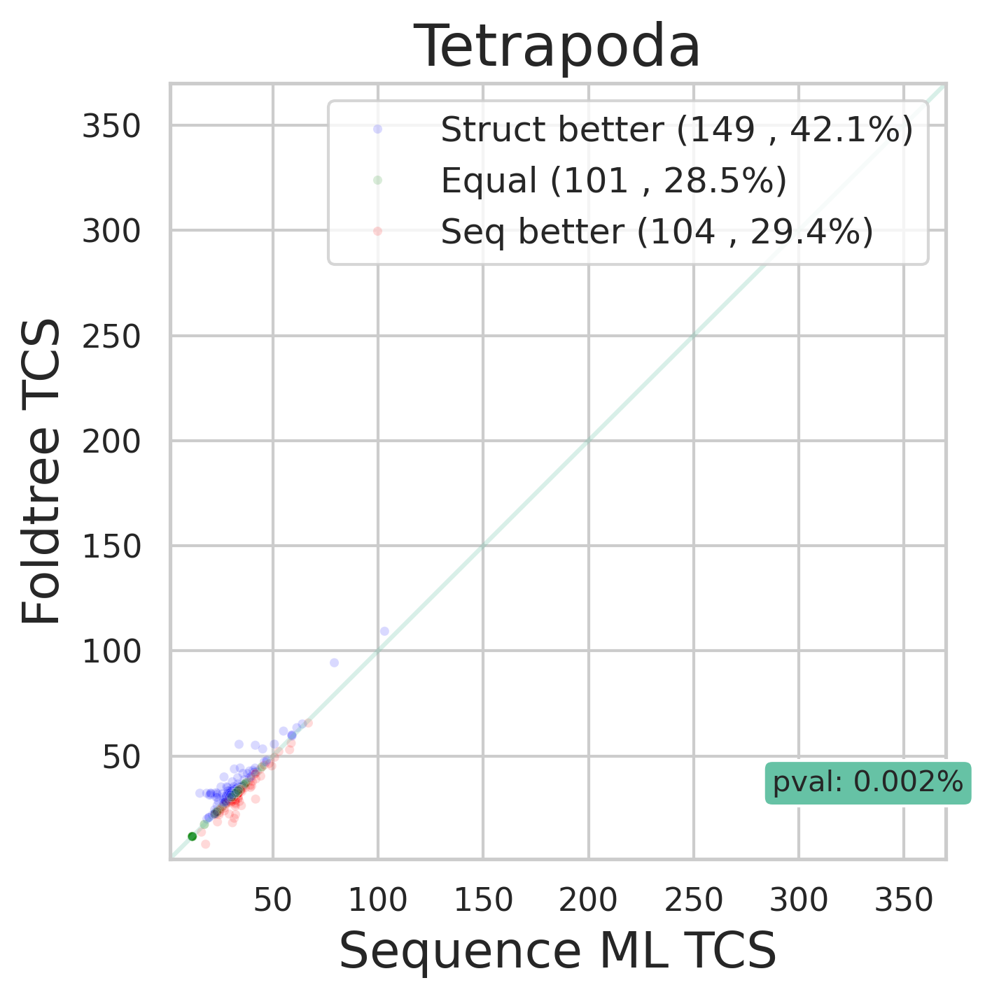

Wilcoxon Test Statistic: 30862.0, P-value: 4.904357143074631e-07
Kolmogorov-Smirnov Test Statistic: 0.11608961303462322, P-value: 0.002652839258924379
Treescore delta statistics
DescribeResult(nobs=491, minmax=(-42.6875, 31.858585858585855), mean=-2.3662454128336194, variance=64.81831941917592, skewness=-1.6528971132353902, kurtosis=5.319637055981275)
total tcs diff -1161.826497701307
[<matplotlib.lines.Line2D object at 0x7fb90c22c470>, <matplotlib.lines.Line2D object at 0x7fb90c316c30>, <matplotlib.lines.Line2D object at 0x7fb90c3169f0>] ['Seq better', 'Struct better', 'Equal']


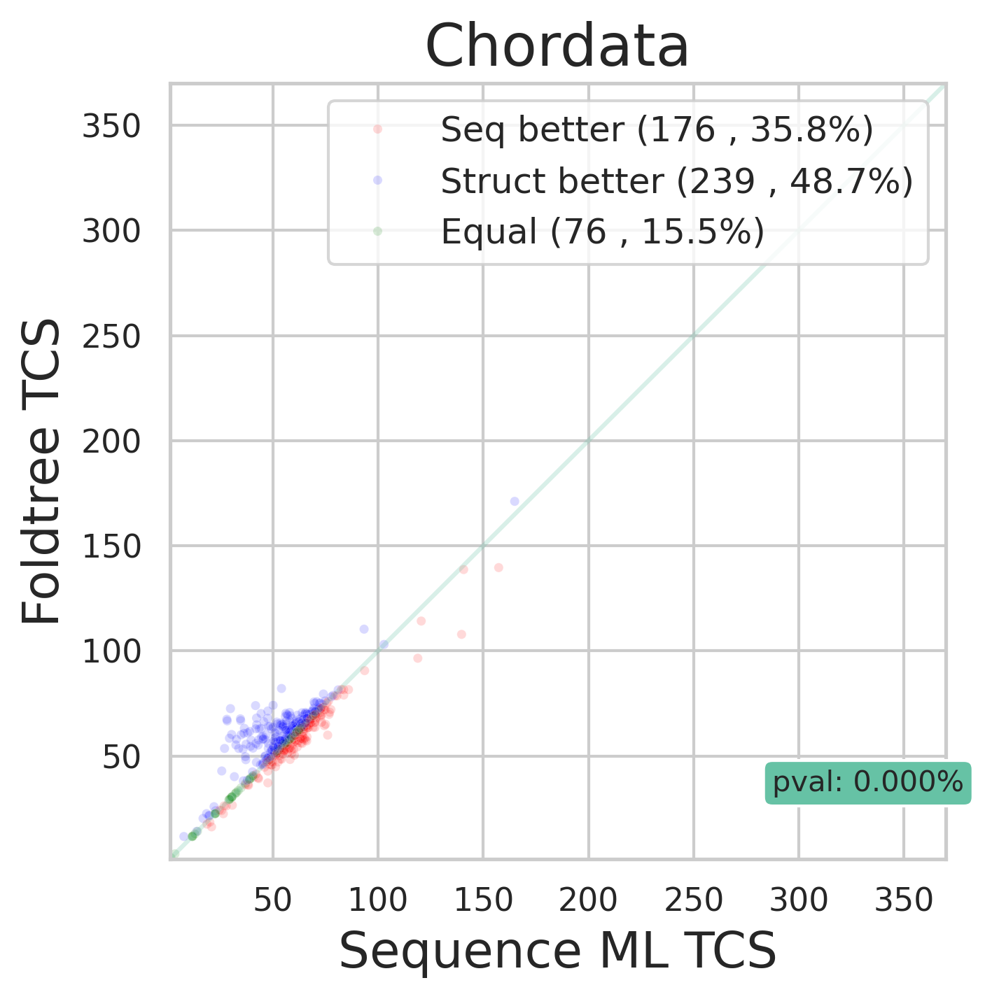

Wilcoxon Test Statistic: 25388.5, P-value: 5.600183268506271e-13
Kolmogorov-Smirnov Test Statistic: 0.12083333333333333, P-value: 0.0017909806814970326
Treescore delta statistics
DescribeResult(nobs=480, minmax=(-46.07692307692307, 21.255319148936167), mean=-3.354575282698098, variance=89.00591257927516, skewness=-2.1128908143403073, kurtosis=6.078628710868525)
total tcs diff -1610.196135695087
[<matplotlib.lines.Line2D object at 0x7fb90cae1b50>, <matplotlib.lines.Line2D object at 0x7fb90c2eccb0>, <matplotlib.lines.Line2D object at 0x7fb90c1b8590>] ['Seq better', 'Equal', 'Struct better']


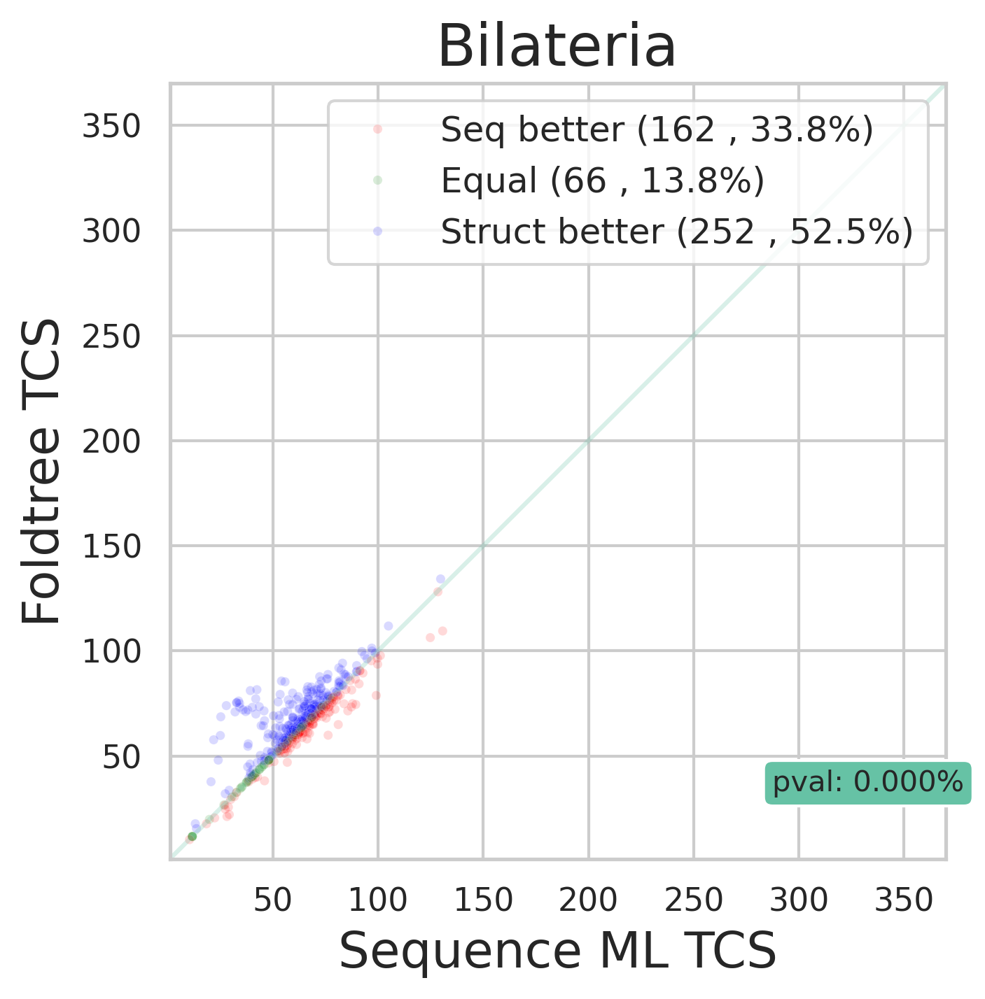

Wilcoxon Test Statistic: 46073.0, P-value: 0.10658610390919344
Kolmogorov-Smirnov Test Statistic: 0.025157232704402517, P-value: 0.9982216844776469
Treescore delta statistics
DescribeResult(nobs=477, minmax=(-26.388888888888886, 20.666666666666664), mean=0.048824359756147274, variance=13.538639919501172, skewness=-0.311530699522425, kurtosis=13.633911457098375)
total tcs diff 23.28921960368225
[<matplotlib.lines.Line2D object at 0x7fb91084c620>, <matplotlib.lines.Line2D object at 0x7fb90cf814c0>, <matplotlib.lines.Line2D object at 0x7fb90cf8af30>] ['Seq better', 'Struct better', 'Equal']


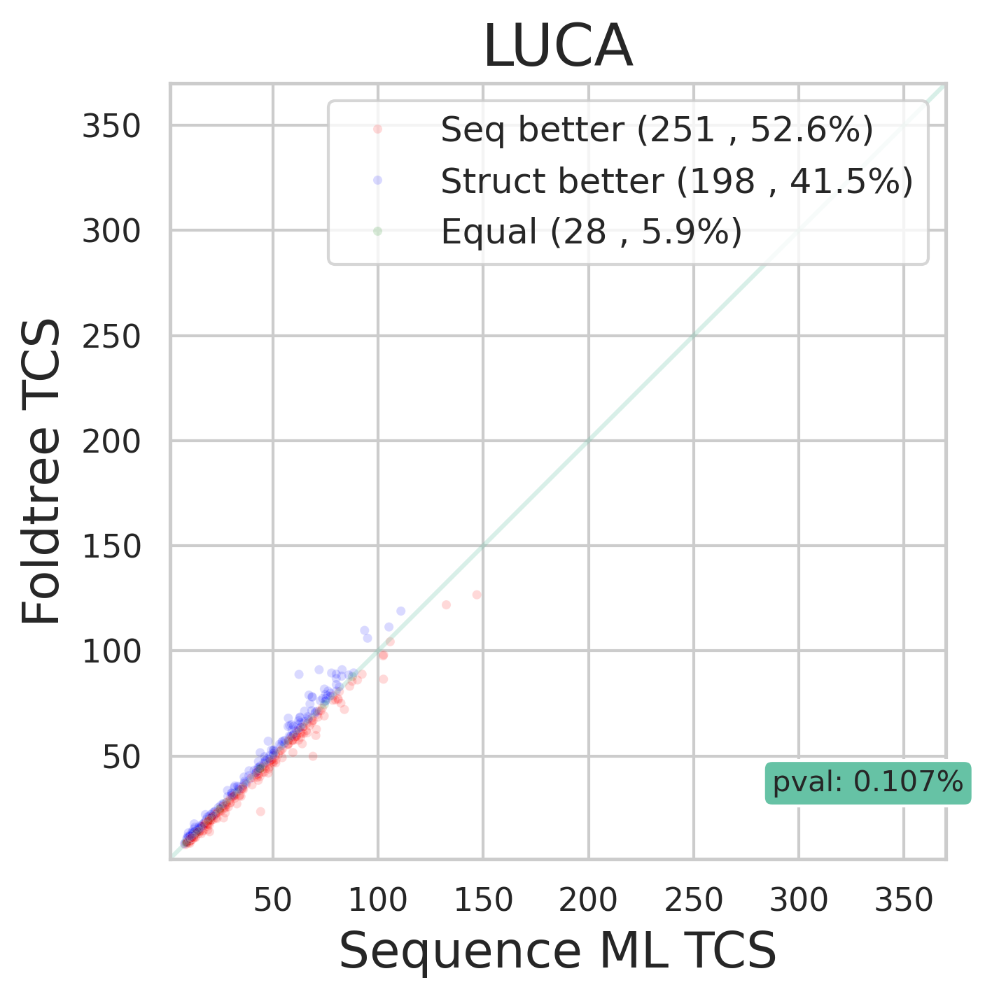

Wilcoxon Test Statistic: 46009.5, P-value: 0.06231850305851426
Kolmogorov-Smirnov Test Statistic: 0.04294478527607362, P-value: 0.758549383533953
Treescore delta statistics
DescribeResult(nobs=489, minmax=(-39.02564102564102, 21.066666666666663), mean=-0.933734326752946, variance=33.52090275708574, skewness=-1.9984199200740669, kurtosis=9.345487531598705)
total tcs diff -456.5960857821906
[<matplotlib.lines.Line2D object at 0x7fb90cf69c70>, <matplotlib.lines.Line2D object at 0x7fb90cc6b440>, <matplotlib.lines.Line2D object at 0x7fb90cc6a0f0>] ['Struct better', 'Seq better', 'Equal']


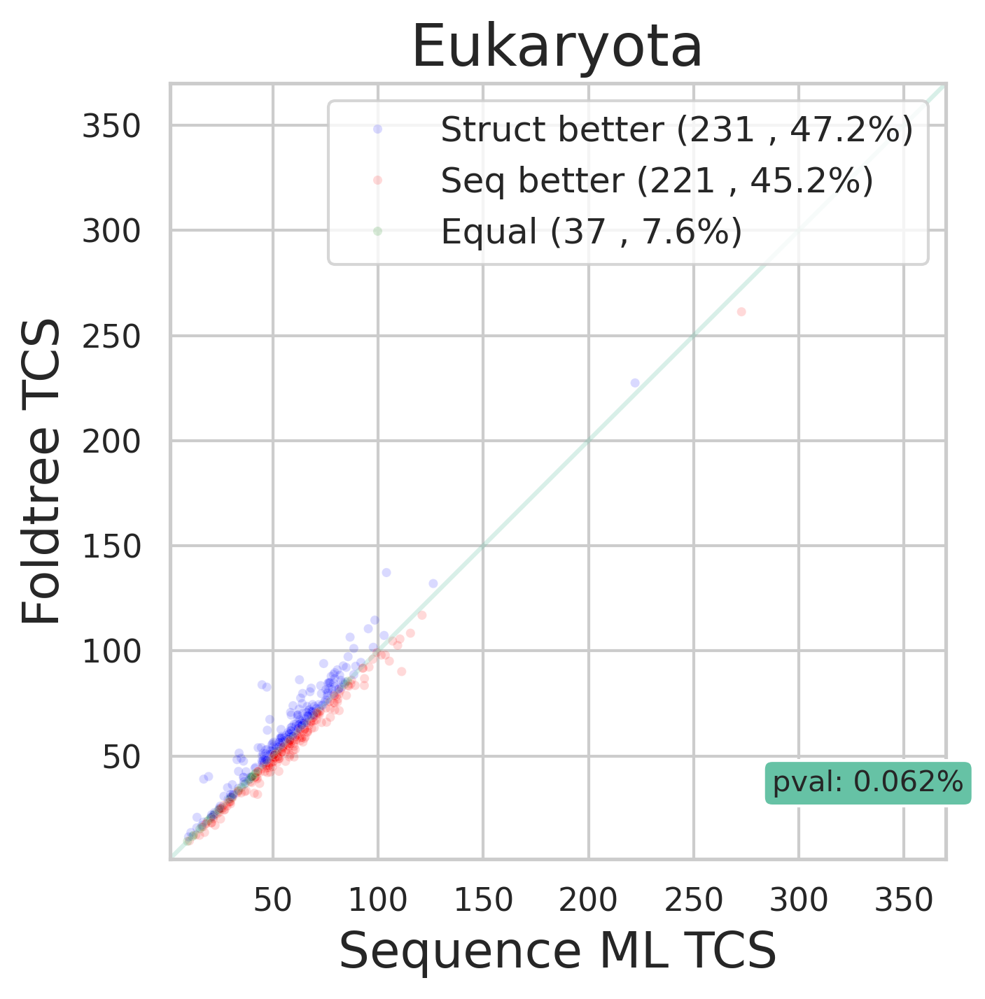

Wilcoxon Test Statistic: 49273.0, P-value: 0.24677883531303724
Kolmogorov-Smirnov Test Statistic: 0.048484848484848485, P-value: 0.6062144015487029
Treescore delta statistics
DescribeResult(nobs=495, minmax=(-40.785714285714285, 31.999999999999993), mean=-0.6557998861460858, variance=45.516632341829656, skewness=-1.427220633493386, kurtosis=9.268873527894225)
total tcs diff -324.62094364231245
[<matplotlib.lines.Line2D object at 0x7fb90c994620>, <matplotlib.lines.Line2D object at 0x7fb90c0ea450>, <matplotlib.lines.Line2D object at 0x7fb90c0e84d0>] ['Seq better', 'Struct better', 'Equal']


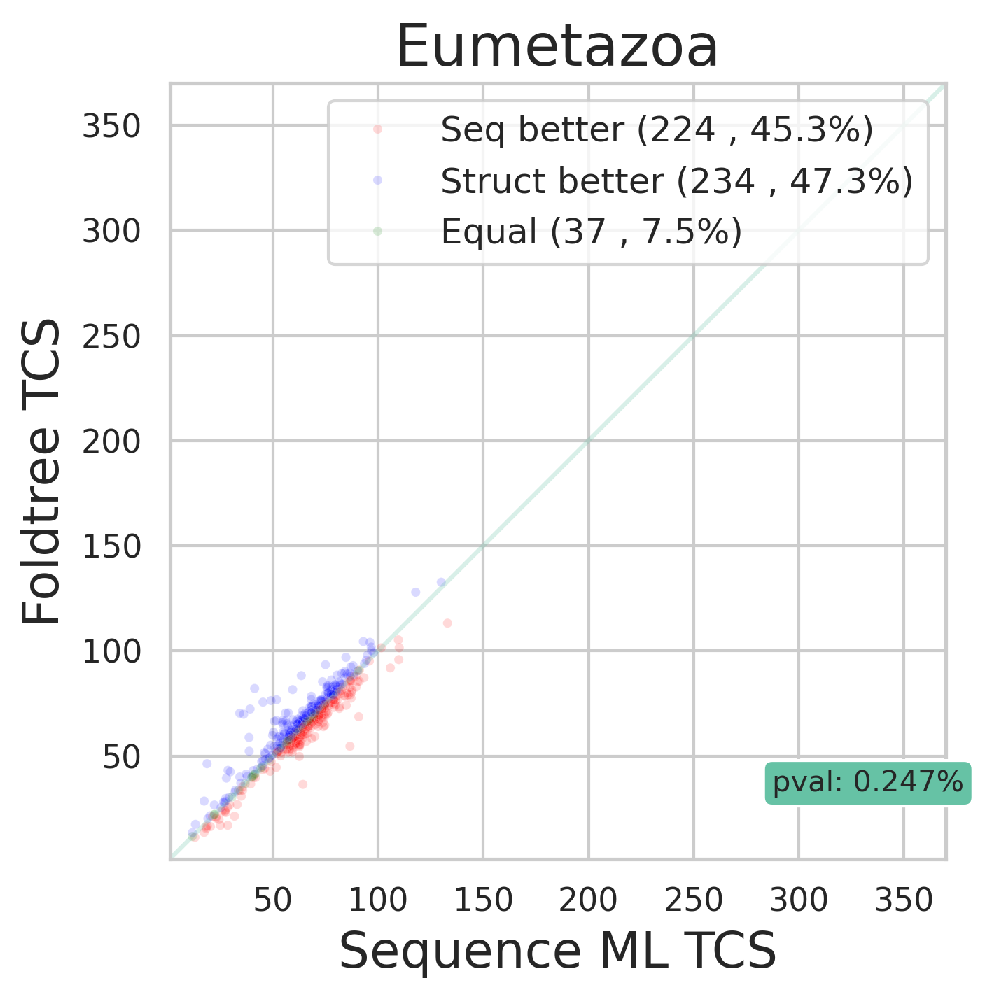

Wilcoxon Test Statistic: 27285.0, P-value: 0.2285199968732916
Kolmogorov-Smirnov Test Statistic: 0.03877551020408163, P-value: 0.8554883494365353
Treescore delta statistics
DescribeResult(nobs=490, minmax=(-26.1, 10.454545454545453), mean=-0.07332862455108952, variance=10.679316047705411, skewness=-2.1986844782265007, kurtosis=13.850947501134666)
total tcs diff -35.93102603003386
[<matplotlib.lines.Line2D object at 0x7fb90c994470>, <matplotlib.lines.Line2D object at 0x7fb90c7873e0>, <matplotlib.lines.Line2D object at 0x7fb90c98ad50>] ['Seq better', 'Struct better', 'Equal']


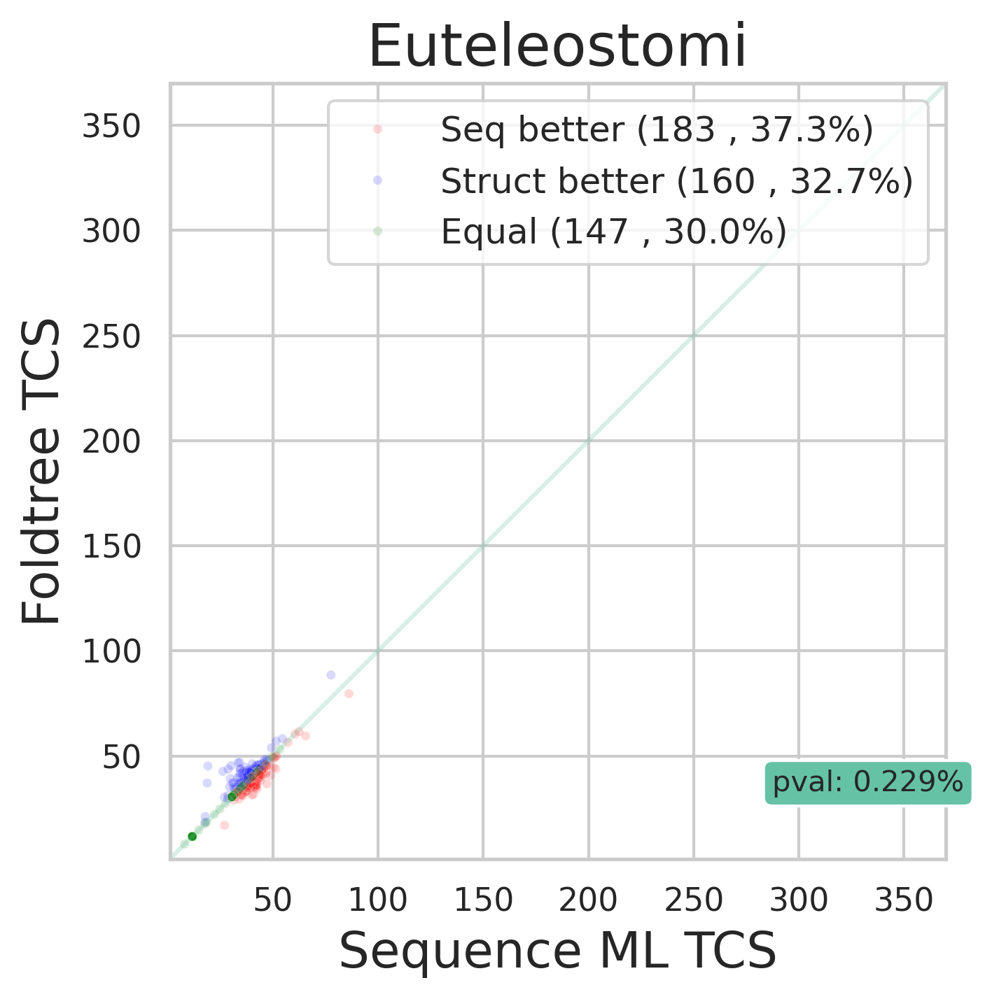

Wilcoxon Test Statistic: 2393.5, P-value: 0.008600101476736588
Kolmogorov-Smirnov Test Statistic: 0.0948905109489051, P-value: 0.5698500339195532
Treescore delta statistics
DescribeResult(nobs=137, minmax=(-3.5, 6.46153846153846), mean=0.38021757204415546, variance=2.2450125468178435, skewness=0.7823107282534049, kurtosis=2.043418470880983)
total tcs diff 52.0898073700493
[<matplotlib.lines.Line2D object at 0x7fb90c784470>, <matplotlib.lines.Line2D object at 0x7fb90c843ec0>, <matplotlib.lines.Line2D object at 0x7fb90c8433e0>] ['Seq better', 'Struct better', 'Equal']


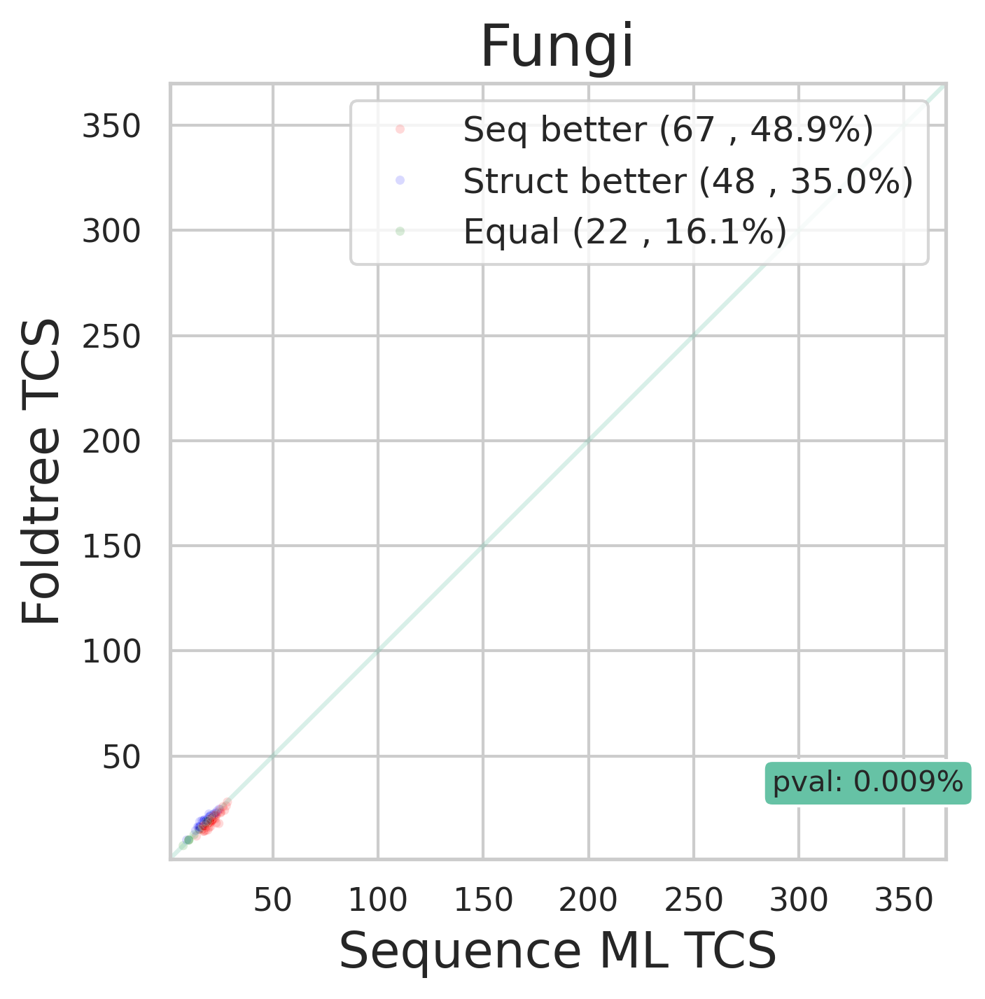

In [179]:
unfiltereddf['level'] = unfiltereddf.index.map( lambda x: x.split('/')[3])
unfiltereddf_ntcs['level'] = unfiltereddf.index.map( lambda x: x.split('/')[3])

print(unfiltereddf['level'].unique() )
for l in unfiltereddf['level'].unique():
    try:
        sub = unfiltereddf[unfiltereddf.level == l ]
        #species tree discordance for cat dataset
        retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' ,  sub
         ,'Sequence ML TCS' ,  'Foldtree TCS',  l )
    except:
        pass
    

In [180]:
#characterise the ultrametricity of the tree
#todo iterate over hogs and cath and train a model

"""
from compile_treeset import compile_folder_treestats
import pandas as pd
cladefolders = set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' ))-set([ '../OMA_data/logs/' ])
dfs = []
for folder in cladefolders:
    print(folder)
    OMA_treestat_DF = compile_folder_treestats( folder, verbose = False  )
    dfs.append(OMA_treestat_DF)
OMA_treestats = pd.concat(dfs)
print(OMA_treestats)
"""

"\nfrom compile_treeset import compile_folder_treestats\nimport pandas as pd\ncladefolders = set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' ))-set([ '../OMA_data/logs/' ])\ndfs = []\nfor folder in cladefolders:\n    print(folder)\n    OMA_treestat_DF = compile_folder_treestats( folder, verbose = False  )\n    dfs.append(OMA_treestat_DF)\nOMA_treestats = pd.concat(dfs)\nprint(OMA_treestats)\n"

In [181]:
#OMA_treestats.to_pickle('OMA_treestats.pkl')

In [182]:
OMA_treestats = pd.read_pickle('OMA_treestats.pkl')

In [183]:
"""
cladefolders = [ '../CATH_data/' ]
dfs = []
for folder in cladefolders:
    print(folder)
    CATH_treestat_DF = compile_folder_treestats( folder, verbose = False  )
    dfs.append(CATH_treestat_DF)
CATH_treestats = pd.concat(dfs)
"""


"\ncladefolders = [ '../CATH_data/' ]\ndfs = []\nfor folder in cladefolders:\n    print(folder)\n    CATH_treestat_DF = compile_folder_treestats( folder, verbose = False  )\n    dfs.append(CATH_treestat_DF)\nCATH_treestats = pd.concat(dfs)\n"

In [184]:
#CATH_treestats.to_pickle('CATH_treestats.pkl')

In [185]:
"""
import tqdm
import json
allfolders = []
cladefolders = set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' )) - set([ '../OMA_data_unfiltered/OMA_data/logs/' ])
for folder in cladefolders:
    hogs = glob.glob(folder+'*/')
    cladestats = []
    print(folder)
    allstats = {}
    for h in tqdm.tqdm(hogs):
        alns = glob.glob(h+'*dist_*_*.json')
        for a in alns:
            allstats[h+a] = {}
            with open(a) as f:
                alnstats = json.load(f)
            allstats[h+a]['fam'] = h
            allstats[h+a]['aln'] = a.split('/')[-1]
            allstats[h+a]['stats'] = list( alnstats.values() )[0]
    cladestatsdf = pd.DataFrame.from_dict(allstats , orient = 'index')
    allfolders.append(cladestatsdf)
allfoldersdf = pd.concat(allfolders)
#save allfoldersdf
allfoldersdf.to_pickle('alnstats_allfoldersdf.pkl')
"""

"\nimport tqdm\nimport json\nallfolders = []\ncladefolders = set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' )) - set([ '../OMA_data_unfiltered/OMA_data/logs/' ])\nfor folder in cladefolders:\n    hogs = glob.glob(folder+'*/')\n    cladestats = []\n    print(folder)\n    allstats = {}\n    for h in tqdm.tqdm(hogs):\n        alns = glob.glob(h+'*dist_*_*.json')\n        for a in alns:\n            allstats[h+a] = {}\n            with open(a) as f:\n                alnstats = json.load(f)\n            allstats[h+a]['fam'] = h\n            allstats[h+a]['aln'] = a.split('/')[-1]\n            allstats[h+a]['stats'] = list( alnstats.values() )[0]\n    cladestatsdf = pd.DataFrame.from_dict(allstats , orient = 'index')\n    allfolders.append(cladestatsdf)\nallfoldersdf = pd.concat(allfolders)\n#save allfoldersdf\nallfoldersdf.to_pickle('alnstats_allfoldersdf.pkl')\n"

In [186]:
import pandas as pd
allfoldersdf = pd.read_pickle('alnstats_allfoldersdf.pkl')

In [187]:

methodstats = []
for method in allfoldersdf.aln.unique():
    sub = allfoldersdf[allfoldersdf.aln == method ]
    #print(sub)
    #plt.figure(figsize = (10,10))
    for i in [ 2,3,4,5 ]:
        sub[i] = sub['stats'].map( lambda x : x[i]  )
    sub[['mean' , 'var' , 'skewness' , 'kurtosis'] ] = sub[[2,3,4,5] ]
    #sub[['mean' , 'var' , 'skewness' , 'kurtosis']].hist( )
    methodstats.append(sub)
    #plt.show()

methodstats = pd.concat(methodstats)


In [188]:
from matplotlib import pyplot as plt
cols = ['mean', 'var', 'skewness']
colmapper = {'mean':'Mean Pairwise Identity', 'var':'Variance', 'skewness':'Skewness'}

methods = ['alnfident_dist_AA_3di.json'  , 'alnfident_dist_AA_AA.json' , 'alnfident_dist_1_raw_.json' ]
mapper = {  'alnfident_dist_AA_3di.json': '3di Align' , 'alnfident_dist_AA_AA.json': 'AA Align' , 'alnfident_dist_1_raw_.json': 'Foldseek Align'  } 

fig, axs = plt.subplots(len(methods), len(cols), sharex=False,sharey=False, tight_layout=True , figsize = (40,20))
for j,col in enumerate( cols ):
    print(col)
    df = methodstats[[col, 'aln']]
    
    bins = np.histogram_bin_edges(df[col].dropna(), bins=20)
    for i,met in enumerate(methods):
        data = df[df['aln']  ==  met ][col]  
        #data[data>.25]= .25
        #axs[i][j].set_box_aspect(.25)
        #axs[i].set_xlim(0,.20)
        #axs[i].hist( df[col] , bins=bins)
        axs[i][j].hist( data , alpha=0.75, bins= bins )
        axs[i][j].grid(False)
        axs[i][j].set_title( mapper[met] + ' '+ colmapper[col] , fontsize=35 , fontweight='bold')
        axs[i][j].tick_params(axis='both', which='major', labelsize=25)
        if i != 0:
            axs[i, j].sharex(axs[0, j])
        if j == 0:
            axs[i][j].set_ylabel('N alignments', fontsize=30)
        if i == len(methods) - 1:
            axs[i][j].set_xlabel(colmapper[col], fontsize=30)

    
        axs[i, j].sharey(axs[0, 1])
        if j == 0 :
            axs[i][j].axvline(x = np.median(data), color = 'r')

        #axs[i, j].sharey(axs[0, 0])
        #axs[i].set_ylabel('n Trees')
plt.savefig('../figures/histalnident_OMA.svg')
plt.show()

mean
var
skewness


In [189]:
OMA_methodstats = methodstats

In [190]:
"""
import tqdm
import json
allfolders = []
cladefolders = glob.glob('/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CATH_data_mk4_genus/' )
for folder in cladefolders:
    hogs = glob.glob(folder+'*/')
    print(len(hogs))
    cladestats = []
    print(folder)
    allstats = {}
    for h in tqdm.tqdm(hogs):
        alns = glob.glob(h+'*dist_*.json')
        for a in alns:
            allstats[h+a] = {}
            with open(a) as f:
                alnstats = json.load(f)
            allstats[h+a]['fam'] = h
            allstats[h+a]['aln'] = a.split('/')[-1]
            allstats[h+a]['stats'] = list( alnstats.values() )[0]
    cladestatsdf = pd.DataFrame.from_dict(allstats , orient = 'index')
    allfolders.append(cladestatsdf)
allfoldersdf = pd.concat(allfolders)
#save allfoldersdf
allfoldersdf.to_pickle('alnstats_CATH_allfoldersdf.pkl')

"""

"\nimport tqdm\nimport json\nallfolders = []\ncladefolders = glob.glob('/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CATH_data_mk4_genus/' )\nfor folder in cladefolders:\n    hogs = glob.glob(folder+'*/')\n    print(len(hogs))\n    cladestats = []\n    print(folder)\n    allstats = {}\n    for h in tqdm.tqdm(hogs):\n        alns = glob.glob(h+'*dist_*.json')\n        for a in alns:\n            allstats[h+a] = {}\n            with open(a) as f:\n                alnstats = json.load(f)\n            allstats[h+a]['fam'] = h\n            allstats[h+a]['aln'] = a.split('/')[-1]\n            allstats[h+a]['stats'] = list( alnstats.values() )[0]\n    cladestatsdf = pd.DataFrame.from_dict(allstats , orient = 'index')\n    allfolders.append(cladestatsdf)\nallfoldersdf = pd.concat(allfolders)\n#save allfoldersdf\nallfoldersdf.to_pickle('alnstats_CATH_allfoldersdf.pkl')\n\n"

In [191]:
allfoldersdf = pd.read_pickle('alnstats_CATH_allfoldersdf.pkl')

In [192]:
methodstats = []
for method in allfoldersdf.aln.unique():
    sub = allfoldersdf[allfoldersdf.aln == method ]
    #print(sub)
    #plt.figure(figsize = (10,10))
    for i in [ 2,3,4,5 ]:
        sub[i] = sub['stats'].map( lambda x : x[i]  )
    sub[['mean' , 'var' , 'skewness' , 'kurtosis'] ] = sub[[2,3,4,5] ]
    #sub[['mean' , 'var' , 'skewness' , 'kurtosis']].hist( )
    methodstats.append(sub)
    #plt.show()

methodstats = pd.concat(methodstats)
methodstats = methodstats.dropna()

In [193]:
from matplotlib import pyplot as plt
cols = ['mean', 'var' , 'skewness' ]
methods = ['alnfident_dist_AA_3di.json'  , 'alnfident_dist_AA_AA.json' , 'alnfident_dist_1_raw_.json' ]
mapper = {  'alnfident_dist_AA_3di.json': '3di Align' , 'alnfident_dist_AA_AA.json': 'AA Align' , 'alnfident_dist_1_raw_.json': 'Foldseek Align'  } 

fig, axs = plt.subplots(len(methods), len(cols), sharex=False,sharey=False, tight_layout=True , figsize = (40,20))
for j,col in enumerate( cols ):
    print(col)
    df = methodstats[[col, 'aln']]
     # Calculate bin edges for the current column
    bins = np.histogram_bin_edges(df[col], bins=20)
    
    #bins=np.histogram(df[col], bins=1000)[1] #get the bin edges
    for i,met in enumerate(methods):
        data = df[df['aln']  ==  met ][col]  
        #data[data>.25]= .25
        #axs[i][j].set_box_aspect(.25)
        #axs[i].set_xlim(0,.20)
        #axs[i].hist( df[col] , bins=bins)
        axs[i][j].hist( data , alpha=0.75, bins= bins )
        axs[i][j].grid(False)
        axs[i][j].set_title( mapper[met] + ' '+ colmapper[col] , fontsize=35 , fontweight= 'bold' )
        axs[i][j].tick_params(axis='both', which='major', labelsize=25)
        if i != 0:
            axs[i, j].sharex(axs[0, j])
        axs[i, j].sharey(axs[0, 1])
        if j == 0 :
            axs[i][j].axvline(x = np.median(data), color = 'r')
            axs[i][j].set_ylabel('N alignments', fontsize=30)
        if i == len(methods) - 1:
            axs[i][j].set_xlabel(colmapper[col], fontsize=30)

        #axs[i, j].sharey(axs[0, 0])
        #axs[i].set_ylabel('n Trees')
        #plt.savefig('../figures/ultrametricity_hist_all.svg')
plt.show()



mean
var
skewness


In [194]:
CATH_methodstats = methodstats

In [195]:
#copy normalized dataframes
cathdf_ntcs_copy = cathdf.copy()
cathdf_copy = cathdf.copy()
normalized_ntcs_copy = normalized.copy()
normalized_copy = normalized.copy()

print(normalized_copy.index)

Index(['../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG124/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG457/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG493/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG298/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG266/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG492/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG408/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG325/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG569/',
       '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG75/',
       ...
       '../OMA_data_unfiltered/OMA_data/Fungi/HOG126/',
       '../OMA_data_unfiltered/OMA_data/Fungi/HOG128/',
       '../OMA_data_unfiltered/OMA_data/Fungi/HOG75/',
       '../OMA_data_unfiltered/OMA_data/Fungi/HOG61/',
       '../OMA_data_unfiltered/OMA_data/Fungi/HOG29/',
       '../OMA_data_unfiltered/OMA_data/Fungi/HOG77/',
       '../OMA_data_unfilter

In [196]:
OMA_methodstats['method'] = OMA_methodstats.index.map( lambda x : x.split('/')[-1] )
OMA_methodstats['hog'] = OMA_methodstats.index.map( lambda x :  '..'+x.split('..')[1] )
print( set(OMA_methodstats.hog).intersection( set(normalized_copy.index) ) )

print( len( set(OMA_methodstats.hog).intersection( set(normalized_copy.index) ) ) )

{'../OMA_data_unfiltered/OMA_data/LUCA/HOG661/', '../OMA_data_unfiltered/OMA_data/Eukaryota/HOG79/', '../OMA_data_unfiltered/OMA_data/Bacteria/HOG291/', '../OMA_data_unfiltered/OMA_data/Dikarya/HOG30/', '../OMA_data_unfiltered/OMA_data/Chordata/HOG238/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/HOG1795/', '../OMA_data_unfiltered/OMA_data/Eumetazoa/HOG368/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/HOG2498/', '../OMA_data_unfiltered/OMA_data/LUCA/HOG896/', '../OMA_data_unfiltered/OMA_data/LUCA/HOG838/', '../OMA_data_unfiltered/OMA_data/Tetrapoda/HOG349/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/HOG2749/', '../OMA_data_unfiltered/OMA_data/Opisthokonta/HOG348/', '../OMA_data_unfiltered/OMA_data/Tetrapoda/HOG29/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/HOG1774/', '../OMA_data_unfiltered/OMA_data/Eumetazoa/HOG956/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/HOG774/', '../OMA_data_unfiltered/OMA_data/LUCA/HOG407/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/HOG6

In [197]:

for method in OMA_methodstats.method.unique():
    
    print(method)
    sub = OMA_methodstats[OMA_methodstats.method == method][['mean', 'var', 'skewness' , 'kurtosis' , 'hog']]
    if len(sub) == 0:
        continue
    #drop if method contains too many missing values
    if len(sub.dropna()) < 2000:
        continue
    sub.columns = [ str(c) +'_' + method if c not in ['hog' ]  else c for c  in sub.columns ]
    normalized_copy = normalized_copy.merge(sub , left_index=True, right_on='hog' , how = 'left' )

    normalized_copy.index = normalized_copy.hog
    #drop all hog columns
    normalized_copy = normalized_copy.drop(columns = [ c for c in normalized_copy.columns if 'hog' in c ] )
    print(normalized_copy.head(), len(normalized_copy))


alnfident_dist_1_raw_.json
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          47.000000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          45.913043   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          64.916667   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          75.000000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          43.875000   

                                                    lddt_1_exp_struct_tree_norm  \
hog                                                                               
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                    54.645161   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                    65.869565   
../OMA_data_unfil

[1 2 3 0]
1
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          47.000000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          45.913043   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          64.916667   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          52.111111   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          51.536082   
...                                                                               ...   
../OMA_data_unfiltered/OMA_data/Fungi/HOG74/                                17.363636   
../OMA_data_unfiltered/OMA_data/Fungi/HOG84/                                18.833333   
../OMA_data_unfiltered/OMA_data/Fungi/HOG94/                                11.333333   
../OMA_da

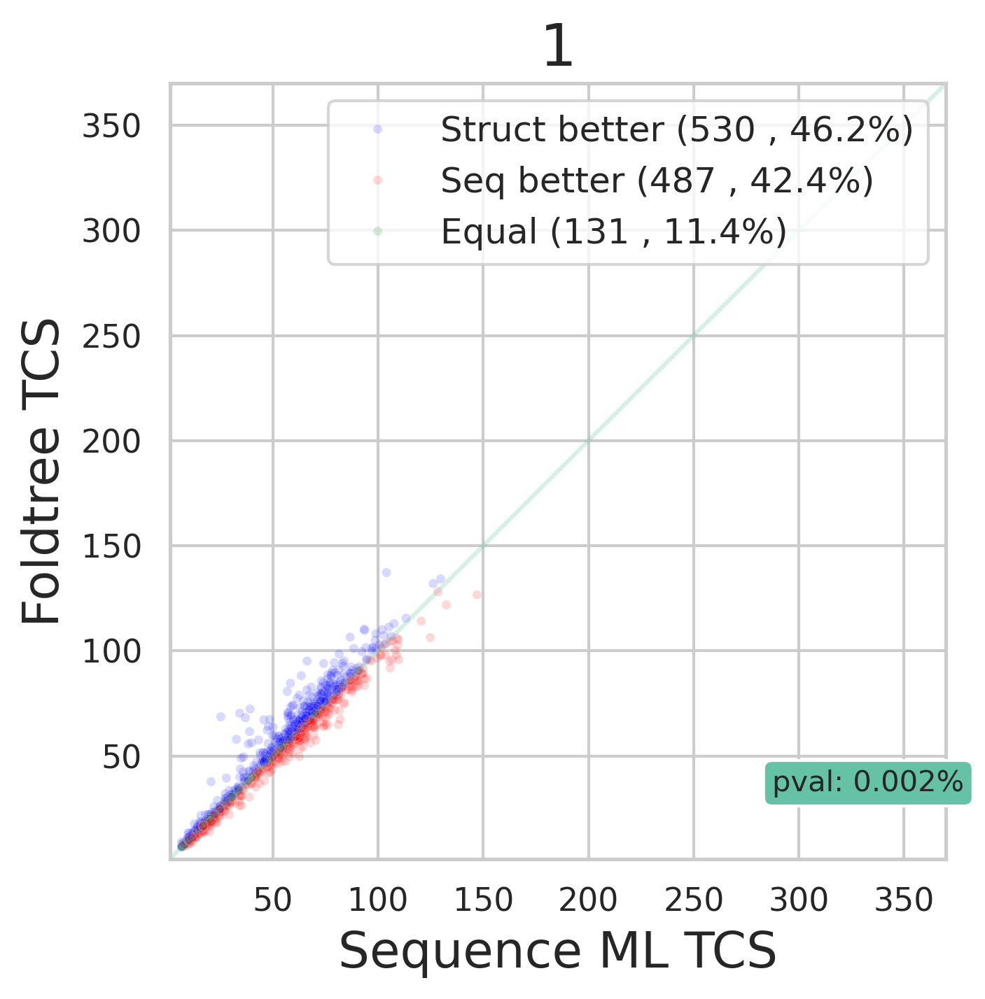

2
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          75.000000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          43.875000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          28.689655   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          27.222222   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          91.500000   
...                                                                               ...   
../OMA_data_unfiltered/OMA_data/Fungi/HOG36/                                14.166667   
../OMA_data_unfiltered/OMA_data/Fungi/HOG85/                                12.181818   
../OMA_data_unfiltered/OMA_data/Fungi/HOG93/                                14.818182   
../OMA_data_unfilte

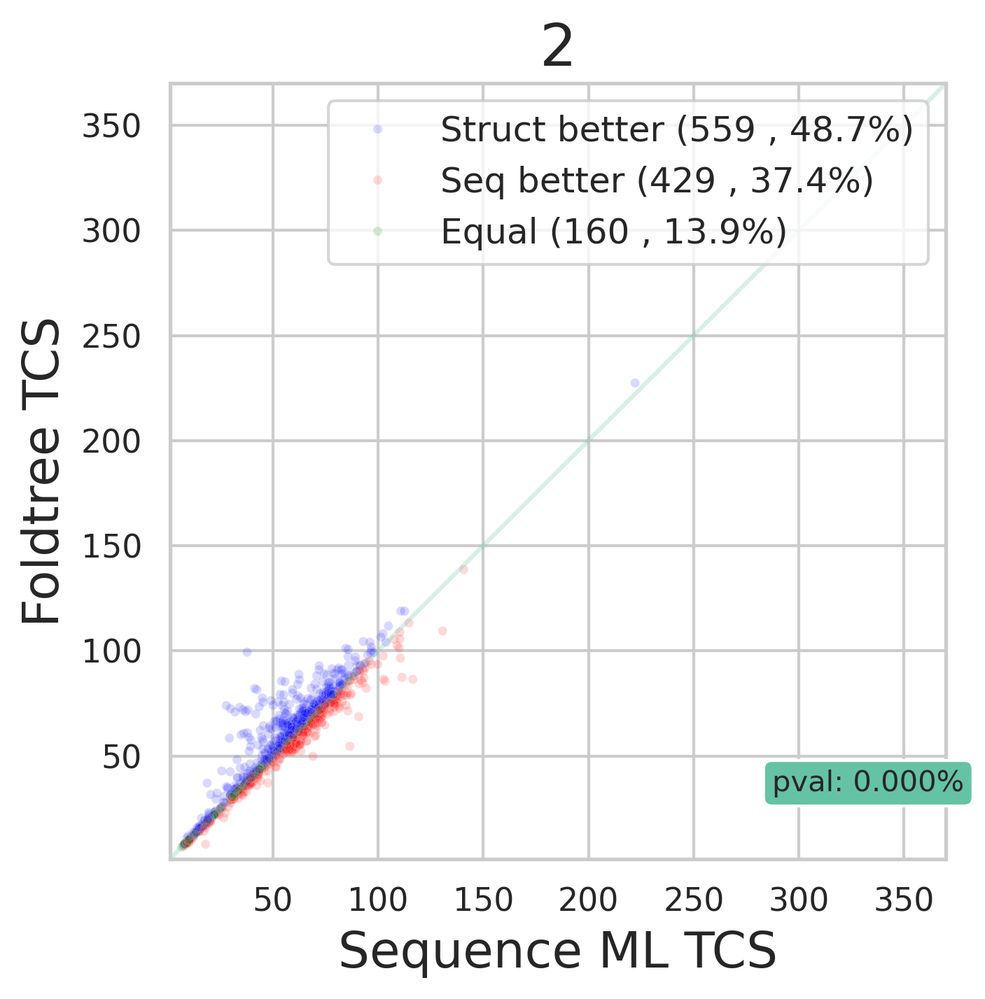

3
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          66.928571   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          82.562500   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          43.200000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          48.352941   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          47.200000   
...                                                                               ...   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...                          23.833333   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...                          31.500000   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...                          33.666667   
../OMA_data_unfilte

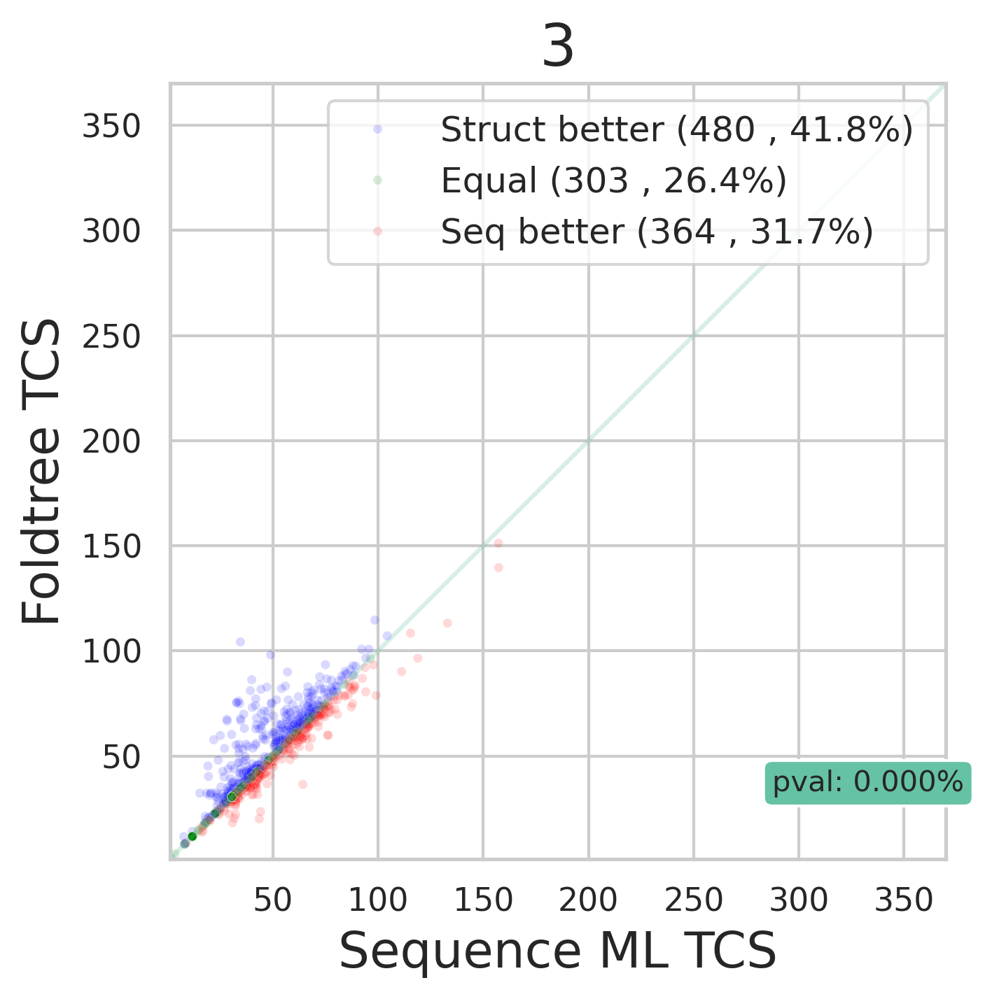

0
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          41.187500   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          27.200000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          19.214286   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          55.857143   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          41.577465   
...                                                                               ...   
../OMA_data_unfiltered/OMA_data/Fungi/HOG77/                                19.100000   
../OMA_data_unfiltered/OMA_data/Fungi/HOG101/                               16.692308   
../OMA_data_unfiltered/OMA_data/Fungi/HOG127/                               16.071429   
../OMA_data_unfilte

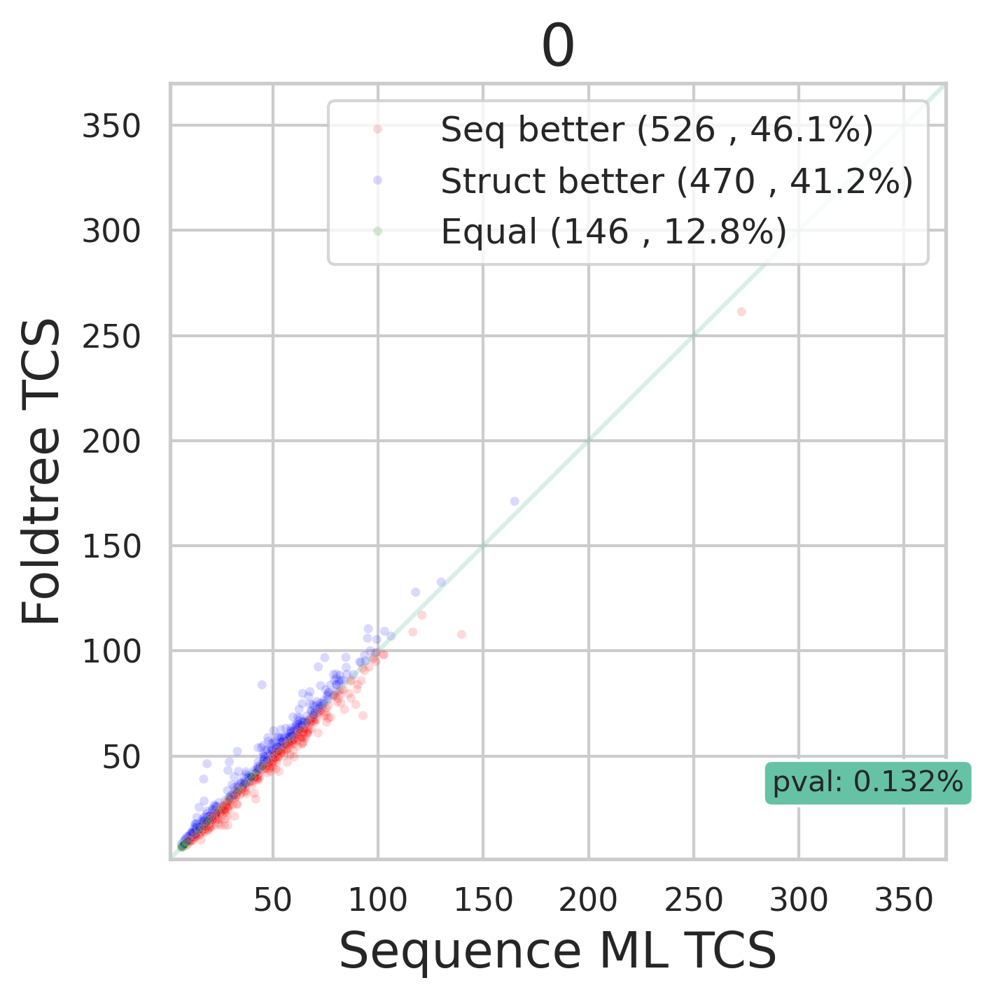

In [198]:
# select quartiles of normalized_copy as a function of mean_alnfident_dist_AA_AA.json 

normalized_copy['mean_alnfident_dist_AA_AA.json'] = normalized_copy['mean_alnfident_dist_AA_AA.json'].astype(float)
normalized_copy['aln_mean_quartile'] = pd.qcut(normalized_copy['mean_alnfident_dist_AA_AA.json'], 4, labels=False)
print(normalized_copy['aln_mean_quartile'].unique() )
for q in normalized_copy['aln_mean_quartile'].unique():
    print(q)
    sub = normalized_copy[normalized_copy['aln_mean_quartile'] == q]
    print(sub)
    print(sub.index)
    print(sub.columns)

    retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' ,  sub
         ,'Sequence ML TCS' ,  'Foldtree TCS',  str(q) )

In [199]:
#new figure with stacked bar plots
normalized_copy['delta'] = (normalized_copy['fident_1_exp_struct_tree_norm' ] - normalized_copy['sequences.aln.muscle.fst.treefile.rooted_norm'] ) 

#print the fraction less than 0
print( 'less',  normalized_copy['delta'][ normalized_copy['delta'] < 0 ].count() / len(normalized_copy) )

#now the fraction greater than 0
print( 'greater', normalized_copy['delta'][ normalized_copy['delta'] > 0 ].count() / len(normalized_copy) )

#print the fraction equal to 0
print('equal', normalized_copy['delta'][ normalized_copy['delta'] == 0 ].count() / len(normalized_copy) )

less 0.3932070542129327
greater 0.44393642499455693
equal 0.16111473982146746


less 0.3932070542129327
greater 0.44393642499455693
equal 0.16111473982146746


/tmp/47872125/ipykernel_1516033/2443928576.py:1: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/tmp/47872125/ipykernel_1516033/2443928576.py:3: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting valu

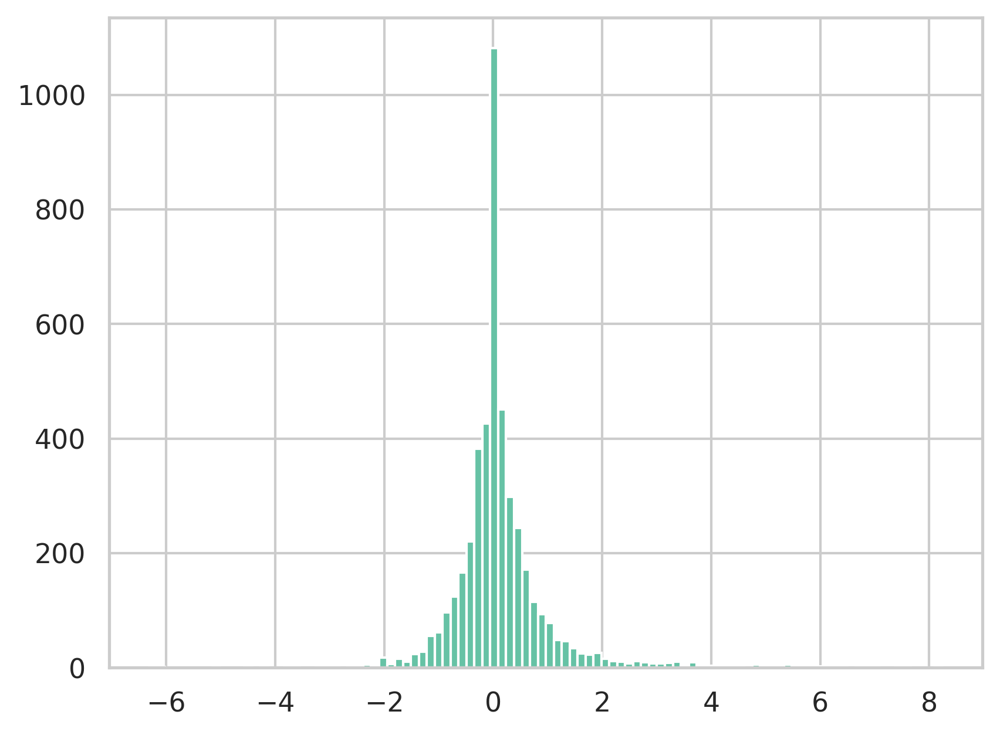

In [200]:


normalized_copy['delta'][ normalized_copy['delta'] != 0  ] = normalized_copy['delta'][normalized_copy['delta'] != 0  ]  / (normalized_copy['fident_1_exp_struct_tree_norm'][normalized_copy['delta'] != 0  ]  + normalized_copy['sequences.aln.muscle.fst.treefile.rooted_norm'][normalized_copy['delta'] != 0  ]  )

normalized_copy['delta'][ normalized_copy['delta'] != 0  ]  = (normalized_copy['delta']  ) / normalized_copy['delta'].std()

plt.hist(normalized_copy['delta'] , bins = 100)



#print the fraction less than 0
print( 'less',  normalized_copy['delta'][ normalized_copy['delta'] < 0 ].count() / len(normalized_copy) )

#now the fraction greater than 0
print( 'greater', normalized_copy['delta'][ normalized_copy['delta'] > 0 ].count() / len(normalized_copy) )

#print the fraction equal to 0
print('equal', normalized_copy['delta'][ normalized_copy['delta'] == 0 ].count() / len(normalized_copy) )

In [205]:

#cut at +- 1 std to the right and left of 0
for i,category in enumerate(["Much Worse", "Worse", "Equal", "Better", "Much Better"]):
    print(category)
    normalized_copy[category]= 0 
    if category == "Equal":
        normalized_copy[category][normalized_copy['delta'] ==  0]  = 1 
    else:
        if category == "Much Worse":
            normalized_copy[category][normalized_copy['delta'] < -1 ] = 1
        elif category == "Worse":
            normalized_copy[category][(normalized_copy['delta'] > -1 ) & (normalized_copy['delta'] < 0)] = 1
        elif category == "Better":
            normalized_copy[category][(normalized_copy['delta'] > 0) & (normalized_copy['delta'] < 1 ) ] = 1
        elif category == "Much Better":
            normalized_copy[category][normalized_copy['delta'] > 1 ] = 1

#plot all categories in a stacked bar plo

Much Worse
Worse
Equal
Better
Much Better


/tmp/47872125/ipykernel_1516033/1561006988.py:9: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/tmp/47872125/ipykernel_1516033/1561006988.py:11: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting val

1
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          47.000000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          45.913043   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          64.916667   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          52.111111   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          51.536082   
...                                                                               ...   
../OMA_data_unfiltered/OMA_data/Fungi/HOG74/                                17.363636   
../OMA_data_unfiltered/OMA_data/Fungi/HOG84/                                18.833333   
../OMA_data_unfiltered/OMA_data/Fungi/HOG94/                                11.333333   
../OMA_data_unfilte

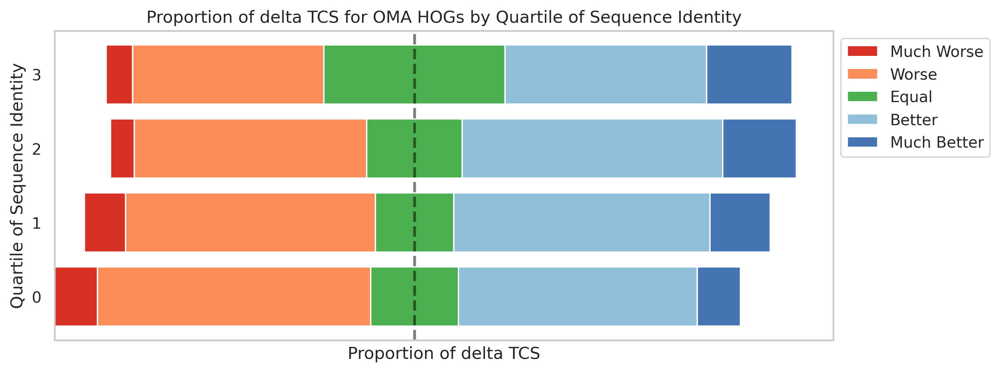

In [218]:

data = {}
# Define colors
colors = ["#d73027", "#fc8d59", "#4CAF50", "#91bfdb", "#4575b4"]
shifts = []
for q in normalized_copy['aln_mean_quartile'].unique():
    sub = normalized_copy[normalized_copy['aln_mean_quartile'] == q]
    print(q)
    print(sub)
    print(sub.index)
    print(sub.columns)
    if q not in data:
        data[q] = []
    for category in ["Much Worse", "Worse", "Equal", "Better", "Much Better"]:
        data[q].append( sub[category].sum() / len(sub) )

    #make sure the sum is 1
    data[q] = [ d / sum(data[q]) for d in data[q] ]
    shifts.append(  - (data[q][0] + data[q][1] + data[q][2]/2) )



# Plotting the horizontal stacked bar chart
fig, ax = plt.subplots(figsize=(10, 4) )
# Cumulative sum to stack the bars
bottoms = np.zeros(len(data)) + np.array(shifts)
for i, category in enumerate(["Much Worse", "Worse", "Equal", "Better", "Much Better"]):
    values = [data[row][i] for row in data]
    ax.barh(list(data.keys()), values, left=bottoms, color=colors[i], label=category)
    bottoms += values

#turn off grid and x axis
ax.xaxis.grid(False)
ax.grid(False)

#draw a vertical line at 0
ax.axvline(0, color='black', lw=2 , linestyle='--' , alpha = .5)


# Adding labels and legend
#set the y axis ticks with the quartile values
ax.set_yticks(list(data.keys()))

ax.set_xlabel("Proportion of delta TCS")
ax.set_ylabel("Quartile of Sequence Identity")

#remove the x axis
ax.set_xticks([])

ax.set_title("Proportion of delta TCS for OMA HOGs by Quartile of Sequence Identity")
ax.legend(title="Categories")
#move the legend outside the plot
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.show()



1
                                                    alntmscore_1_exp_struct_tree_norm  \
hog                                                                                     
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          47.000000   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          45.913043   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          64.916667   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          52.111111   
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...                          51.536082   
...                                                                               ...   
../OMA_data_unfiltered/OMA_data/Fungi/HOG74/                                17.363636   
../OMA_data_unfiltered/OMA_data/Fungi/HOG84/                                18.833333   
../OMA_data_unfiltered/OMA_data/Fungi/HOG94/                                11.333333   
../OMA_data_unfilte

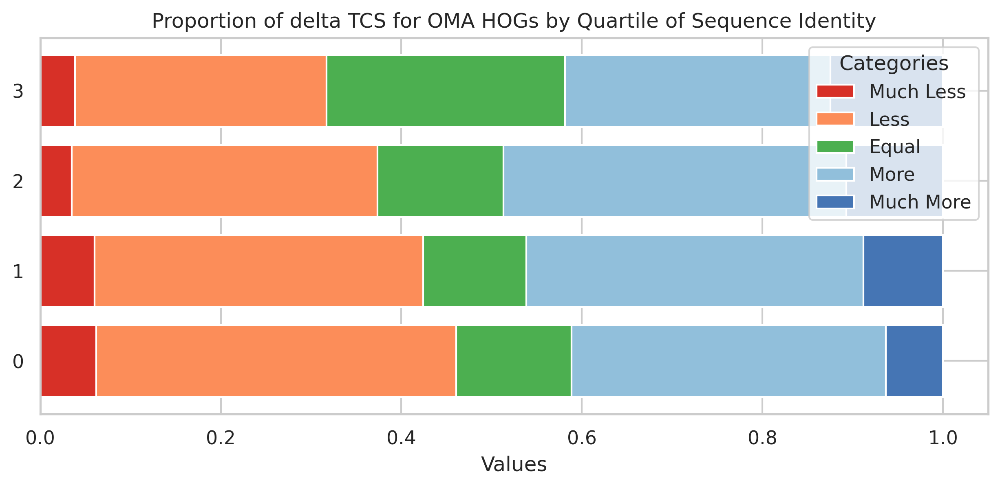

In [214]:
#by alignment quartile for CATH
data = {}
# Define colors
colors = ["#d73027", "#fc8d59", "#4CAF50", "#91bfdb", "#4575b4"]
for q in normalized_copy['aln_mean_quartile'].unique():
    sub = normalized_copy[normalized_copy['aln_mean_quartile'] == q]
    print(q)
    print(sub)
    print(sub.index)
    print(sub.columns)
    if q not in data:
        data[q] = []
    for category in ["Much Less", "Less", "Equal", "More", "Much More"]:
        data[q].append( sub[category].sum() / len(sub) )
    #make sure the sum is 1
    data[q] = [ d / sum(data[q]) for d in data[q] ]

# Plotting the horizontal stacked bar chart
fig, ax = plt.subplots(figsize=(10, 4))
# Cumulative sum to stack the bars

bottoms = np.zeros(len(data))
for i, category in enumerate(["Much Less", "Less", "Equal", "More", "Much More"]):
    values = [data[row][i] for row in data]
    ax.barh(list(data.keys()), values, left=bottoms, color=colors[i], label=category)
    bottoms += values
# Adding labels and legend
#set the y axis ticks with the quartile values
ax.set_yticks(list(data.keys()))
#ax.set_yticklabels( ['q1','q2','q3','q4'])
ax.set_xlabel("Values")
ax.set_title("Proportion of delta TCS for OMA HOGs by Quartile of Sequence Identity")
ax.legend(title="Categories")

plt.show()


In [ ]:
# using the clade emergence for OMA

In [136]:
#merge on index
normalized_copy = normalized_copy.merge( OMA_methodstats , left_index = True , right_index = True )
print(normalized_copy)

Empty DataFrame
Columns: [alntmscore_1_exp_struct_tree_norm, lddt_1_exp_struct_tree_norm, fident_1_exp_struct_tree_norm, sequences.aln.muscle.fst.treefile.rooted_norm, 3di_xaln_tree_norm, alnAA_3di.fasta.treefile.rooted.final_norm, AA_xaln_tree_norm, templateX3di.nx.treefile.rooted.final_norm, templateXAA.nx.treefile.rooted.final_norm, struct, seq, dist, ML, mean_alnfident_dist_1_raw_.json, var_alnfident_dist_1_raw_.json, skewness_alnfident_dist_1_raw_.json, kurtosis_alnfident_dist_1_raw_.json, mean_alnfident_dist_3di_AA.json, var_alnfident_dist_3di_AA.json, skewness_alnfident_dist_3di_AA.json, kurtosis_alnfident_dist_3di_AA.json, mean_alnfident_dist_AA_AA.json, var_alnfident_dist_AA_AA.json, skewness_alnfident_dist_AA_AA.json, kurtosis_alnfident_dist_AA_AA.json, mean_alnfident_dist_0_raw_.json, var_alnfident_dist_0_raw_.json, skewness_alnfident_dist_0_raw_.json, kurtosis_alnfident_dist_0_raw_.json, mean_alnfident_dist_3di_3di.json, var_alnfident_dist_3di_3di.json, skewness_alnfident_d

In [137]:
#OMA_treestats.to_pickle('OMA_treestats.pkl')

In [138]:
OMA_treestats = pd.read_pickle('OMA_treestats.pkl')

In [139]:
CATH_treestats = pd.read_pickle( 'CATH_treestats.pkl')
print(CATH_treestats.head())

                                   alntmscore_0_raw_struct_tree.PP.nwk.rooted  \
../CATH_data/2.30.29.30/    [216, [0.47666858353572567, 1.667064076997762]...   
../CATH_data/3.40.109.10/   [59, [0.5411534138398703, 1.9417131857414265],...   
../CATH_data/3.30.1520.10/  [31, [0.5187117906731114, 1.55430361790874], 1...   
../CATH_data/3.40.718.10/   [58, [0.8228433875335005, 1.1440694969241536],...   
../CATH_data/3.30.43.10/    [40, [0.45484488371368825, 1.4888613270737587]...   

                                   alntmscore_0_exp_struct_tree.PP.nwk.rooted  \
../CATH_data/2.30.29.30/    [216, [0.3017819115008184, 2.277431076856519],...   
../CATH_data/3.40.109.10/   [59, [0.46791962564999307, 2.2892072578872433]...   
../CATH_data/3.30.1520.10/  [31, [0.48361246296438926, 2.246351168935552],...   
../CATH_data/3.40.718.10/   [58, [0.7720187807928145, 1.245420876319261], ...   
../CATH_data/3.30.43.10/    [40, [0.45231165073185553, 1.6462715864595234]...   

                          

In [140]:
metrics = 'nobsint,minmax,mean,variance,skewness,kurtosis'
import matplotlib.pyplot as plt

def add_variance(OMA_treestats):
    cols = []
    for c in OMA_treestats.columns:
        if 'nseqs' not in c and 'var' not in c and '0' not in c: #and 'exp' not in c:
            OMA_treestats[c+'var'] = OMA_treestats[c].map( lambda x : x[3]  if type(x) == list else None )
            cols.append(c+'var')
    return OMA_treestats

OMA_treestats = add_variance(OMA_treestats)
CATH_treestats = add_variance(CATH_treestats)

['alntmscore_0_raw_struct_tree.PP.nwk.rooted', 'alntmscore_0_exp_struct_tree.PP.nwk.rooted', 'alntmscore_1_exp_struct_tree.PP.nwk.rooted', 'fident_0_raw_struct_tree.PP.nwk.rooted', 'lddt_0_exp_struct_tree.PP.nwk.rooted', 'lddt_1_exp_struct_tree.PP.nwk.rooted', 'fident_0_exp_struct_tree.PP.nwk.rooted', 'lddt_1_raw_struct_tree.PP.nwk.rooted', 'fident_1_raw_struct_tree.PP.nwk.rooted', 'fident_1_exp_struct_tree.PP.nwk.rooted', 'alntmscore_1_raw_struct_tree.PP.nwk.rooted', 'lddt_0_raw_struct_tree.PP.nwk.rooted', 'sequences.aln.muscle.fst.nwk.rooted', 'sequences.aln.muscle.fst.treefile.rooted', '3di_xaln_tree.PP.nwk.rooted', 'alnAA_3di.fasta.treefile.rooted.final', 'AA_xaln_tree.PP.nwk.rooted', 'templateX3di.nx.treefile.rooted.final', 'templateXfoldtree.nx.treefile.rooted.final', 'templateXAA.nx.treefile.rooted.final', 'nseqs', 'sequences.aln.fst.treefile.rooted', 'sequences.aln.fst.nwk.rooted', 'alntmscore_1_exp_struct_tree.PP.nwk.rootedvar', 'lddt_1_exp_struct_tree.PP.nwk.rootedvar', 'lddt

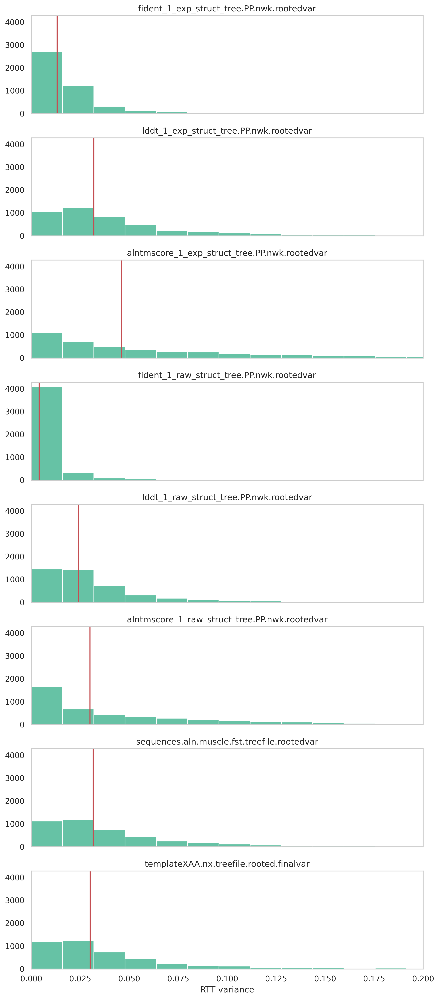

['alntmscore_0_raw_struct_tree.PP.nwk.rooted', 'alntmscore_0_exp_struct_tree.PP.nwk.rooted', 'alntmscore_1_exp_struct_tree.PP.nwk.rooted', 'fident_0_raw_struct_tree.PP.nwk.rooted', 'lddt_0_exp_struct_tree.PP.nwk.rooted', 'lddt_1_exp_struct_tree.PP.nwk.rooted', 'fident_0_exp_struct_tree.PP.nwk.rooted', 'lddt_1_raw_struct_tree.PP.nwk.rooted', 'fident_1_raw_struct_tree.PP.nwk.rooted', 'fident_1_exp_struct_tree.PP.nwk.rooted', 'alntmscore_1_raw_struct_tree.PP.nwk.rooted', 'lddt_0_raw_struct_tree.PP.nwk.rooted', 'sequences.aln.fst.nwk.rooted', '3di_xaln_tree.PP.nwk.rooted', 'AA_xaln_tree.PP.nwk.rooted', 'templateXfoldtree.nx.treefile.rooted.final', 'nseqs', 'sequences.aln.muscle.fst.nwk.rooted', 'sequences.aln.fst.treefile.rooted', 'sequences.aln.muscle.fst.treefile.rooted', 'templateX3di.nx.treefile.rooted.final', 'templateXAA.nx.treefile.rooted.final', 'alntmscore_1_exp_struct_tree.PP.nwk.rootedvar', 'lddt_1_exp_struct_tree.PP.nwk.rootedvar', 'lddt_1_raw_struct_tree.PP.nwk.rootedvar', 'fi

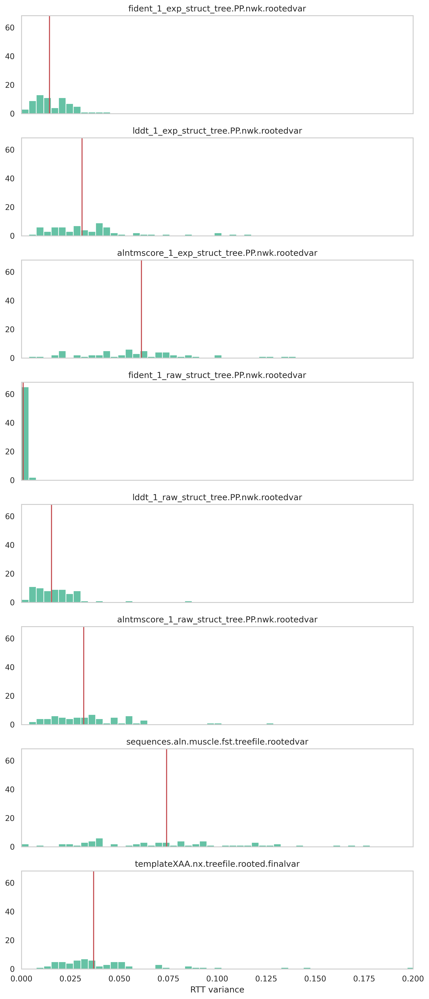

In [141]:
for label, treestats_df in [('oma',OMA_treestats) , ('cath',CATH_treestats)]:
    cols = ['fident_1_exp_struct_tree.PP.nwk.rootedvar' , 'lddt_1_exp_struct_tree.PP.nwk.rootedvar', 'alntmscore_1_exp_struct_tree.PP.nwk.rootedvar', 'fident_1_raw_struct_tree.PP.nwk.rootedvar'  , 'lddt_1_raw_struct_tree.PP.nwk.rootedvar', 'alntmscore_1_raw_struct_tree.PP.nwk.rootedvar', 'sequences.aln.muscle.fst.treefile.rootedvar'  , 'templateXAA.nx.treefile.rooted.finalvar' ]
    
    print(list(treestats_df.columns ) ) 
    
    fig, axs = plt.subplots(len(cols), 1, sharex=True,sharey=True, tight_layout=True , figsize = (10,20))
    df = treestats_df[cols]
    df = df.dropna()
    
    bins=np.histogram(df, bins=500)[1] #get the bin edges
    for i,col in enumerate(cols):
        data = df[col] 
        #data[data>.25]= .25
        axs[i].set_box_aspect(.25)
        
        axs[i].set_xlim(0,.20)
        axs[i].hist( df[col] , bins=bins)
        axs[i].axvline(x = np.median(df[col]), color = 'r', label = str(np.median(df[col])))
        axs[i].grid(False)
        
        axs[i].set_title(col)
        if i == len(cols)-1:
            axs[i].set_xlabel('RTT variance')
        #axs[i].set_ylabel('n Trees')
    
    plt.savefig('../figures/'+label+'ultrametricity_hist_all_wraw.svg')
    plt.show()


In [142]:
def add_variance(OMA_treestats):
    cols = []
    for c in OMA_treestats.columns:
        if 'nseqs' not in c and 'var' not in c and '0' not in c: #and 'exp' not in c:
            OMA_treestats[c+'var'] = OMA_treestats[c].map( lambda x : x[3]  if type(x) == list else None )
            cols.append(c+'var')
    return OMA_treestats

CATH_treestats = add_variance(CATH_treestats)

<Figure size 3000x900 with 0 Axes>

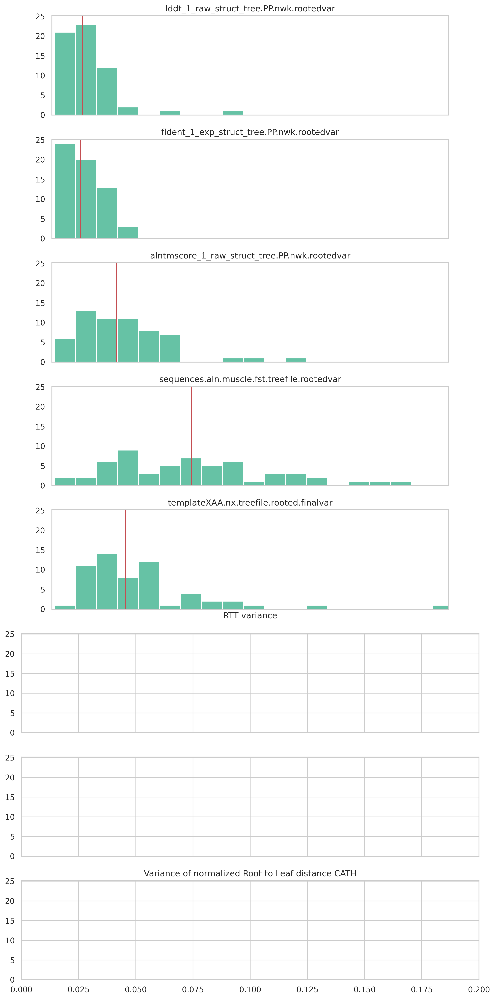

In [143]:
metrics = 'nobsint,minmax,mean,variance,skewness,kurtosis'
import matplotlib.pyplot as plt
plt.figure(figsize=(10,3))
CATH_treestats = CATH_treestats.dropna()
for c in CATH_treestats.columns:
    if 'nseqs' not in c and 'var' not in c and '0' not in c:
        CATH_treestats[c+'var'] = CATH_treestats[c].map( lambda x : x[3] )
        #plt.hist( treestats_df[c+'var'] , alpha = .25 , label = c, density = True , bins = 20)


fig, axs = plt.subplots(len(cols), 1, sharex=True,sharey=True, tight_layout=True , figsize = (10,20))

plt.title( 'Variance of normalized Root to Leaf distance CATH')
#plt.legend()
#plt.show()
cols = ['lddt_1_raw_struct_tree.PP.nwk.rootedvar', 'fident_1_exp_struct_tree.PP.nwk.rootedvar', 'alntmscore_1_raw_struct_tree.PP.nwk.rootedvar', 'sequences.aln.muscle.fst.treefile.rootedvar' ,   'templateXAA.nx.treefile.rooted.finalvar'   ]

df = CATH_treestats[cols]
bins=np.histogram(df, bins=100)[1] #get the bin edges

for i,col in enumerate(cols):
    data = df[col] 
    #data[data>.25]= .25
    axs[i].set_box_aspect(.25)
    axs[i].set_xlim(0,.20)
    axs[i].hist( df[col] , bins=bins)
    axs[i].axvline(x = np.median(df[col]), color = 'r', label = str(np.median(df[col])))
    axs[i].grid(False)
    axs[i].set_title(col)
    if i == len(cols)-1:
        axs[i].set_xlabel('RTT variance')
    #axs[i].set_ylabel('n Trees')
#plt.savefig('../figures/ultrametricity_hist_CATH.svg')
plt.show()



In [144]:
import toytree
import toyplot
import numpy as np
import toyplot.svg

#select random fams
sub = treestats_df.sample(20)


for idx,r in sub.iterrows():
    nwks = glob.glob(idx+'*.rooted')
    trees = []
    kept= []
    for nwk in nwks:
        if 'fident_1_exp' in nwk or 'sequences.aln.muscle.fst.treefile' in nwk or 'templateXAA' in nwk:
            kept.append(nwk)
            trees.append(toytree.tree(nwk , format = 0))
    mtre0 = toytree.mtree( trees )
    for tree in mtre0.treelist:
        for n in tree.treenode.traverse():
            if n.is_leaf():
                n.size = 5
                n.color = 'red'
            else:
                n.size = 0
                n.color = 'black'
        sizes = tree.get_node_values("size", show_root=True, show_tips=True)
        colors = tree.get_node_values("color", show_root=True, show_tips=True)        
        tree.style.node_sizes = sizes
    canvas,axes,mark = mtre0.draw( ncols=len(trees) ,tip_labels=False ,edge_style={"stroke-opacity": 1, "stroke-width": .5}  ,  height=100 , node_colors= 'red')
    '''tip_labels_align=True, edge_align_style={
        "stroke": "violet",
        "stroke-width": 0,
        "stroke-dasharray": "2,5"    # size of dash, spacing of dashes
    } )'''
    print(kept)
    toyplot.svg.render(canvas, '../figures/'+idx.replace('/' , '_').replace('.','')+'treesample.svg')    
print(kept)

['../CATH_data/1.20.840.10/sequences.aln.muscle.fst.treefile.rooted', '../CATH_data/1.20.840.10/fident_1_exp_struct_tree.PP.nwk.rooted']
['../CATH_data/3.90.25.10/sequences.aln.muscle.fst.treefile.rooted', '../CATH_data/3.90.25.10/templateXAA.nx.treefile.rooted', '../CATH_data/3.90.25.10/fident_1_exp_struct_tree.PP.nwk.rooted']


IndexError: list index out of range

In [82]:
#construct structure and sequence feature dataset

import tqdm
import glob
import os
import numpy as np

def ret_description(vec , label = ''):
    return { label+'_mean': np.mean(vec) , label+'_max': np.amax(vec) , label+'_min': np.amin(vec) ,label+'_var': np.var(vec) }

#cladefolders = set(glob.glob( '../OMA_data/*/' ))-set([ '../OMA_data/logs/' ])
cladefolders =  set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' )) - set([ '../OMA_data_unfiltered/OMA_data/logs/' ])
allfolders = cladefolders

dfs = []
print(allfolders)
for clade in allfolders:
    print(clade)
    res = {}
    folders = glob.glob(clade + '*/' )
    #for folder in tqdm.tqdm_notebook(folders):
    for folder in folders:
        if 'logs' not in folder:
            
            nstructs = len(glob.glob(folder+'structs/*.pdb'))
            try:
                with open(folder + 'sequences.fst') as fstin:
                    nseqs = fstin.read().count('>')
            except:
                nseqs = 0
            if nstructs == nseqs:
                if os.path.isfile(folder + 'plddt.json' ) and os.path.isfile(folder + 'sequence_dataset.csv' ):
                    plddt_df = pd.read_json(folder + 'plddt.json').T
                    if len(plddt_df)>0:
                        plddt_df.columns = 'nobs,minmax,mean,variance,skewness,kurtosis'.split(',')
                        plddt_df['min'] = plddt_df.minmax.map( lambda r: r[0] )
                        plddt_df['max'] = plddt_df.minmax.map( lambda r: r[1] )
                        res[folder] = {}
                        for col in ['nobs', 'min' , 'max' , 'mean' , 'variance' , 'skewness' , 'kurtosis' ]:
                            descriptors = ret_description(plddt_df[col] , label = col)
                            for l in descriptors:
                                res[folder][l] = descriptors[l]
                        #add in some descriptors of the taxonomic spread and sequence set
                        
                        seqdf = pd.read_csv(folder+'sequence_dataset.csv' )
                        res[folder]['nprots'] = len(seqdf)
                        cladesets = [ set(l.split(',')) for l in  seqdf['Taxonomic lineage (Ids)'] ]
                        union_all = cladesets[0]
                        intersection_all = cladesets[0]
                        for c in cladesets:
                            union_all = union_all.union(c)
                            intersection_all.intersection(c)
                        res[folder]['n_clades'] = len(union_all)
                        res[folder]['inter_clades'] = len(intersection_all)
                        res[folder]['inter/nc'] =  res[folder]['inter_clades'] /  res[folder]['n_clades'] 
                        res[folder]['nc/np'] = res[folder]['nprots'] / res[folder]['n_clades']
    resdf = pd.DataFrame.from_dict(res, orient = 'index')
    dfs.append(resdf)
seqset_resdf = pd.concat(dfs)


{'../OMA_data_unfiltered/OMA_data/Euteleostomi/', '../OMA_data_unfiltered/OMA_data/Bilateria/', '../OMA_data_unfiltered/OMA_data/Bacteria/', '../OMA_data_unfiltered/OMA_data/Dikarya/', '../OMA_data_unfiltered/OMA_data/LUCA/', '../OMA_data_unfiltered/OMA_data/Eumetazoa/', '../OMA_data_unfiltered/OMA_data/Opisthokonta/', '../OMA_data_unfiltered/OMA_data/Eukaryota/', '../OMA_data_unfiltered/OMA_data/Chordata/', '../OMA_data_unfiltered/OMA_data/Tetrapoda/', '../OMA_data_unfiltered/OMA_data/Fungi/'}
../OMA_data_unfiltered/OMA_data/Euteleostomi/
../OMA_data_unfiltered/OMA_data/Bilateria/
../OMA_data_unfiltered/OMA_data/Bacteria/
../OMA_data_unfiltered/OMA_data/Dikarya/
../OMA_data_unfiltered/OMA_data/LUCA/
../OMA_data_unfiltered/OMA_data/Eumetazoa/
../OMA_data_unfiltered/OMA_data/Opisthokonta/
../OMA_data_unfiltered/OMA_data/Eukaryota/
../OMA_data_unfiltered/OMA_data/Chordata/
../OMA_data_unfiltered/OMA_data/Tetrapoda/
../OMA_data_unfiltered/OMA_data/Fungi/


In [84]:
seqset_resdf.to_pickle('structure_and_sequence_qcmetrics.pkl')

In [85]:
seqset_resdf = pd.read_pickle('structure_and_sequence_qcmetrics.pkl')

In [86]:
#find quartiles of sequence divergence 

for col in ['nobs', 'min' , 'max' , 'mean' , 'variance' , 'skewness' , 'kurtosis' , 'nprots' , 'n_clades' , 'inter_clades' , 'inter/nc' , 'nc/np' ]:
    print(col)
    print(seqset_resdf[col].quantile([.25,.5,.75]))
    #plot the difference between ML and Foldtree

    fig, axs = plt.subplots(1, 1, sharex=True,sharey=True, tight_layout=True , figsize = (10,10))
    

nobs


KeyError: 'nobs'

In [88]:
print( seqset_resdf )

                                                      nobs_mean  nobs_max  \
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...   185.000000       209   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...   698.363636       813   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...  1077.090909      1240   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...  1181.909091      1206   
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...   289.900000       300   
...                                                         ...       ...   
../OMA_data_unfiltered/OMA_data/Fungi/HOG54/         680.166667       936   
../OMA_data_unfiltered/OMA_data/Fungi/HOG42/         463.500000       643   
../OMA_data_unfiltered/OMA_data/Fungi/HOG134/        739.900000       983   
../OMA_data_unfiltered/OMA_data/Fungi/HOG72/        1550.333333      1574   
../OMA_data_unfiltered/OMA_data/Fungi/HOG83/        1489.666667      1536   

                                                    nobs_min      nobs_var 

In [89]:
feature_names = ['nobs_mean', 'nobs_max',
       'nobs_min', 'nobs_var', 'min_mean', 'min_max', 'min_min', 'min_var',
       'max_mean', 'max_max', 'max_min', 'max_var', 'mean_mean', 'mean_max',
       'mean_min', 'mean_var', 'variance_mean', 'variance_max', 'variance_min',
       'variance_var', 'skewness_mean', 'skewness_max', 'skewness_min',
       'skewness_var', 'kurtosis_mean', 'kurtosis_max', 'kurtosis_min',
       'kurtosis_var', 'nprots', 'n_clades', 'inter_clades', 'inter/nc','nc/np'
       ]
seqset_resdf = seqset_resdf[feature_names]

In [90]:
allfoldersdf = pd.read_pickle('alnstats_allfoldersdf.pkl')

In [91]:
import copy 
allfoldersdfcopy = copy.deepcopy( allfoldersdf ) 

In [92]:
#merge w plddt stats
methods = ['alnfident_dist_AA_3di.json'  , 'alnfident_dist_AA_AA.json' , 'alnfident_dist_1_raw_.json' ]
for met in allfoldersdf.aln.unique():
    if met in methods:
        sub = allfoldersdf[allfoldersdf.aln == met ]
        for i in [ 2,3,4,5 ]:
            sub[i] = sub['stats'].map( lambda x : x[i]  )
        sub[[met+'_mean' , met+'_var' , met +'_skewness' , met+'_kurtosis'] ] = sub[[2,3,4,5] ]
        sub = sub[[met+'_mean' , met+'_var' , met +'_skewness' , met+'_kurtosis' , 'fam'] ]
        sub = sub.set_index('fam')
        sub = sub[[met+'_mean' , met+'_var' , met +'_skewness' , met+'_kurtosis' ]]
        seqset_resdf = seqset_resdf.merge( sub , right_index = True , left_index = True , how = 'inner')
        #seqset_resdf = seqset_resdf.drop( 'fam' , axis= 1)

print(list( seqset_resdf.columns ))
print(seqset_resdf)

['nobs_mean', 'nobs_max', 'nobs_min', 'nobs_var', 'min_mean', 'min_max', 'min_min', 'min_var', 'max_mean', 'max_max', 'max_min', 'max_var', 'mean_mean', 'mean_max', 'mean_min', 'mean_var', 'variance_mean', 'variance_max', 'variance_min', 'variance_var', 'skewness_mean', 'skewness_max', 'skewness_min', 'skewness_var', 'kurtosis_mean', 'kurtosis_max', 'kurtosis_min', 'kurtosis_var', 'nprots', 'n_clades', 'inter_clades', 'inter/nc', 'nc/np', 'alnfident_dist_1_raw_.json_mean', 'alnfident_dist_1_raw_.json_var', 'alnfident_dist_1_raw_.json_skewness', 'alnfident_dist_1_raw_.json_kurtosis', 'alnfident_dist_AA_AA.json_mean', 'alnfident_dist_AA_AA.json_var', 'alnfident_dist_AA_AA.json_skewness', 'alnfident_dist_AA_AA.json_kurtosis', 'alnfident_dist_AA_3di.json_mean', 'alnfident_dist_AA_3di.json_var', 'alnfident_dist_AA_3di.json_skewness', 'alnfident_dist_AA_3di.json_kurtosis']
                                                      nobs_mean  nobs_max  \
../OMA_data_unfiltered/OMA_data/Euteleostom

In [93]:
seqset_resdf.to_pickle('alnWstructOMA.pkl')

In [94]:
seqset_resdf['aln fid/ foldtree fid'] =  seqset_resdf['alnfident_dist_AA_AA.json_mean'] / seqset_resdf['alnfident_dist_1_raw_.json_mean']
seqset_resdf['aln fid/  3di fid'] =  seqset_resdf['alnfident_dist_AA_AA.json_mean'] / seqset_resdf['alnfident_dist_AA_3di.json_mean']


                                                            y
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...  16.580645
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO... -13.913043
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...   9.666667
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...   4.270270
../OMA_data_unfiltered/OMA_data/Opisthokonta/HO...  -5.000000
...                                                       ...
../OMA_data_unfiltered/OMA_data/Fungi/HOG77/        -0.400000
../OMA_data_unfiltered/OMA_data/Fungi/HOG101/       -1.307692
../OMA_data_unfiltered/OMA_data/Fungi/HOG127/        0.357143
../OMA_data_unfiltered/OMA_data/Fungi/HOG133/        0.615385
../OMA_data_unfiltered/OMA_data/Fungi/HOG6/          1.250000

[4570 rows x 1 columns]


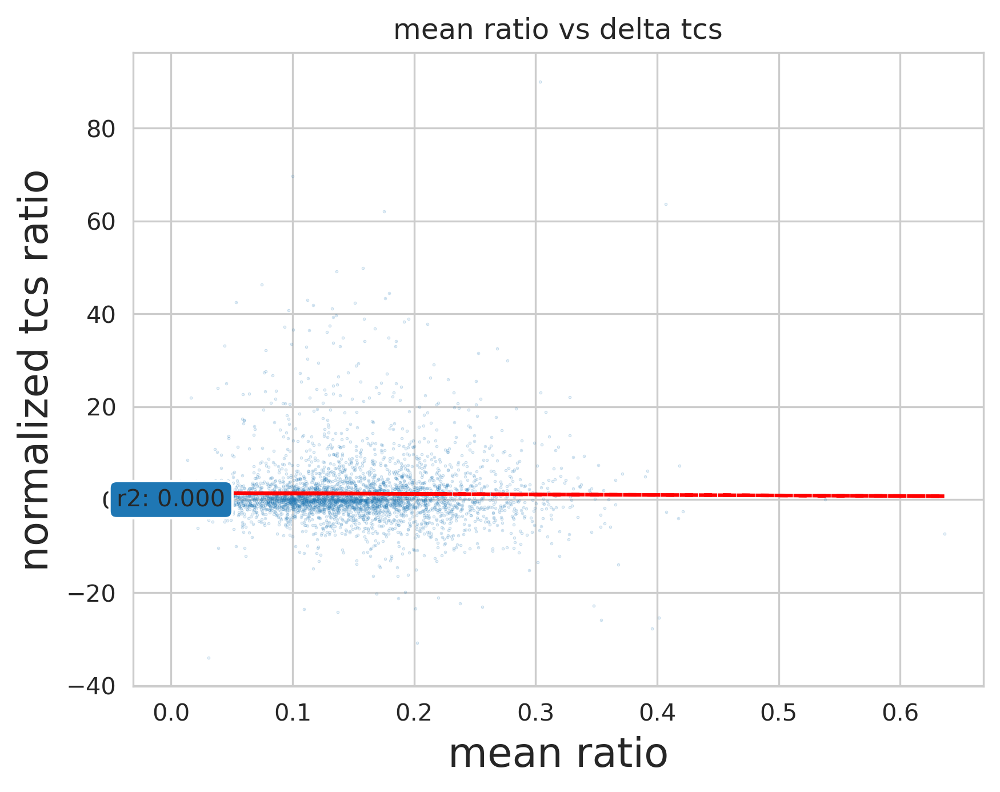

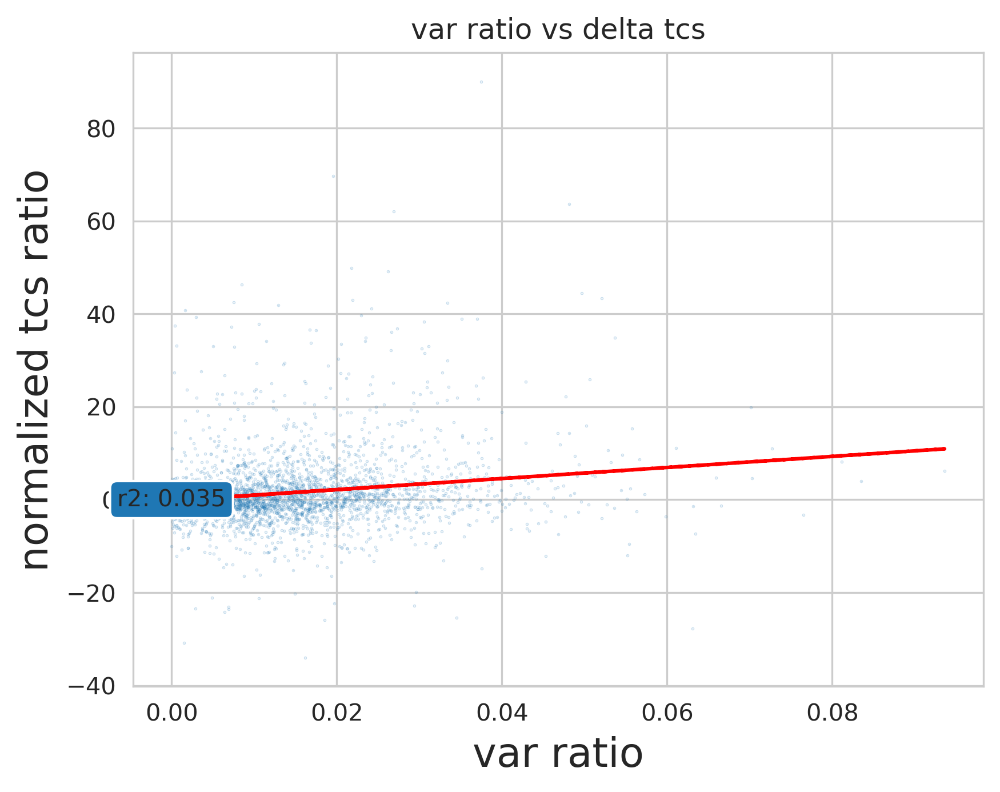

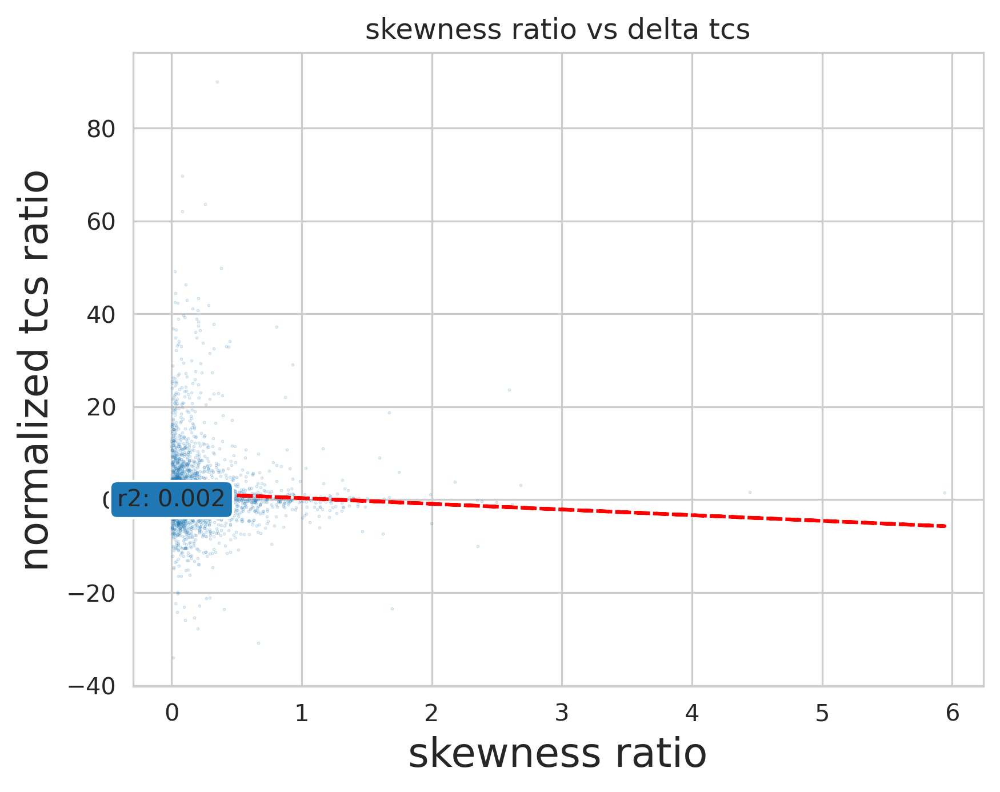

In [95]:
from sklearn.metrics import r2_score


calc_delta = ['fident_1_raw_struct_tree_norm'  , 'sequences.aln.muscle.fst.treefile.rooted_norm'  ] # 'AA_xaln_tree_norm']#
delta_df = pd.DataFrame ( unfiltereddf[ calc_delta[0]] - unfiltereddf[calc_delta[1]] )

delta_df.columns = ['y']
delta_df = delta_df[delta_df.y != 1 ]


print(delta_df.dropna())
delta_df = delta_df[delta_df != 0 ]

#calc mean ratios

a1 = 'alnfident_dist_1_raw_.json_'
a2 = 'alnfident_dist_AA_AA.json_' 

for stat in [ 'mean' , 'var' , 'skewness'   ]:
    
    seqset_resdf = pd.read_pickle('alnWstructOMA.pkl')
    seqset_resdf['stat'] = seqset_resdf[ a1 + stat] - seqset_resdf[a2 + stat ]
    seqset_resdf['stat'] = np.abs(seqset_resdf['stat'] )
    seqset_resdf = seqset_resdf[ seqset_resdf.stat!= 0  ]

    seqset_resdf = seqset_resdf.merge( delta_df , right_index = True , left_index = True , how = 'inner')
    plt.scatter(seqset_resdf['stat'] , seqset_resdf['y'] , alpha = .25 , s = .1)

    seqset_resdf = seqset_resdf[['stat', 'y']].dropna()
    z = np.polyfit(seqset_resdf['stat'], seqset_resdf['y'] , 1)
    p = np.poly1d(z)
    ax = plt.plot(seqset_resdf['stat'],p(seqset_resdf['stat']),"r--")

    plt.ylabel( 'normalized tcs ratio' ,fontsize=17)
    plt.xlabel(stat + ' ratio' ,fontsize=17)
    
    plt.title( stat + ' ratio vs delta tcs' )    
    r2 = r2_score(seqset_resdf['y'],p(seqset_resdf['stat']))
    
    plt.text(0, 0, f"r2: {r2:.3f}" , size=10,
         ha="center", va="center",
         bbox=dict(boxstyle="round" )
         )
    plt.show()
    
#calc var ratios 
#calc skewness ratios

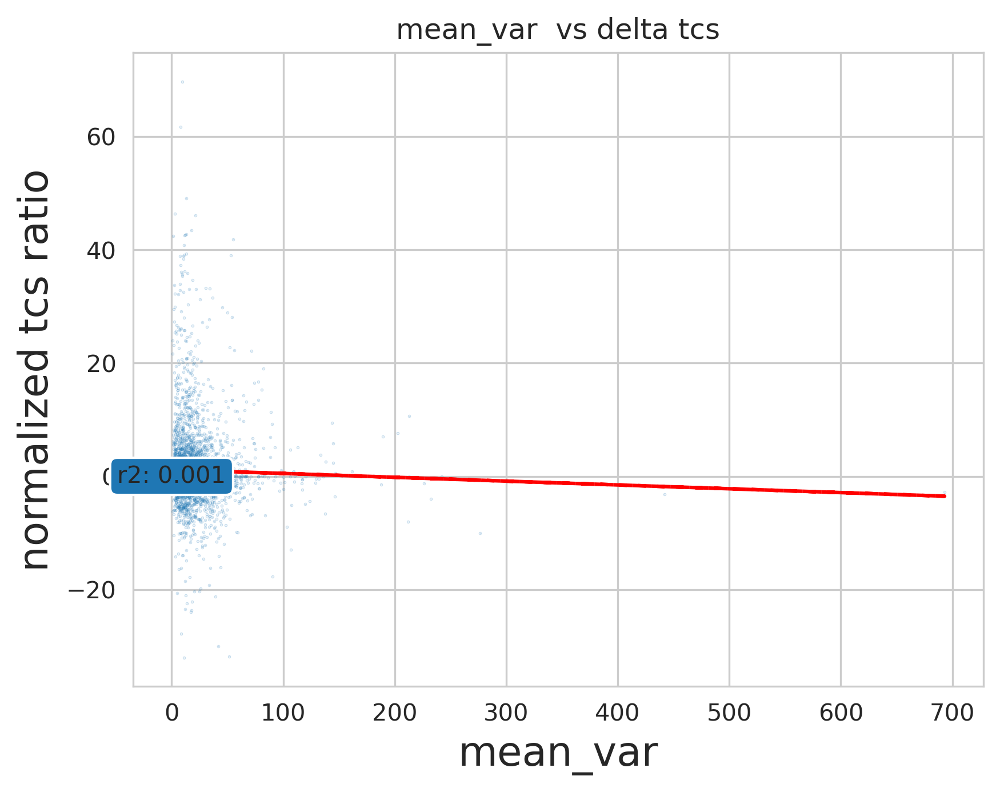

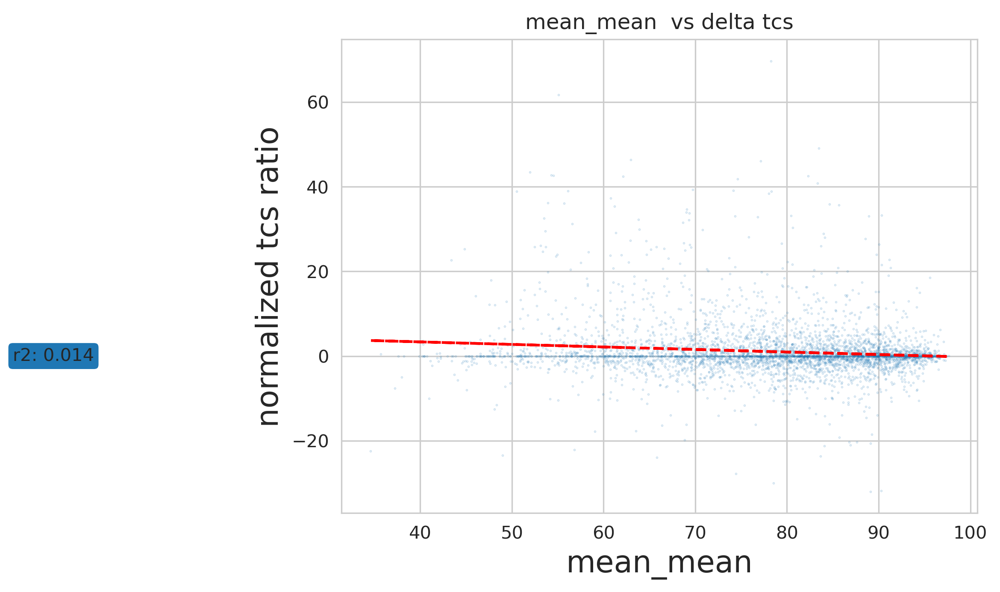

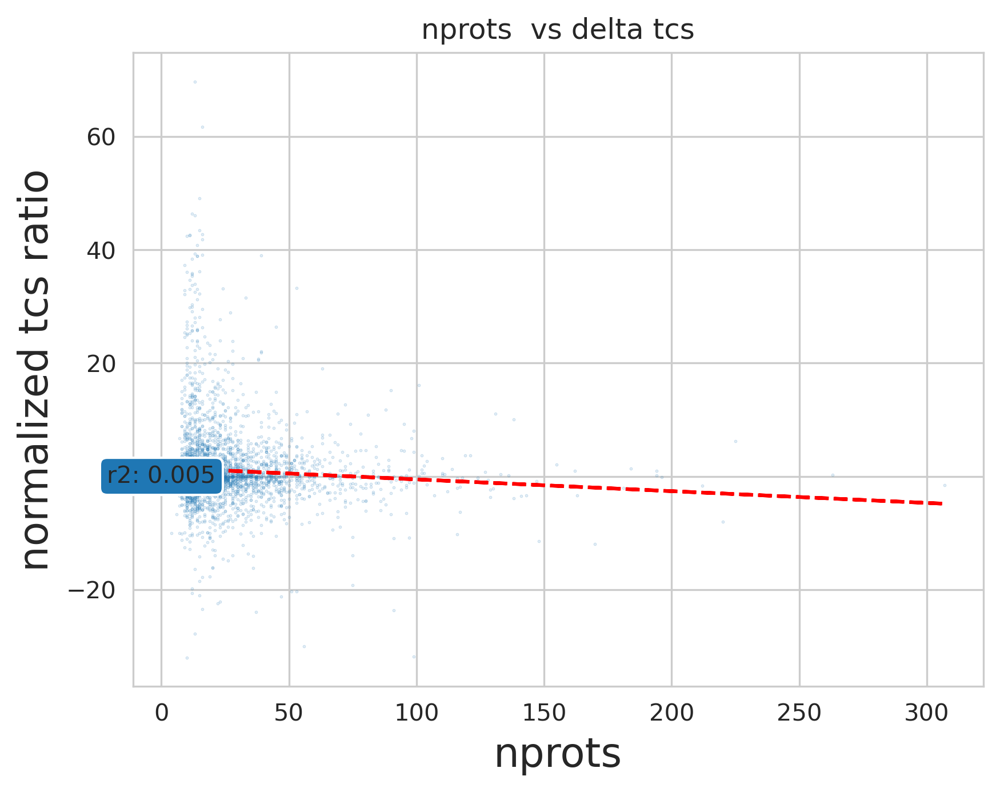

In [96]:

calc_delta = ['fident_1_exp_struct_tree_norm'  , 'sequences.aln.muscle.fst.treefile.rooted_norm'   ]#'AA_xaln_tree_norm']#'sequences.aln.muscle.fst.treefile.rooted_norm'  ]
delta_df = pd.DataFrame ( unfiltereddf[ calc_delta[0]] - unfiltereddf[calc_delta[1]] )

delta_df.columns = ['y']
delta_df = delta_df[delta_df.y != 1 ]


for stat in [ 'mean_var' , 'mean_mean' , 'nprots' ]:
    
    seqset_resdf = pd.read_pickle('alnWstructOMA.pkl')
    seqset_resdf['stat'] = seqset_resdf[ stat] 
    
    
    seqset_resdf = seqset_resdf.merge( delta_df , right_index = True , left_index = True , how = 'inner')
    plt.scatter(seqset_resdf[stat] , seqset_resdf['y'] , alpha = .25 , s = .1)

    seqset_resdf = seqset_resdf[['stat', 'y']].dropna()
    z = np.polyfit(seqset_resdf['stat'], seqset_resdf['y'] , 1)
    p = np.poly1d(z)
    ax = plt.plot(seqset_resdf['stat'],p(seqset_resdf['stat']),"r--")

    plt.ylabel( 'normalized tcs ratio' ,fontsize=17)
    plt.xlabel(stat  ,fontsize=17)
    
    plt.title( stat + '  vs delta tcs' )    
    r2 = r2_score(seqset_resdf['y'],p(seqset_resdf['stat']))
    
    plt.text(0, 0, f"r2: {r2:.3f}" , size=10,
         ha="center", va="center",
         bbox=dict(boxstyle="round" )
         )
    plt.show()
    

In [97]:
seqset_resdf = pd.read_pickle('alnWstructOMA.pkl')

calc_delta = ['fident_1_exp_struct_tree_norm'  , 'sequences.aln.muscle.fst.treefile.rooted_norm'] #'AA_xaln_tree_norm']#'sequences.aln.muscle.fst.treefile.rooted_norm'  ]
delta_df = pd.DataFrame ( unfiltereddf[ calc_delta[0]] - unfiltereddf[calc_delta[1]] )
delta_df.columns = ['y']

seqset_resdf = seqset_resdf.merge( delta_df , left_index = True, right_index = True , how = 'inner' )
seqset_resdf = seqset_resdf.dropna()
print(len( seqset_resdf))
print(seqset_resdf.columns)

4506
Index(['nobs_mean', 'nobs_max', 'nobs_min', 'nobs_var', 'min_mean', 'min_max',
       'min_min', 'min_var', 'max_mean', 'max_max', 'max_min', 'max_var',
       'mean_mean', 'mean_max', 'mean_min', 'mean_var', 'variance_mean',
       'variance_max', 'variance_min', 'variance_var', 'skewness_mean',
       'skewness_max', 'skewness_min', 'skewness_var', 'kurtosis_mean',
       'kurtosis_max', 'kurtosis_min', 'kurtosis_var', 'nprots', 'n_clades',
       'inter_clades', 'inter/nc', 'nc/np', 'alnfident_dist_1_raw_.json_mean',
       'alnfident_dist_1_raw_.json_var', 'alnfident_dist_1_raw_.json_skewness',
       'alnfident_dist_1_raw_.json_kurtosis', 'alnfident_dist_AA_AA.json_mean',
       'alnfident_dist_AA_AA.json_var', 'alnfident_dist_AA_AA.json_skewness',
       'alnfident_dist_AA_AA.json_kurtosis', 'alnfident_dist_AA_3di.json_mean',
       'alnfident_dist_AA_3di.json_var', 'alnfident_dist_AA_3di.json_skewness',
       'alnfident_dist_AA_3di.json_kurtosis', 'y'],
      dtype='object

In [98]:
#try to predict the delta using these features w gradient boosted trees
#try to predict the RF distance as well
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets, ensemble
from sklearn.inspection import permutation_importance

from sklearn.ensemble import GradientBoostingClassifier , GradientBoostingRegressor

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

In [99]:
#'nc/np'
y = seqset_resdf.y
y = y.map( lambda x: 1 if x > 0 else 0 ) 
X = seqset_resdf.drop(['y' ] , axis = 1)#
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.1, random_state=13 , shuffle=True
)

params = {
    "n_estimators": 300,
    "max_depth": 3,
    "min_samples_split": 2,
    "learning_rate": 0.01,
    "loss": "squared_error",
    'random_state':42,
    'n_iter_no_change': 300,
    'tol': 0,
    'validation_fraction':0.1  
}


reg = GradientBoostingRegressor(**params)
reg.fit(X_train, y_train )

mse = mean_squared_error(y_test, reg.predict(X_test))
print("The mean squared error (MSE) on test set: {:.4f}".format(mse))

print(reg.score(X_test, y_test))
print(reg.score(X_train, y_train))

test_score = np.zeros((params["n_estimators"],), dtype=np.float64)
for i, y_pred in enumerate(reg.staged_predict(X_test)):
    test_score[i] = mean_squared_error(y_test, y_pred)


The mean squared error (MSE) on test set: 0.2377
0.041143331441278574
0.11560914508602105


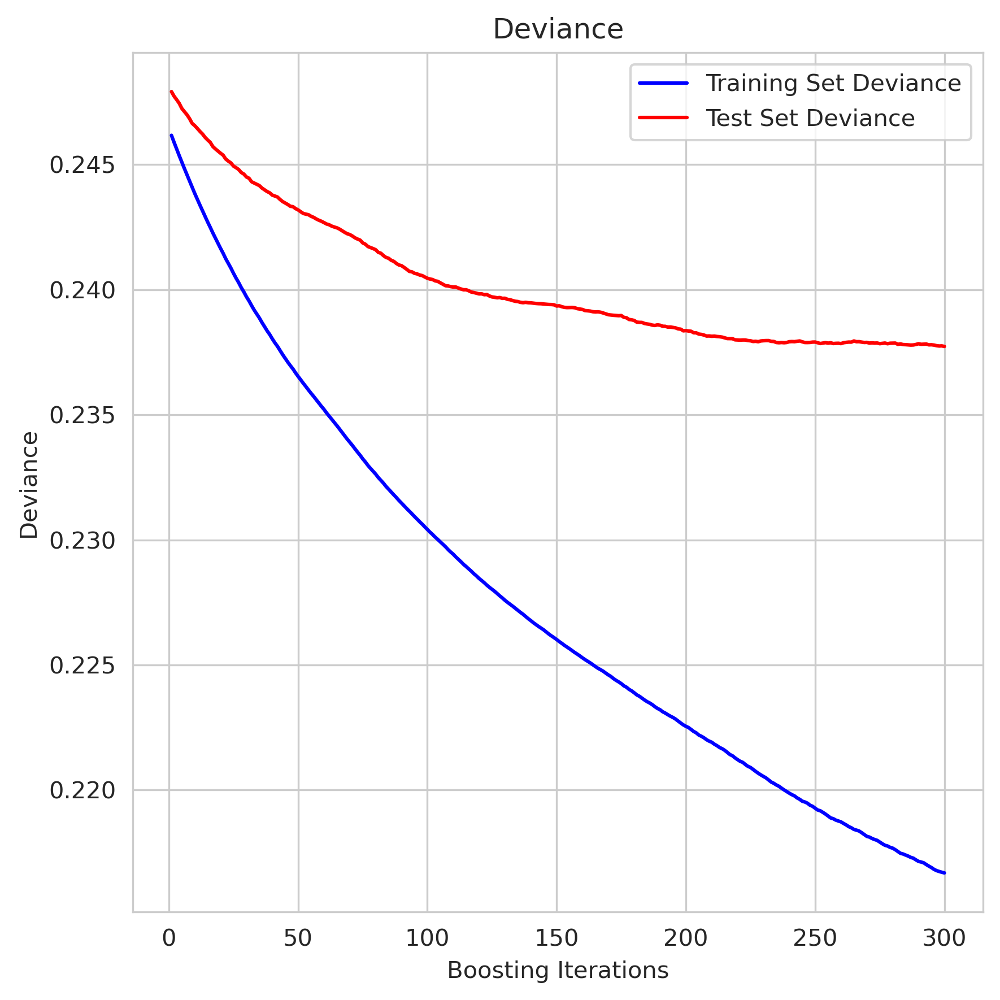

In [100]:
fig = plt.figure(figsize=(6, 6))
plt.subplot(1, 1, 1)
plt.title("Deviance")
plt.plot(
    np.arange(params["n_estimators"]) + 1,
    reg.train_score_,
    "b-",
    label="Training Set Deviance",
)
plt.plot(
    np.arange(params["n_estimators"]) + 1, test_score, "r-", label="Test Set Deviance"
)
plt.legend(loc="upper right")
plt.xlabel("Boosting Iterations")
plt.ylabel("Deviance")
fig.tight_layout()

plt.savefig('../figures/traintest_err.svg')
plt.show()


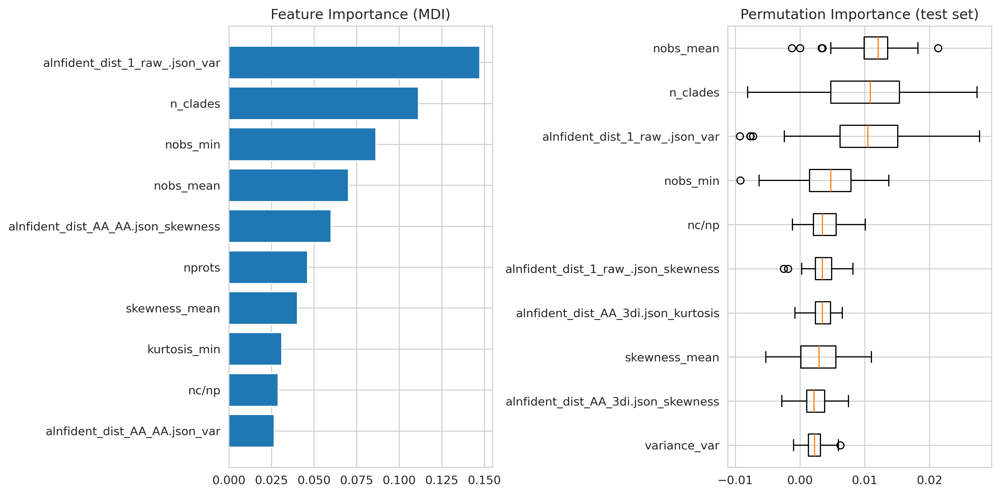

In [101]:

# Calculate feature importance
feature_importance = reg.feature_importances_
sorted_idx = np.argsort(feature_importance)[-10:]  # Select top 10 features
pos = np.arange(sorted_idx.shape[0]) + 0.5

fig = plt.figure(figsize=(12, 6))

# Plot MDI feature importance
plt.subplot(1, 2, 1)
plt.barh(pos, feature_importance[sorted_idx], align="center")
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title("Feature Importance (MDI)")

# Calculate permutation importance
result = permutation_importance(
    reg, X_test, y_test, n_repeats=100, random_state=42, n_jobs=2
)
sorted_idx_perm = result.importances_mean.argsort()[-10:]  # Select top 10 features

# Plot permutation importance
plt.subplot(1, 2, 2)
plt.boxplot(
    result.importances[sorted_idx_perm].T,
    vert=False,
    labels=np.array(X.columns)[sorted_idx_perm],
)

plt.title("Permutation Importance (test set)")
fig.tight_layout()
plt.savefig('../figures/feature_importance.svg')
plt.show()

<Figure size 4500x4500 with 0 Axes>

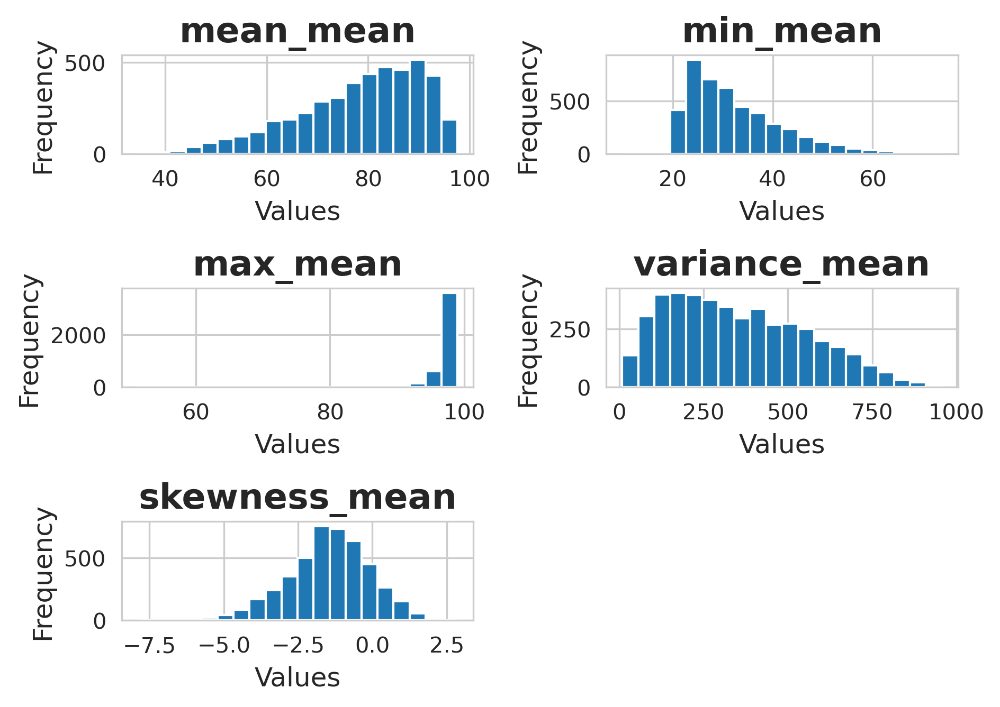

In [102]:
#remove the families with low mean plddt

plt.figure( figsize = (15,15) ) 
ax_list  = seqset_resdf[[ 'mean_mean' , 'min_mean' , 'max_mean' ,  'variance_mean' , 'skewness_mean'] ].hist( bins = 20)


# Set a global title using suptitle

# Loop through each axis in the ax_list to set individual titles and labels
for ax in ax_list.flatten():
    
    ax.set_ylabel('Frequency', fontsize=12)  # Only set y label for the first column
    ax.set_xlabel('Values', fontsize=12)
    ax.set_title(ax.get_title(), fontsize=16, fontweight='bold')

# Adjust layout to prevent overlap
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the rect to leave space for the global title

# Show the plot
plt.show()




In [103]:


#HQstrcutures_OMA = seqset_resdf [ seqset_resdf['nc/np'] < .25]
HQstrcutures_OMA = seqset_resdf 

HQstrcutures_OMA = HQstrcutures_OMA[HQstrcutures_OMA['mean_var'] < 10 ] 
HQstrcutures_OMA = HQstrcutures_OMA[HQstrcutures_OMA['mean_mean'] > 60 ] 


HQstrcutures_OMA = HQstrcutures_OMA.merge( unfiltereddf , left_index =True , right_index = True , how = 'inner') 
print(len(HQstrcutures_OMA))
print(len(unfiltereddf))

1511
4593


Wilcoxon Test Statistic: 263269.0, P-value: 1.4679657121963705e-09
Kolmogorov-Smirnov Test Statistic: 0.028457974851091992, P-value: 0.5735016353973795
Treescore delta statistics
DescribeResult(nobs=1511, minmax=(-40.0, 32.84615384615385), mean=-0.7700324602979497, variance=17.755124223485662, skewness=-1.9261595832064322, kurtosis=17.347231028417745)
total tcs diff -1163.519047510202
[<matplotlib.lines.Line2D object at 0x7f3f38911d90>, <matplotlib.lines.Line2D object at 0x7f3f3848cd10>, <matplotlib.lines.Line2D object at 0x7f3f3848c410>] ['Struct better', 'Seq better', 'Equal']


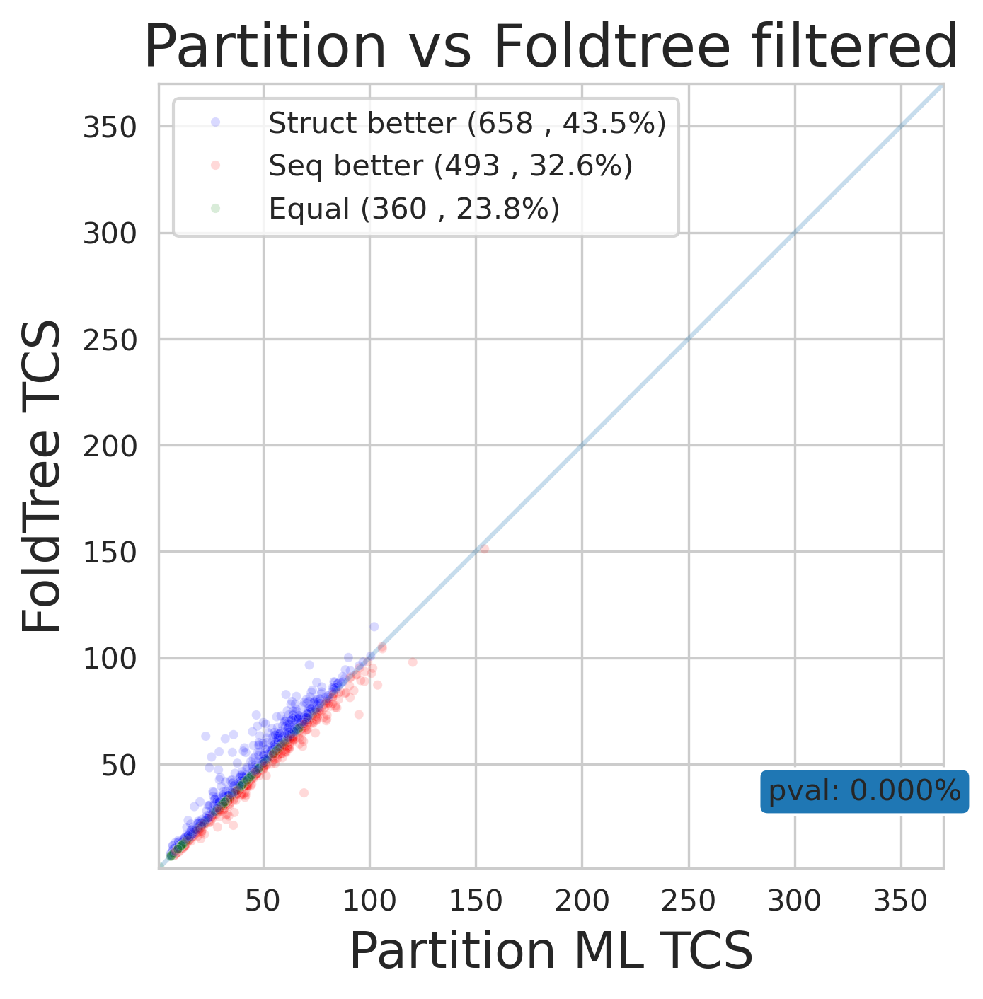

Wilcoxon Test Statistic: 276076.5, P-value: 6.557317239096884e-06
Kolmogorov-Smirnov Test Statistic: 0.037061548643282594, P-value: 0.25056012421041696
Treescore delta statistics
DescribeResult(nobs=1511, minmax=(-69.69230769230768, 27.769230769230766), mean=-1.0065038405213829, variance=31.305185169174237, skewness=-4.110311062205986, kurtosis=30.77728824574252)
total tcs diff -1520.8273030278096
[<matplotlib.lines.Line2D object at 0x7f3f3846d670>, <matplotlib.lines.Line2D object at 0x7f3f3848d970>, <matplotlib.lines.Line2D object at 0x7f3f38517da0>] ['Struct better', 'Seq better', 'Equal']


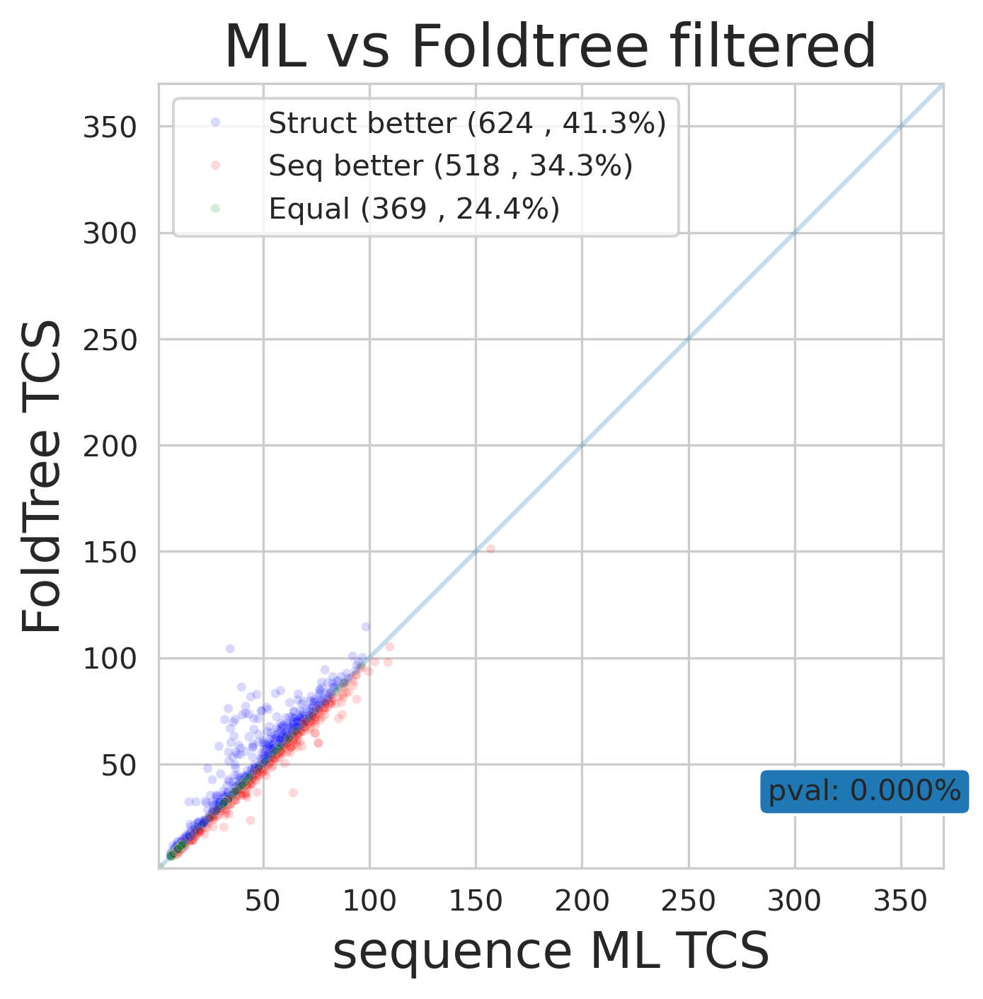

In [104]:
retgraph(  'templateXAA.nx.treefile.rooted.final_norm' , 'fident_1_exp_struct_tree_norm' , HQstrcutures_OMA
         ,'Partition ML TCS' ,  'FoldTree TCS',  'Partition vs Foldtree filtered'  )

retgraph(  'sequences.aln.muscle.fst.treefile.rooted_norm' , 'fident_1_exp_struct_tree_norm' , HQstrcutures_OMA
         ,'sequence ML TCS' ,  'FoldTree TCS',  'ML vs Foldtree filtered'  )

In [105]:
cd /work/FAC/FBM/DBC/cdessim2/default/dmoi/projects/snake_tree/notebooks

/work/FAC/FBM/DBC/cdessim2/default/dmoi/projects/snake_tree/notebooks


In [124]:

import tqdm 
import json
import glob
import pandas as pd

#read the astral results
cladefolders =  set(glob.glob( '../OMA_data_unfiltered/OMA_data/*/' )) - set([ '../OMA_data_unfiltered/OMA_data/logs/' ])
allfolders = cladefolders
dfs = []
print(allfolders)

for clade in allfolders:
    print(clade)
    res = {}
    folders = glob.glob(clade + '*/' )
    #for folder in tqdm.tqdm_notebook(folders):
    for folder in tqdm.tqdm(folders):
        if 'logs' not in folder:
            res[folder] = {}
            
            astralfilename = folder + '*treescore_astral_support.json'
            
            astral_results = glob.glob(astralfilename)
            for a in astral_results:
                with open(a) as f:
                    astral = json.load(f)
                method = a.split('/')[-1]
                astral = { a+'_'+method : astral[a] for a in astral}
                if folder not in res:
                    res[folder] = astral
                else:
                    res[folder].update(astral)
    df = pd.DataFrame.from_dict(res , orient = 'index') 
    #astral_resdf = pd.DataFrame.from_dict(res)
    dfs.append(df)
astral_resdf = pd.concat(dfs)
astral_resdf['family'] = astral_resdf.index.map(lambda x: x.split('/')[-1])
astral_resdf.to_pickle('astral_resdf.pkl')

{'../OMA_data_unfiltered/OMA_data/Dikarya/', '../OMA_data_unfiltered/OMA_data/Bilateria/', '../OMA_data_unfiltered/OMA_data/Chordata/', '../OMA_data_unfiltered/OMA_data/LUCA/', '../OMA_data_unfiltered/OMA_data/Eukaryota/', '../OMA_data_unfiltered/OMA_data/Opisthokonta/', '../OMA_data_unfiltered/OMA_data/Fungi/', '../OMA_data_unfiltered/OMA_data/Tetrapoda/', '../OMA_data_unfiltered/OMA_data/Eumetazoa/', '../OMA_data_unfiltered/OMA_data/Bacteria/', '../OMA_data_unfiltered/OMA_data/Euteleostomi/'}
../OMA_data_unfiltered/OMA_data/Dikarya/


100%|██████████| 187/187 [00:04<00:00, 37.98it/s]


../OMA_data_unfiltered/OMA_data/Bilateria/


100%|██████████| 501/501 [00:23<00:00, 20.93it/s]


../OMA_data_unfiltered/OMA_data/Chordata/


100%|██████████| 501/501 [00:20<00:00, 24.66it/s]


../OMA_data_unfiltered/OMA_data/LUCA/


100%|██████████| 501/501 [00:24<00:00, 20.87it/s]


../OMA_data_unfiltered/OMA_data/Eukaryota/


100%|██████████| 501/501 [00:09<00:00, 53.12it/s]


../OMA_data_unfiltered/OMA_data/Opisthokonta/


100%|██████████| 501/501 [00:22<00:00, 22.61it/s]


../OMA_data_unfiltered/OMA_data/Fungi/


100%|██████████| 139/139 [00:05<00:00, 24.27it/s]


../OMA_data_unfiltered/OMA_data/Tetrapoda/


100%|██████████| 360/360 [00:14<00:00, 25.04it/s]


../OMA_data_unfiltered/OMA_data/Eumetazoa/


100%|██████████| 501/501 [00:03<00:00, 139.45it/s]


../OMA_data_unfiltered/OMA_data/Bacteria/


100%|██████████| 501/501 [00:24<00:00, 20.17it/s]


../OMA_data_unfiltered/OMA_data/Euteleostomi/


100%|██████████| 501/501 [00:20<00:00, 24.37it/s]


In [145]:
print(astral_resdf)

                                                    mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json  \
../OMA_data_unfiltered/OMA_data/Dikarya/HOG33/                                               0.325916                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG59/                                               0.333333                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG123/                                              0.333333                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG185/                                              0.281495                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG20/                                               0.333333                         
...                                                                                               ...                         
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...                                           0.422650          

                                                    mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json  \
../OMA_data_unfiltered/OMA_data/Dikarya/HOG33/                                               0.325916                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG59/                                               0.333333                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG123/                                              0.333333                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG185/                                              0.281495                         
../OMA_data_unfiltered/OMA_data/Dikarya/HOG20/                                               0.333333                         
...                                                                                               ...                         
../OMA_data_unfiltered/OMA_data/Euteleostomi/HO...                                           0.422650          

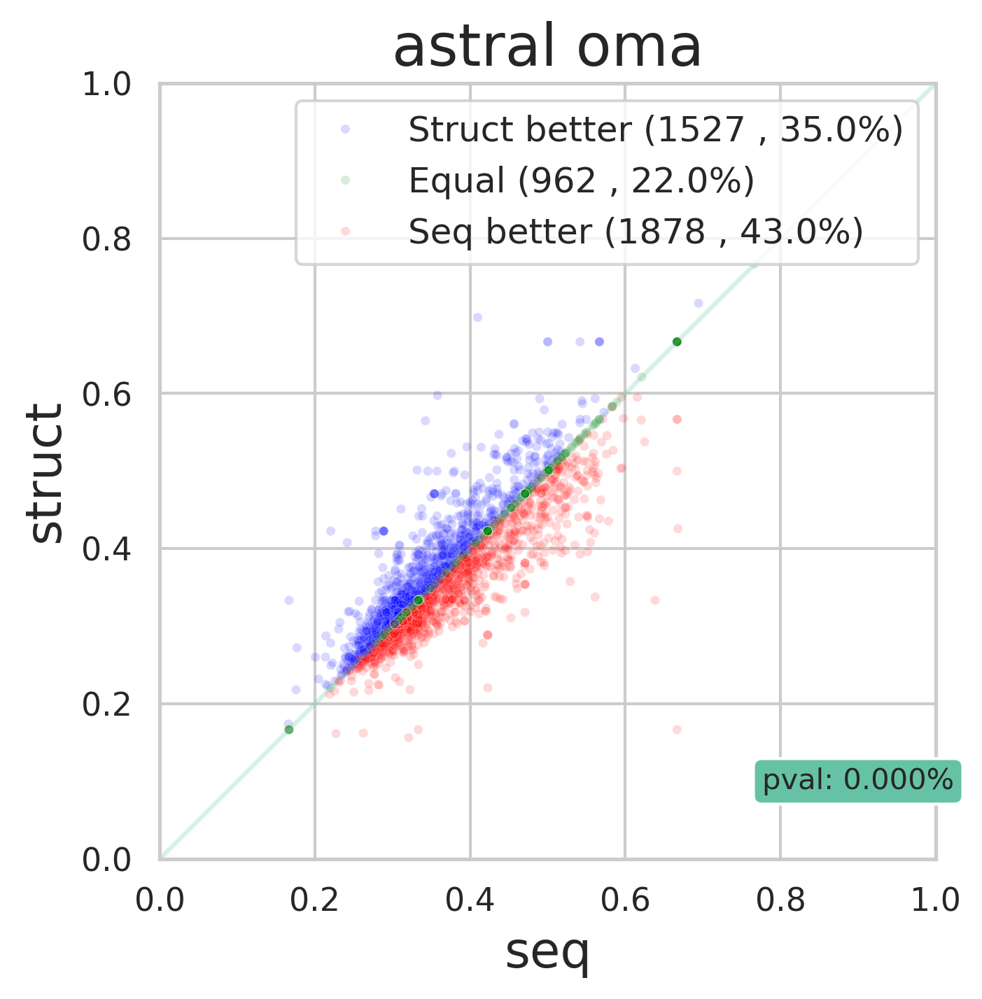

Wilcoxon Test Statistic: 2802101.5, P-value: 0.050585426514985314
Kolmogorov-Smirnov Test Statistic: 0.019885714285714284, P-value: 0.352605414166819
Treescore delta statistics
DescribeResult(nobs=4375, minmax=(-0.3333333333333333, 0.5), mean=1.7878608717505682e-05, variance=0.0010891340427599057, skewness=0.20006825878464893, kurtosis=23.647076316151438)
total tcs diff 0.07821891313908735
[<matplotlib.lines.Line2D object at 0x7fb8fd5e4d40>, <matplotlib.lines.Line2D object at 0x7fb8fd5e7530>, <matplotlib.lines.Line2D object at 0x7fb8fc2b6db0>] ['Struct better', 'Equal', 'Seq better']


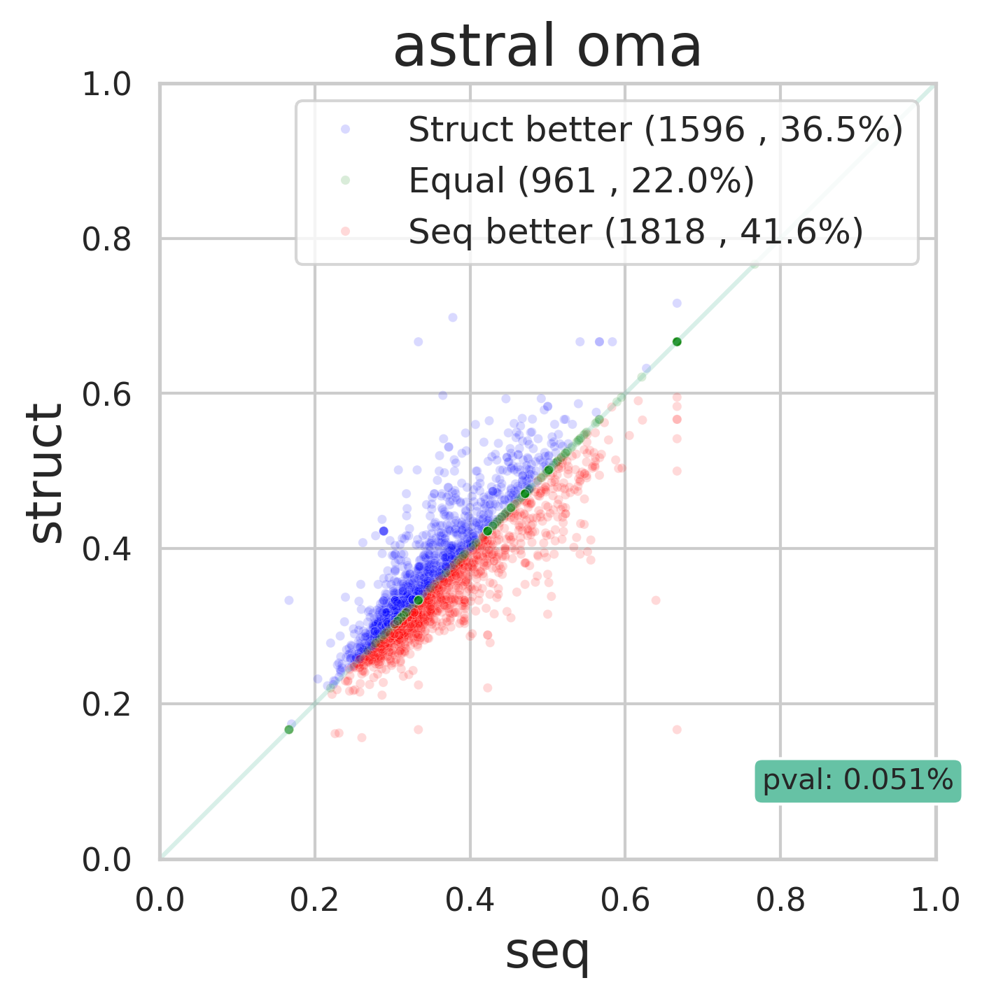

Wilcoxon Test Statistic: 2417941.0, P-value: 0.0011207487713979021
Kolmogorov-Smirnov Test Statistic: 0.017853055619134812, P-value: 0.48932172072965513
Treescore delta statistics
DescribeResult(nobs=4369, minmax=(-0.5, 0.3457219), mean=0.001737407555084114, variance=0.0009953078368790233, skewness=0.001523994171274112, kurtosis=30.016258668420534)
total tcs diff 7.590733608162494
[<matplotlib.lines.Line2D object at 0x7fb8fc2bc470>, <matplotlib.lines.Line2D object at 0x7fb8fef17920>, <matplotlib.lines.Line2D object at 0x7fb8fef163c0>] ['Seq better', 'Struct better', 'Equal']


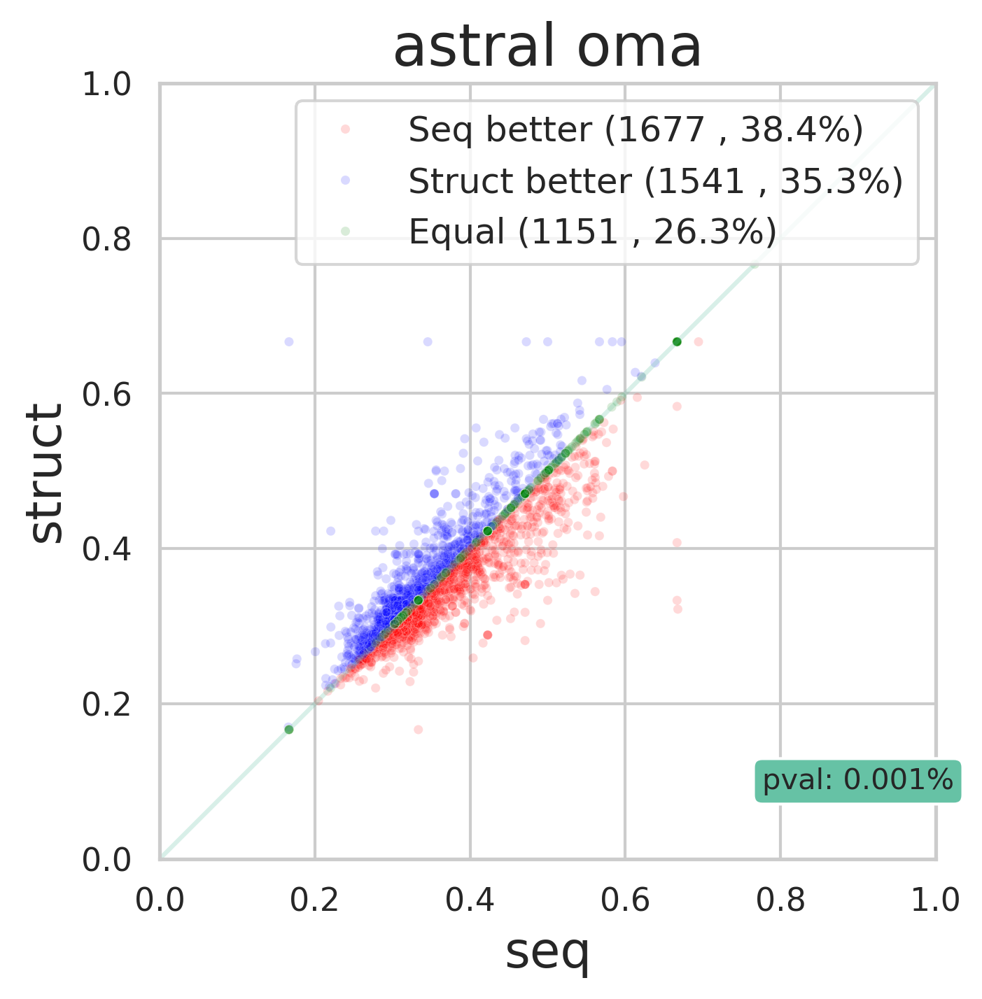

In [146]:
print(astral_resdf)

retgraph(s2= 'mean_fident_1_exp_struct_tree.PP.nwk.rooted.treescore_astral_support.json' , 
         s1= 'mean_sequences.aln.muscle.fst.treefile.rooted.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral oma' , cutoff = 0 , min_axlim= 0 , axlim = 1 )


retgraph(s2= 'mean_fident_1_exp_struct_tree.PP.nwk.rooted.treescore_astral_support.json' , 
         s1= 'mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral oma' , cutoff = 0 , min_axlim= 0 , axlim = 1 )


retgraph(s2= 'mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json' , 
         s1= 'mean_sequences.aln.muscle.fst.treefile.rooted.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral oma' , cutoff = 0 , min_axlim= 0 , axlim = 1 )

Wilcoxon Test Statistic: 273544.0, P-value: 1.1498281063724597e-07
Kolmogorov-Smirnov Test Statistic: 0.005266773528738264, P-value: 0.9999999857110243
Treescore delta statistics
DescribeResult(nobs=4367, minmax=(-220.0, 291.0), mean=-0.05335470574765285, variance=66.1352653123135, skewness=12.09136868071432, kurtosis=817.4233924935315)
total tcs diff -233.0
[<matplotlib.lines.Line2D object at 0x7fb8fc375e20>, <matplotlib.lines.Line2D object at 0x7fb8fc3744a0>, <matplotlib.lines.Line2D object at 0x7fb8fc3748c0>] ['Struct better', 'Equal', 'Seq better']


FileNotFoundError: [Errno 2] No such file or directory: '../figures/astral_oma_dup/loss.svg'

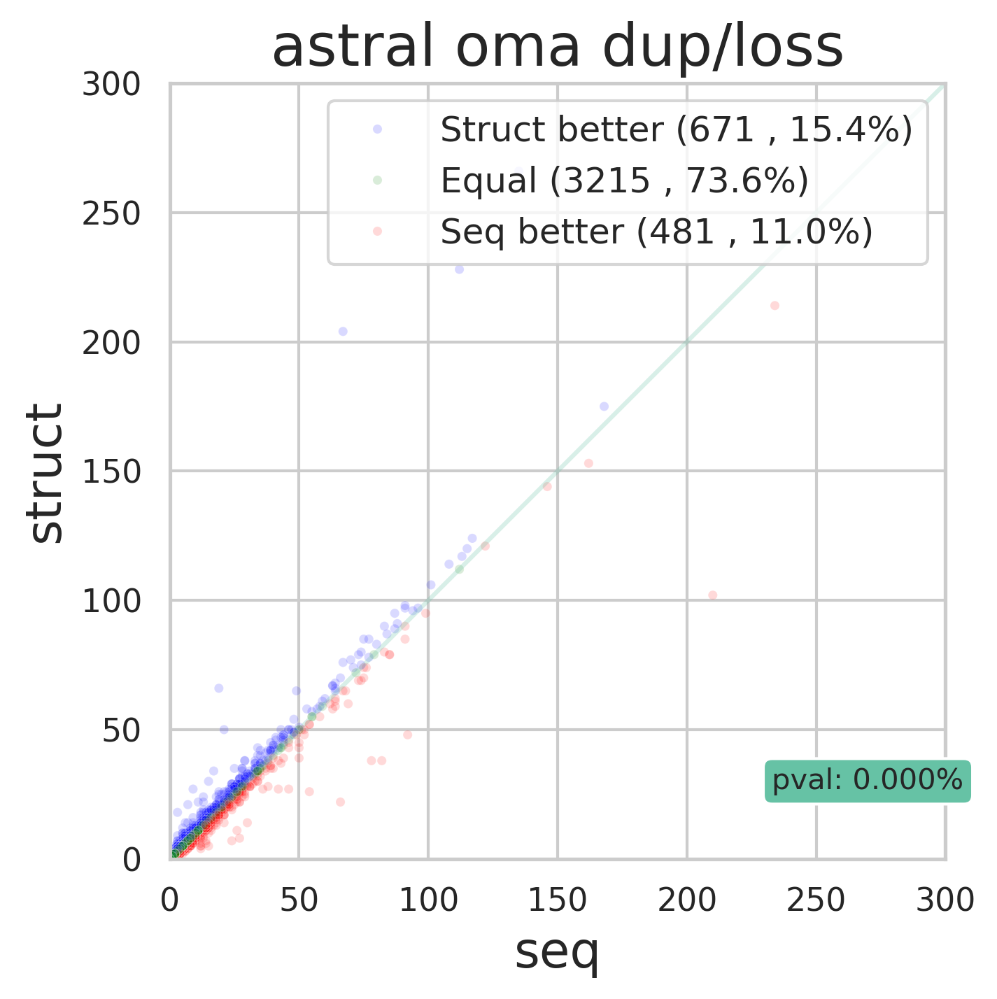

In [147]:

retgraph(s2= 'duploss_fident_1_exp_struct_tree.PP.nwk.rooted.treescore_astral_support.json' , 
         s1= 'duploss_sequences.aln.muscle.fst.treefile.rooted.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral oma dup/loss' , cutoff = 0 , min_axlim= 0 , axlim = 300 )


retgraph(s2= 'duploss_fident_1_exp_struct_tree.PP.nwk.rooted.treescore_astral_support.json' , 
         s1= 'duploss_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral oma dup/loss' , cutoff = 0 , min_axlim= 0 , axlim = 300 )


retgraph(s2= 'duploss_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json' , 
         s1= 'duploss_sequences.aln.muscle.fst.treefile.rooted.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral oma dup/loss' , cutoff = 0 , min_axlim= 0 , axlim = 300 )

In [108]:

#read the astral results
folder =  '/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_dataset/CATH_data_mk4_genus/'
dfs = []
print(clade)
res = {}
folders = glob.glob(folder + '*/' )
#for folder in tqdm.tqdm_notebook(folders):
for folder in tqdm.tqdm(folders):
    if 'logs' not in folder:
        res[folder] = {}
        astralfilename = folder + '*treescore_astral_support.json'
        astral_results = glob.glob(astralfilename)
        for a in astral_results:
                with open(a) as f:
                    astral = json.load(f)
                method = a.split('/')[-1]
                astral = { a+'_'+method : astral[a] for a in astral}
                if folder not in res:
                    res[folder] = astral
                else:
                    res[folder].update(astral)
df = pd.DataFrame.from_dict(res , orient = 'index') 
print(df)
astral_resdf = df
astral_resdf.to_pickle('astral_resdf_cath.pkl')

../OMA_data_unfiltered/OMA_data/Fungi/


100%|██████████| 489/489 [00:27<00:00, 17.96it/s]

                                                    mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json  \
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.330678                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.330385                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.321764                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.470846                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.390893                         
...                                                                                               ...                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.367061          

                                                    mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json  \
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.330678                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.330385                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.321764                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.470846                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.390893                         
...                                                                                               ...                         
/work/FAC/FBM/DBC/cdessim2/urmetazoa/CATH_datas...                                           0.367061          

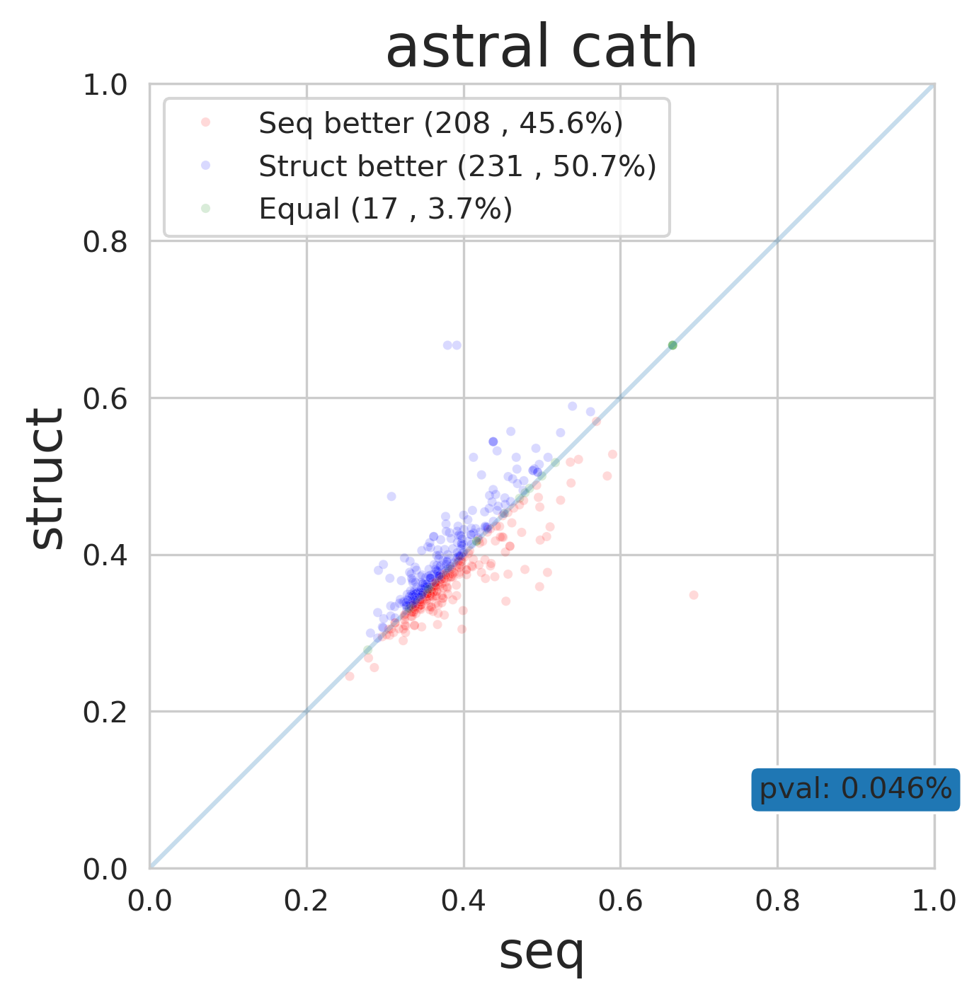

Wilcoxon Test Statistic: 48753.0, P-value: 0.9411120074261377
Kolmogorov-Smirnov Test Statistic: 0.03260869565217391, P-value: 0.9676248591287838
Treescore delta statistics
DescribeResult(nobs=460, minmax=(-0.2, 0.11810572727272717), mean=-0.0008793233156309508, variance=0.0009905796756774813, skewness=-0.8237150685638394, kurtosis=6.290601422530116)
total tcs diff -0.4044887251902374
[<matplotlib.lines.Line2D object at 0x7f3f385910a0>, <matplotlib.lines.Line2D object at 0x7f3f38591b80>, <matplotlib.lines.Line2D object at 0x7f3f38591d90>] ['Struct better', 'Seq better', 'Equal']


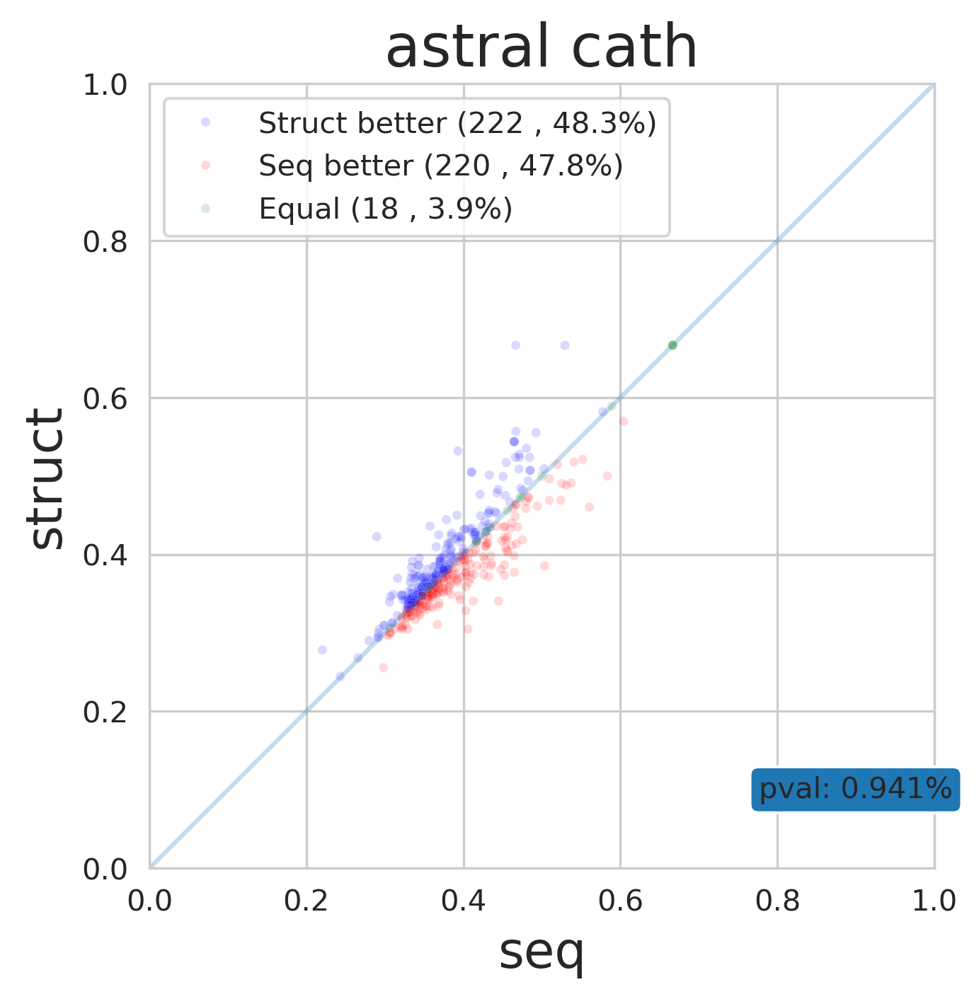

Wilcoxon Test Statistic: 44778.5, P-value: 0.18676259101252024
Kolmogorov-Smirnov Test Statistic: 0.05470459518599562, P-value: 0.5014742425682192
Treescore delta statistics
DescribeResult(nobs=457, minmax=(-0.28678300000000007, 0.34190102777777776), mean=-0.0018815081060389945, variance=0.0014096208680201099, skewness=1.1021263472284546, kurtosis=26.856221099869853)
total tcs diff -0.8598492044598205
[<matplotlib.lines.Line2D object at 0x7f3f38590230>, <matplotlib.lines.Line2D object at 0x7f3f49449610>, <matplotlib.lines.Line2D object at 0x7f3f385fb320>] ['Seq better', 'Struct better', 'Equal']


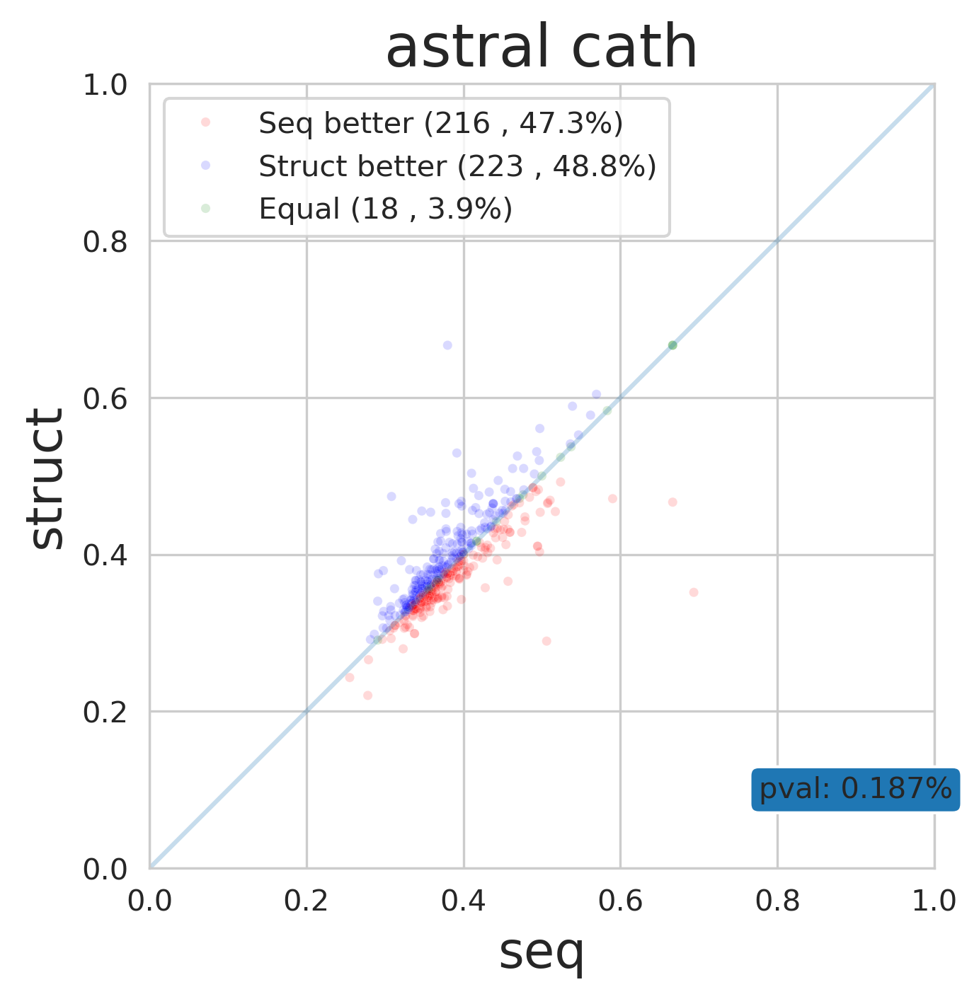

In [109]:
means = [ col for col in astral_resdf.columns if 'mean' in col ]
means = astral_resdf[means]
print(means)

retgraph(s2= 'mean_fident_1_exp_struct_tree.PP.nwk.rooted.treescore_astral_support.json' , 
         s1= 'mean_sequences.aln.muscle.fst.treefile.rooted.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral cath' , cutoff = 0 , min_axlim= 0 , axlim = 1 )


retgraph(s2= 'mean_fident_1_exp_struct_tree.PP.nwk.rooted.treescore_astral_support.json' , 
         s1= 'mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral cath' , cutoff = 0 , min_axlim= 0 , axlim = 1 )


retgraph(s2= 'mean_templateXAA.nx.treefile.rooted.final.treescore_astral_support.json' , 
         s1= 'mean_sequences.aln.muscle.fst.treefile.rooted.treescore_astral_support.json' ,
         filtereddf= astral_resdf , xlabel='seq' , ylabel='struct', title='astral cath' , cutoff = 0 , min_axlim= 0 , axlim = 1 )

In [ ]:
print( len( means.dropna()))